**Written and Directed by:** *Όνομα και ΑΜ*

# **Συστήματα και Τεχνολογίες Γνώσης**
# **Θέμα 1**
Στο θέμα αυτό θα αναπτύξετε έναν γράφο γνώσης τον οποίο στη συνέχεια θα αξιοποιήσετε για ένα σύστημα συστάσεων (recommender system) που θα προτείνει ταινίες σε χρήστες.


## 1ο Μέρος: Εξοικείωση με το προγραμματιστικό περιβάλλον


Σε αυτό το μέρος θα δούμε πως μπορούμε να δημιουργήσουμε και να εμπλουτίσουμε ένα γράφο γνώσης, να συνδέσουμε πολλαπλούς γράφους καθώς και να διατυπώνουμε SPARQL ερωτήματα, μέσα από το προγραμματιστικό περιβάλλον του notebook.

Σας δίνεται ένας πολύ απλός γράφος γνώσης στο αρχείο lotr.nt, ο οποίος αποτελείται από τις παρακάτω τριάδες

```xml
<http://example.org/ns/tt0325980> <http://example.org/props/country> <http://example.org/ns/USA> .
<http://example.org/ns/tt0120737> <http://example.org/props/actor> <http://example.org/ns/Sean_Astin> .
<http://example.org/ns/tt0325980> <http://example.org/props/director> <http://example.org/ns/Gore_Verbinski> .
<http://example.org/ns/tt0120737> <http://example.org/props/actor> <http://example.org/ns/Cate_Blanchett> .
<http://example.org/ns/tt0120737> <http://example.org/props/budget> "$ 93000000"^^<http://www.w3.org/2001/XMLSchema#integer> .
<http://example.org/ns/tt0120737> <http://example.org/props/country> <http://example.org/ns/New_Zealand> .
<http://example.org/ns/tt0120737> <http://example.org/props/country> <http://example.org/ns/USA> .
<http://example.org/ns/tt0120737> <http://example.org/props/actor> <http://example.org/ns/Sala_Baker> .
<http://example.org/ns/tt0325980> <http://example.org/props/actor> <http://example.org/ns/Orlando_Bloom> .
<http://example.org/ns/tt0120737> <http://example.org/props/actor> <http://example.org/ns/Sean_Bean> .
<http://example.org/ns/tt0120737> <http://example.org/props/director> <http://example.org/ns/Peter_Jackson> .
<http://example.org/ns/tt0325980> <http://example.org/props/budget> "$ 140000000"^^<http://www.w3.org/2001/XMLSchema#integer> .
<http://example.org/ns/tt0120737> <http://example.org/props/actor> <http://example.org/ns/Orlando_Bloom> .
<http://example.org/ns/tt0325980> <http://example.org/props/title> "Pirates_of_the_Caribbean:_The_Curse_of_the_Black_Pearl"^^<http://www.w3.org/2001/XMLSchema#string> .
<http://example.org/ns/tt0120737> <http://example.org/props/title> "The_Lord_of_the_Rings:_The_Fellowship_of_the_Ring"^^<http://www.w3.org/2001/XMLSchema#string> .
```
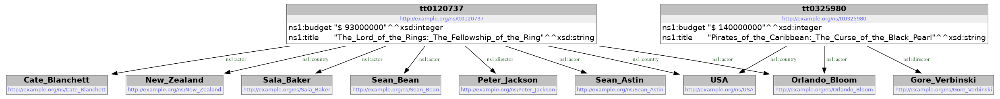




Ο γράφος αυτός περιέχει πληροφορίες για δύο ταινίες, την τοποθεσία που γυρίστηκαν, το σκηνοθέτη τους και κάποιους από τους ηθοποιούς. Χρησιμοποιεί δύο 'τεχνητούς' χώρους ονομάτων: http://example.org/ns/ και http://example.org/props/ όπου στον πρώτο ορίζονται τα ονόματα των οντοτήτων ενώ στο δεύτερο τα ονόματα των ιδιοτήτων τους.

Στην python μπορούμε να φορτώσουμε το γράφο με χρήση της βιβλιοθήκης rdflib.

In [ ]:
!pip install rdflib

In [101]:
from rdflib import Graph, Literal, URIRef, Namespace

## Αρχικοποίηση ενός κενού γράφου
g = Graph()

## Διάβασμα του αρχείου και προσθήκη στο γράφο
g.parse('lotr.nt',format='nt')

## Εκτύπωση όλων των κόμβων
print("All nodes of the graph:")
for node in g.all_nodes():
  print(node)

All nodes of the graph:
http://example.org/ns/Peter_Jackson
http://example.org/ns/Sean_Bean
http://example.org/ns/New_Zealand
http://example.org/ns/Sala_Baker
Pirates_of_the_Caribbean:_The_Curse_of_the_Black_Pearl
The_Lord_of_the_Rings:_The_Fellowship_of_the_Ring
http://example.org/ns/tt0325980
http://example.org/ns/USA
http://example.org/ns/tt0120737
$ 93000000
http://example.org/ns/Sean_Astin
$ 140000000
http://example.org/ns/Orlando_Bloom
http://example.org/ns/Gore_Verbinski
http://example.org/ns/Cate_Blanchett


Στο γράφο αυτό μπορούμε να διατυπώνουμε SPARQL ερωτήματα όπως φαίνεται στο παρακάτω κελί. 

Σε ποιες ταινίες παίζει ο Orlando Bloom?

In [102]:
## Τα prefixes τα ορίζουμε στην αρχή του ερωτήματος για να μην κουβαλάμε τα namespaces μέσα στο ερώτημα
ans=g.query(
    """
      PREFIX exp: <http://example.org/props/>
      PREFIX ex: <http://example.org/ns/>
      
      SELECT DISTINCT ?title
       WHERE {
          ?movie exp:actor ex:Orlando_Bloom .
          ?movie exp:title ?title
       }""")
for a in ans:
  print(a)

(rdflib.term.Literal('The_Lord_of_the_Rings:_The_Fellowship_of_the_Ring', datatype=rdflib.term.URIRef('http://www.w3.org/2001/XMLSchema#string')),)
(rdflib.term.Literal('Pirates_of_the_Caribbean:_The_Curse_of_the_Black_Pearl', datatype=rdflib.term.URIRef('http://www.w3.org/2001/XMLSchema#string')),)


Στο γράφο επίσης μπορούμε να προσθέσουμε τριάδες

π.χ. για να προσθέσουμε το γεγονός πως ο Ian McKellen παίζει στο Lord of the Rings

In [4]:
## Ορίζουμε τους χώρους ονομάτων
ns1 = Namespace('http://example.org/ns/')
ns2 = Namespace('http://example.org/props/')

## URI της ταινίας
a = URIRef(ns1+"tt0120737")

## URI της ιδιότητας "έχει ηθοποιό"
b = URIRef(ns2+"actor")

## URI του Ian McKellen
c = URIRef(ns1+"Ian_McKellen")

## Προσθήκη της τριάδας a,b,c στο γράφο
g.add((a,b,c))

## Εκτύπωση όλων των κόμβων
print("All nodes of the graph:")
for node in g.all_nodes():
  print(node)

All nodes of the graph:
The_Lord_of_the_Rings:_The_Fellowship_of_the_Ring
http://example.org/ns/Ian_McKellen
http://example.org/ns/tt0120737
http://example.org/ns/Cate_Blanchett
http://example.org/ns/Sean_Bean
http://example.org/ns/Sean_Astin
Pirates_of_the_Caribbean:_The_Curse_of_the_Black_Pearl
http://example.org/ns/New_Zealand
http://example.org/ns/Sala_Baker
http://example.org/ns/Orlando_Bloom
http://example.org/ns/Gore_Verbinski
http://example.org/ns/USA
$ 93000000
http://example.org/ns/Peter_Jackson
http://example.org/ns/tt0325980
$ 140000000


Παρατηρήστε πως ο κόμβος που αναφέρεται στην οντότητα της ταινίας έχει URI <<http://example.org/ns/tt0120737>> και όχι <<http://example.org/ns/The_Lord_of_the_Rings:_The_Fellowship_of_the_Ring>>. Ο τίτλος μιας ταινίας είναι ένα string (literal) το οποίο συνδέεται με τον αντίστοιχο κόμβο μέσω της ακμής <<http://example.org/props/title>>. Αν χρειαζόταν να βρούμε το όνομα του συγκεκριμένου κόμβου θα μπορούσαμε να το κάνουμε μέσω SPARQL

In [5]:
ans=g.query(
    """
      PREFIX exp: <http://example.org/props/>
      PREFIX ex: <http://example.org/ns/>
      
      SELECT DISTINCT ?movie
       WHERE {
          ?movie exp:title "The_Lord_of_the_Rings:_The_Fellowship_of_the_Ring"^^xsd:string .
       }""")
for a in ans:
  print(a)

(rdflib.term.URIRef('http://example.org/ns/tt0120737'),)


όπου το ^^xsd:string υποδηλώνει πως αναφερόμαστε σε literal τύπου string

### Ερώτημα 1.1

Δημιουργήστε έναν νέο γράφο γνώσης (g2) από πληροφορίες που θα βρείτε ψάχνοντας στο διαδίκτυο, όμοιο με αυτόν που σας δίνεται, στον οποίο:
- Θα χρησιμοποιούνται τα ίδια namespaces με τον γράφο που δίνεται
- Θα περιέχονται 10 με 20 τριάδες
- Θα περιέχονται τουλάχιστον δύο ταινίες διαφορετικές από αυτές που περιέχονται στο γράφο που δίνεται
- Τουλάχιστον ένας κόμβος του γράφου θα έχει ίδιο URI με έναν κόμβο του γράφου που δίνεται, δηλαδή θα αναφέρεται στο ίδιο αντικείμενο του κόσμου (πχ ένας ηθοποιός ή ένας σκηνοθέτης) 

Στη συνέχεια θα διατυπώσετε δύο SPARQL ερωτήματα της επιλογής σας στο γράφο αυτόν, και θα εκτυπώσετε τις απαντήσεις. Περιγράψτε τι κάνει το κάθε ένα από αυτά τα ερωτήματα.

Μπορείτε να δημιουργήσετε το γράφο είτε μέσω του κώδικα όπως δείξαμε και παραπάνω, είτε δημιουργώντας τοπικά ένα αρχείο 'ntriples' (.nt), γράφοντας "με το χέρι" τις τριάδες με τη μορφή που είναι και στο lotr.nt,  και μετά φορτώνοντας το αρχείο στο notebook, όπως παρουσιάσαμε και για το δοθέν αρχείο (Graph.parse()). Σε περίπτωση που δημιουργήσετε το νέο γράφο μέσω κώδικα, μην ξεχάσετε να αποθηκεύσετε το γράφο σε ένα αρχείο με κωδικοποίηση 'ntriples' τρέχοντας την εντολή
```python
g2.serialize(destination='mygraph.nt', format='nt')
```
Εκτυπώστε όλες τις τριάδες του γράφου.

In [6]:
## Solution 1.1
from rdflib import Graph, Literal, URIRef, Namespace

g2 = Graph()
g2.parse('ntriples.nt',format='nt')

print("All nodes of the second graph:")
for node in g2.all_nodes():
  print(node)

All nodes of the second graph:
http://example.org/ns/Nicole_Kidman
http://example.org/ns/Stanley_Kubrick
http://example.org/ns/Brad_Pitt
http://example.org/ns/tt0120663
http://example.org/ns/Cate_Blanchett
$ 150000000 
$ 65000000 
Eyes_Wide_Shut
The_Curious_Case_of_Benjamin_Button
The_Ring
http://example.org/ns/David_Fincher
http://example.org/ns/Gore_Verbinski
http://example.org/ns/USA
http://example.org/ns/tt0298130
http://example.org/ns/Brian_Cox
$ 48000000 
http://example.org/ns/Naomi_Watts
http://example.org/ns/tt0421715


Επιστρέφει τις ταινίες που έχουν ως χώρα τις ΗΠΑ, μαζί με τους σκηνοθέτες τους:

In [7]:
ans1=g2.query(
    """
      PREFIX exp: <http://example.org/props/>
      PREFIX ex: <http://example.org/ns/>
      
      SELECT ?title ?director
       WHERE {
          ?movie exp:title ?title .
          ?movie exp:country ex:USA .
          ?movie exp:director ?director
       }""")
for a in ans1:
  print(a)

(rdflib.term.Literal('Eyes_Wide_Shut', datatype=rdflib.term.URIRef('http://www.w3.org/2001/XMLSchema#string')), rdflib.term.URIRef('http://example.org/ns/Stanley_Kubrick'))
(rdflib.term.Literal('The_Ring', datatype=rdflib.term.URIRef('http://www.w3.org/2001/XMLSchema#string')), rdflib.term.URIRef('http://example.org/ns/Gore_Verbinski'))
(rdflib.term.Literal('The_Curious_Case_of_Benjamin_Button', datatype=rdflib.term.URIRef('http://www.w3.org/2001/XMLSchema#string')), rdflib.term.URIRef('http://example.org/ns/David_Fincher'))


Επιστρέφει τις ταινίες στις οποίες δεν παίζει η Cate Blanchett

In [8]:
ans2=g2.query(
    """
      PREFIX exp: <http://example.org/props/>
      PREFIX ex: <http://example.org/ns/>
      
      SELECT ?title
       WHERE {
          ?movie exp:title ?title .
          FILTER NOT EXISTS {?movie exp:actor ex:Cate_Blanchett}
       }""")
for a in ans2:
  print(a)

(rdflib.term.Literal('The_Ring', datatype=rdflib.term.URIRef('http://www.w3.org/2001/XMLSchema#string')),)


### Ερώτημα 1.2

Σε έναν νέο γράφο θα φορτώσετε και τα δύο αρχεία (mygraph.nt, lotr.nt) και θα διατυπώσετε ένα SPARQL ερώτημα στην απάντηση του οποίου να φαίνεται πως οι δύο γράφοι είναι συνδεδεμένοι.

Για να φορτώσετε δύο αρχεία στον ίδιο γράφο τρέχετε τις εντολές
```
g = Graph()
g.parse('lotr.nt',format='nt')
g.parse('mygraph.nt',format='nt')
```

In [9]:
## Solution 1.2

g = Graph()
g.parse('lotr.nt',format='nt')
g.parse('ntriples.nt',format='nt')

#Επιστρέφει τις ταινίες που έχει σκηνοθετήσει ο Gore Verbinski, μία 
#από τον γράφο που δημιουργήσαμε και μία από τον γράφο που μας δώθηκε
ans=g.query(
    """
      PREFIX exp: <http://example.org/props/>
      PREFIX ex: <http://example.org/ns/>
      
      SELECT ?title
       WHERE {
          ?movie exp:director ex:Gore_Verbinski .
          ?movie exp:title ?title
       }""")
for a in ans:
  print(a)

(rdflib.term.Literal('Pirates_of_the_Caribbean:_The_Curse_of_the_Black_Pearl', datatype=rdflib.term.URIRef('http://www.w3.org/2001/XMLSchema#string')),)
(rdflib.term.Literal('The_Ring', datatype=rdflib.term.URIRef('http://www.w3.org/2001/XMLSchema#string')),)


In [10]:
#Επιστρέφει τις ταινίες στις οποίες έχει παίξει η Cate Blanchett
ans=g.query(
    """
      PREFIX exp: <http://example.org/props/>
      PREFIX ex: <http://example.org/ns/>
      
      SELECT ?title
       WHERE {
          ?movie exp:actor ex:Cate_Blanchett .
          ?movie exp:title ?title 
       }""")
for a in ans:
  print(a)

(rdflib.term.Literal('Eyes_Wide_Shut', datatype=rdflib.term.URIRef('http://www.w3.org/2001/XMLSchema#string')),)
(rdflib.term.Literal('The_Curious_Case_of_Benjamin_Button', datatype=rdflib.term.URIRef('http://www.w3.org/2001/XMLSchema#string')),)
(rdflib.term.Literal('The_Lord_of_the_Rings:_The_Fellowship_of_the_Ring', datatype=rdflib.term.URIRef('http://www.w3.org/2001/XMLSchema#string')),)


## 2o Μέρος: Ανάπτυξη γράφου γνώσης



Σε αυτό το μέρος θα αναπτύξετε το γράφο γνώσης που θα χρησιμοποιηθεί για το σύστημα συστάσεων, αξιοποιώντας ετερογενή δεδομένα από διαφορετικές πηγές. Συγκεκριμένα θα συλλέξετε δεδομένα από:
- Το αρχείο movies.csv που σας δίνεται, το οποίο είναι υποσύνολο του kaggle dataset που βρίσκεται [εδώ](https://www.kaggle.com/stefanoleone992/imdb-extensive-dataset)
- Το γράφο γνώσης [Wikidata](https://www.wikidata.org/wiki/Wikidata:Main_Page)

Για την εξαγωγή πληροφορίας από το csv αρχείο μπορείτε να χρησιμοποιήσετε τη βιβλιοθήκη [pandas](https://pandas.pydata.org/docs/user_guide/index.html#user-guide).

In [11]:
import pandas as pd
df = pd.read_csv('movies.csv')
print(df.head())

   Unnamed: 0 imdb_title_id                   title          original_title  \
0           0     tt0015758      Don Q Son of Zorro      Don Q Son of Zorro   
1           1     tt0017136              Metropolis              Metropolis   
2           2     tt0021884            Frankenstein            Frankenstein   
3           3     tt0022700  Blondie of the Follies  Blondie of the Follies   
4           4     tt0023326        Payment Deferred        Payment Deferred   

   year date_published                   genre  duration  country  \
0  1925     1925-06-15      Adventure, Romance       111      USA   
1  1927     1928-10-01           Drama, Sci-Fi       153  Germany   
2  1931     1935-12-02  Drama, Horror, Romance        70      USA   
3  1932     1932-09-01         Comedy, Musical        91      USA   
4  1932     1932-11-07            Crime, Drama        81      USA   

         language  ...                                             actors  \
0         English  ...  Mary Asto

Με την παραπάνω εντολή φορτώσαμε το περιεχόμενο του αρχείου σε ένα *dataframe* το οποίο είναι ουσιαστικά ένας πίνακας. Κάθε στήλη του πίνακα είναι ένα pandas Series - ουσιαστικά μια λίστα. Για να πάρουμε το i-οστό στοιχείο μιας στήλης μπορούμε να γράψουμε (πχ. για τη στήλη 'director'):
```python
director = df['director'][i]
```
Για να πάρουμε πχ. όλα τα ζεύγη ταινιών και σκηνοθετών θα γράφαμε:
```python
for i in range(df.shape[0]):
  movie = df['original_title'][i]
  director = df['director'][i]
```
Τέλος μπορούμε να φιλτράρουμε ένα dataframe και να κρατήσουμε όσες γραμμές του πίνακα ικανοποιούν κάποια συνθήκη. πχ για να πάρουμε όλες τις γραμμές που αναφέρονται σε ταινίες που περιέχουν τον Ian McKellen στους ηθοποιούς:

```python
df_ian = df[df['actors'].str.contains('Ian McKellen')]
```

Γενικά τα pandas είναι μια πολύ δυνατή βιβλιοθήκη με πάρα πολλές λειτουργίες, και θα βρείτε πολύ υλικό στο διαδίκτυο (documentation, tutorials, παραδείγματα) εάν θέλετε να το ψάξετε παραπάνω.

### Ερώτημα 2.1

Κατασκευάστε έναν γράφο γνώσης για όλες τις ταινίες και με όλες τις πληροφορίες που υπάρχουν στο αρχείο movies.csv που σας δίνεται.

*Προσοχή 1: Σε κάποια πεδία του csv δεν υπάρχουν καταχωρήσεις (πχ λείπουν κάποιοι σκηνοθέτες). Θα πρέπει να γίνεται έλεγχος και να το χειριστείτε κατάλληλα.*   
*Προσοχή 2: Τα κενά και ορισμένοι ειδικοί χαρακτήρες ενδέχεται να δημιουργήσουν προβλήματα στην αναπαράσταση του γράφου μέσω των βιβλιοθηκών της python, για αυτό το λόγο όπως θα δείτε και παρακάτω αντικαθιστούμε τα κενά με κάτω\_παύλα ('\_'). Συνίσταται να χρησιμοποιείτε μόνο αλφαριθμητικούς χαρακτήρες και την κάτω_παύλα για ονόματα οντοτήτων και ιδιοτήτων.*   
*Προσοχή 3: Κάποια πεδιά του csv έχουν πολλαπλές καταχωρήσεις (π.χ. ηθοποιοί) χωρισμένες με κόμμα.*

In [104]:
# Solution 2.1
## Read csvs and create rdf
import pandas as pd
from rdflib import Graph, Literal, URIRef, Namespace,XSD


movies = pd.read_csv('movies.csv')

ns1 = Namespace('http://example.org/ns/')
ns2 = Namespace('http://example.org/props/')

g = Graph()

#import genre,country,language,actors,writer,title,original title,duration,year,reviews
for i in range(movies.shape[0]):
  mov_id = movies['imdb_title_id'][i]
  genres = movies['genre'][i].split(',')
  genres = [g.replace(' ','_') for g in genres]
  countries = movies['country'][i].split(',')
  countries = [g.replace(' ','_') for g in countries]
  languages = movies['language'][i].split(',')
  languages = [g.replace(' ','_') for g in languages]
  actors = movies['actors'][i].split(',')
  actors = [g.replace(' ','_') for g in actors]
  writers = movies['writer'][i].split(',')
  writers = [g.replace(' ','_') for g in writers]
  titles = movies['title'][i].split(',')
  titles = [g.replace(' ','_') for g in titles]
  original_titles = movies['original_title'][i].split(',')
  original_titles = [g.replace(' ','_') for g in original_titles]
  durations = movies['duration'][i] 
  years = movies['year'][i] 
  votes = movies['votes'][i]
  avg_votes = movies['avg_vote'][i]
  reviews_from_users = movies['reviews_from_users'][i]
  reviews_from_critics = movies['reviews_from_critics'][i]
  date_published = movies['date_published'][i]
  if (type(movies['director'][i]) != float):  #that means we dont have an empty row
    directors = movies['director'][i].split(',')
    directors = [g.replace(' ','_') for g in directors]
  if (type(movies['production_company'][i]) != float):  #that means we dont have an empty row
    production_company = movies['production_company'][i].split(',')
    production_company = [g.replace(' ','_') for g in production_company]

    
  a = URIRef(ns1+mov_id)
#   b = URIRef(ns2+'genre')
#   for d in genres:
#     c = URIRef(ns1+d)
#     g.add((a,b,c))
#   b = URIRef(ns2+'country')
#   for d in countries:
#     c = URIRef(ns1+d)
#     g.add((a,b,c))
#   b = URIRef(ns2+'language')
#   for d in languages:
#     c = URIRef(ns1+d)
#     g.add((a,b,c))
#   b = URIRef(ns2+'actors')
#   for d in actors:
#     c = URIRef(ns1+d)
#     g.add((a,b,c))
#   b = URIRef(ns2+'writer')
#   for d in actors:
#     c = URIRef(ns1+d)
#     g.add((a,b,c))
#   b = URIRef(ns2+'title')
#   for d in titles:
#     c = URIRef(ns1+d)
#     g.add((a,b,c))
#   b = URIRef(ns2+'original_title')
#   for d in original_titles:
#     c = URIRef(ns1+d)
#     g.add((a,b,c))
#   b = URIRef(ns2+'duration')
#   c = URIRef(ns1+str(durations))
#   g.add((a,b,c))
#   b = URIRef(ns2+'year')
#   c = URIRef(ns1+str(years))
#   g.add((a,b,c))
#   b = URIRef(ns2+'avg_vote')
#   c = URIRef(ns1+str(avg_votes))
#   g.add((a,b,c))
#   b = URIRef(ns2+'reviews_from_users')
#   c = URIRef(ns1+str(reviews_from_users))
#   g.add((a,b,c))
#   b = URIRef(ns2+'reviews_from_critics')
#   c = URIRef(ns1+str(reviews_from_critics))
#   g.add((a,b,c))
#   b = URIRef(ns2+'date_published')
#   c = URIRef(ns1+str(date_published))
#   g.add((a,b,c))
  b = URIRef(ns2+'director')
  if (type(movies['director'][i]) != float):
      for d in directors:
         c = URIRef(ns1+d)
         g.add((a,b,c))
#   b = URIRef(ns2+'production_company')
#   if (type(movies['production_company'][i]) != float):
#       for d in production_company:
#          c = URIRef(ns1+d)
#          g.add((a,b,c))
 
# for i in range(movies.shape[0]):
#     mov_id = movies['imdb_title_id'][i]
#     if (type(movies['budget'][i]) != float):
#         budget = movies['budget'][i].split(',')
#         budget = [g.replace(' ','_') for g in budget]
#     if (type(movies['usa_gross_income'][i]) != float):
#         usa_gross_income = movies['usa_gross_income'][i].split(',')
#         usa_gross_income = [g.replace(' ','_') for g in usa_gross_income]  
#     if (type(movies['worlwide_gross_income'][i]) != float):
#         worlwide_gross_income = movies['worlwide_gross_income'][i].split(',')
#         worlwide_gross_income = [g.replace(' ','_') for g in worlwide_gross_income]
#     metascore = movies['metascore'][i] 
#     if (type(movies['description'][i]) != float):  #that means we dont have an empty row
#      description = movies['description'][i].split('\n')
#      description = [g.replace(' ','_') for g in description]
#      description = [g.replace('"','-') for g in description] #here we replace "" with - - 
    
#     a = URIRef(ns1+mov_id)
#     b = URIRef(ns2+'budget')
#     if (type(movies['budget'][i]) != float):
#         for d in budget:
#           c = URIRef(ns1+d)
#           g.add((a,b,c))
#     b = URIRef(ns2+'usa_gross_income')
#     if (type(movies['usa_gross_income'][i]) != float):
#         for d in usa_gross_income:
#           c = URIRef(ns1+d)
#           g.add((a,b,c))
#     b = URIRef(ns2+'worlwide_gross_income')
#     if (type(movies['worlwide_gross_income'][i]) != float):
#         for d in worlwide_gross_income:
#           c = URIRef(ns1+d)
#           g.add((a,b,c))
#     b = URIRef(ns2+'metascore')
#     c = URIRef(ns1+str(metascore))
#     g.add((a,b,c)) 
#     b = URIRef(ns2+'description')
#     if (type(movies['description'][i]) != float):
#       for d in description:
#          c = URIRef(ns1+d)
#          g.add((a,b,c))
    
    
print("All nodes of the graph:")
for node in g.all_nodes():
  print(node)

print(len(g.all_nodes()))


All nodes of the graph:
http://example.org/ns/tt0211941
http://example.org/ns/tt0109000
http://example.org/ns/Lodge_Kerrigan
http://example.org/ns/Jim_Sheridan
http://example.org/ns/tt0073335
http://example.org/ns/tt0077318
http://example.org/ns/Ingmar_Bergman
http://example.org/ns/_Jean-Pierre_Jeunet
http://example.org/ns/tt0890888
http://example.org/ns/Nathan_Scoggins
http://example.org/ns/John_Flynn
http://example.org/ns/tt0395169
http://example.org/ns/tt0332379
http://example.org/ns/Ernst_Lubitsch
http://example.org/ns/Chang-dong_Lee
http://example.org/ns/_Barbara_Albert
http://example.org/ns/Dana_Adam_Shapiro
http://example.org/ns/Gregory_Nava
http://example.org/ns/tt0340855
http://example.org/ns/Laurence_Malkin
http://example.org/ns/Nic_Balthazar
http://example.org/ns/tt0080745
http://example.org/ns/tt0097240
http://example.org/ns/Sanjay_Leela_Bhansali
http://example.org/ns/Ermek_Tursunov
http://example.org/ns/tt0892332
http://example.org/ns/David_Fincher
http://example.org/ns/tt

### Ερώτημα 2.2


Για την ανάκτηση πληροφορίας από το γράφο των Wikidata θα κάνετε SPARQL queries στο SPARQL endpoint που διαθέτουν. Συγκεκριμένα μέσω της βιβλιοθήκης requests της python, θα στέλνετε ένα http GET request με δύο παραμέτρους:  

*   '*format*' που καθορίζει σε τί μορφή θα έρθει η απάντηση (json), και
*   '*query*' που περιέχει το SPARQL ερώτημα που θέλουμε να απαντηθεί.

Για παράδειγμα το παρακάτω κομμάτι κώδικα δημιουργεί το κατάλληλο SPARQL query και "χτυπάει" το Wikidata SPARQL endpoint για να πάρουμε όλους τους κόμβους του γράφου που έχουν σε κάποιο από τα αγγλικά (@en) labels τους (skos:altLabel|skos:prefLabel|rdfs:label) τη συμβολοσειρά "Song Kang-ho". 

Προσοχή! τα labels είναι case sensitive και απαιτούν να προσδιορίζεται και η γλώσσα του label, π.χ. εδω Αγγλικά (@en)! 

In [13]:
import requests

endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT ?uri 
          WHERE {
            ?uri skos:altLabel|skos:prefLabel|rdfs:label \"Song Kang-ho\"@en .
            }"""
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

Ύστερα, για να πάρουμε τις απαντήσεις διαβάζουμε το json που επεστράφη:

In [14]:
data = r.json()
print(len(data["results"]["bindings"]))
for entity in data["results"]["bindings"]:
  print(entity["uri"]["value"])


1
http://www.wikidata.org/entity/Q484400


Μπορείτε να κάνετε δοκιμές για τα SPARQL queries προς Wikidata στο [Wikidata Query Service](https://query.wikidata.org/). 

**Χρήσιμοι σύνδεσμοι:**

[Wikidata:SPARQL query service](https://www.wikidata.org/wiki/Wikidata:SPARQL_query_service) και όλοι οι σύνδεσμοι που βρίσκονται στο κομμάτι "Learning SPARQL", με κυριότερους τους:

[SPARQL Tutorial](https://www.wikidata.org/wiki/Wikidata:SPARQL_tutorial)

[SPARQL query service/queries](https://www.wikidata.org/wiki/Wikidata:SPARQL_query_service/queries) 

[SPARQL query service/queries/examples](https://www.wikidata.org/wiki/Wikidata:SPARQL_query_service/queries/examples).

Όμοια τώρα με τη συμβολοσειρά "David Lynch".

In [15]:
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT ?uri 
          WHERE {
            ?uri skos:altLabel|skos:prefLabel|rdfs:label \"David Lynch\"@en .
            }"""
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [16]:
data = r.json()
print(len(data["results"]["bindings"]))
for entity in data["results"]["bindings"]:
  print(entity["uri"]["value"])


11
http://www.wikidata.org/entity/Q6622077
http://www.wikidata.org/entity/Q86167267
http://www.wikidata.org/entity/Q2071
http://www.wikidata.org/entity/Q1175355
http://www.wikidata.org/entity/Q5236849
http://www.wikidata.org/entity/Q5236852
http://www.wikidata.org/entity/Q17102597
http://www.wikidata.org/entity/Q20863434
http://www.wikidata.org/entity/Q60618339
http://www.wikidata.org/entity/Q89896294
http://www.wikidata.org/entity/Q102887323


**2.2.1 Ποιά βασική διαφορά παρατηρείτε ως προς το σύνολο απαντήσεων για την περίπτωση της συμβολοσειράς Song Kang-ho και David Lynch αντίστοιχα;**

Απάντηση 2.2.1:

Παρατηρούμε ότι το query που μας έχει δωθεί, επιστρέφει όλους τους κόμβους του γράφου που περιέχουν στο label τους την συγκεκριμένη συμβολοσειρά. Αυτό σημαίνει πως αρχικά σε περίπτωση συνωνυμιας προσώπων θα βγουν πολλά αποτελέσματα και όχι μόνο αυτό το οποίο ψάχνουμε. Κάτι τέτοιο δεν αποτέλεσε πρόβλημα στο πρώτο query μιας και υπήρχε ένα μόνο άτομο με το όνομα Song Kang-ho καταγεγραμμένο στο wikidata ενώ για το όνομα David Lynch επιστράφηκαν 11 άτομα. Επίσης, καθώς επιστρέφει τις συμβολοσειρές που *περιέχουν* την συγκεκριμένη συμβολοσειρά, επιστρέφει επίσης πρόσωπα τα οποία περιέχουν στο όνομα τους αυτή την συμβολοσειρά αλλά δεν είναι ακριβώς αυτό το όνομα τους (πχ επέστρεψε τον David **S** Lynch). Τέλος, αυτό το query δεν ξεχωρίζει και τυχόν διπλότυπα που υπάρχουν στην βάση δεδομένων.

**2.2.2 Εάν ψάχναμε (μόνο) την οντότητα του ηθοποιού Song Kang-ho το παραπάνω query σύμφωνα με το label είναι αρκετό; για την περίπτωση του σκηνοθέτη David lynch;**
 

Απάντηση 2.2.2:

Όπως αναφέραμε και πριν, επειδή μόνο ο ηθοποιός Song Kang-ho είναι αποθηκευμένος με αυτό το όνομα στο Wikidata τότε το παραπάνω query είναι αρκετό. Αντίθετα, στην περίπτωση του David Lynch το query επιστρέφει σκηνοθέτη,ερευνητή,ακροδεξιό εξτρεμιστή,δημοσιογράφο,τραγουδιστή και αξιωματικό του στρατού, που όλοι έχουν το ίδιο όνομα επομένως δεν μπορούμε να απομονώσουμε μόνο την οντότητα του σκηνοθέτη.

**2.2.3 Από τη σελίδα των wikidata για το σκηνοθέτη David Lynch μπορείτε να εντοπίσετε κάποια χαρακτηριστικά (αναφέρονται ως Statements στη σελίδα των Wikidata) που τον διαφοροποιούν από τις υπόλοιπες οντότητες που μας επέστρεψε το παραπάνω query; (π.χ. το "*instance of: human*" *ΔΕΝ* διαφοροποιεί TON David Lynch από όλες τις υπόλοιπες οντότητες με ίδιο label) δώστε τουλάχιστον δύο (2) παραδείγματα.** 


Απάντηση 2.2.3:

Διακριτά χαρακτηριστικά είναι η ημερομηνία γέννησης του (date of birth) μιας και υπάρχει πολύ μικρή πιθανότητα δύο άτομα με συνωνυμία να έχουν ακριβώς την ίδια ημερομηνία γέννησης και τα αδέρφια (siblings) καθώς δεν αναφέρεται μόνο πόσα είναι συνολικά αλλά τα ονοματεπώνυμα τους. Τέλος, το πιο σημαντικό χαρακτηριστικό είναι το επάγγελμα (ocuppation) το οποίο διακρίνει αμέσως αν βρήκαμε το σωστό άτομο.

**Σύνθετα Queries**\
Για να κάνουμε πιο σύνθετα ερωτήματα πρέπει να ξέρουμε τα αναγνωριστικά των ιδιοτήτων και των κόμβων όπως είναι ορισμένα στα Wikidata. Αυτά μπορούμε να τα ανακτήσουμε είτε με SPARQL ερωτήματα όπως το παραπάνω, ή ψάχνοντας "χεράτα" στα Wikidata. Για παράδειγμα η ιδιότητα "είναι" (instance of) περιγράφεται [εδώ](https://www.wikidata.org/wiki/Property:P31) και έχει αναγνωριστικό ([wikidata identifier](https://www.wikidata.org/wiki/Wikidata:Identifiers)) P31. Η έννοια "ταινία" (film) περιγράφεται [εδώ](https://www.wikidata.org/wiki/Q11424) και έχει αναγνωριστικό Q11424.  
Έτσι εάν ψάχνουμε την οντότητα της ταινίας "The Usual Suspects" εάν κάνουμε αναζήτηση μόνο με το label θα δούμε πως επιστρέφονται μαζί κι άλλες οντότητες οι οποίες δεν μας ενδιαφέρουν αυτή τη στιγμή. Για αυτό δημιουργούμε ένα πιο σύνθετο query στο οποίο υπάρχει η απαίτηση οι οντότητες που θα επιστραφούν να "είναι" (instance of) ταινίες. 

*Προσοχή στα prefixes! Χρησιμοποιούμε wd για τις οντότητες και wdt για τις ιδιότητες (see "Our first query" [here](https://www.wikidata.org/wiki/Wikidata:SPARQL_tutorial)), αυτά είναι τα μόνα που θα μας χρειαστούν στο πλαίσιο της παρούσας άσκησης.*




In [17]:
# Simple query by label (only)

endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT ?uri 
          WHERE {
            ?uri skos:altLabel|skos:prefLabel|rdfs:label \"The Usual Suspects\"@en .
            }"""
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [18]:
data = r.json()
print(len(data["results"]["bindings"]))
for entity in data["results"]["bindings"]:
  print(entity["uri"]["value"])


4
http://www.wikidata.org/entity/Q132351
http://www.wikidata.org/entity/Q478055
http://www.wikidata.org/entity/Q2491896
http://www.wikidata.org/entity/Q7771847


In [19]:
# More "complex" query by label and "instance of"

endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT ?uri 
          WHERE {
            ?uri skos:altLabel|skos:prefLabel|rdfs:label \"The Usual Suspects\"@en .
            ?uri wdt:P31 wd:Q11424.
            }"""
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [20]:
data = r.json()
print(len(data["results"]["bindings"]))
for entity in data["results"]["bindings"]:
  print(entity["uri"]["value"])

1
http://www.wikidata.org/entity/Q132351


Bonus: ποιός είναι ο δολοφόνος;  
Hint: If you don't know the answer DON'T Google it, just watch the movie! 

Σε συνέχεια των παραπάνω ερωτήσεων (2.2.1 - 2.2.3):  

**2.2.4. Προσπαθήστε να δημιουργήσετε ένα SPARQL query με βάση τις παρατηρήσεις σας στο 2.2.3 που να επιστρέφει μόνο την οντότητα του σκηνοθέτη David Lynch.**\
Σε μια σελίδα wikidata μπορείτε να δείτε το αναγνωριστικό μιας εννοιας (wikidata identifier) αφήνοντας (hovering) τον κέρσορα πάνω από το όνομά της όπως εμφανίζεται στα Statements, καθώς και να πλοηγηθείτε στην αντίστοιχη σελίδα πατώντας πάνω στο όνομα-σύνδεσμο.

In [21]:
# Απάντηση 2.2.4
# Χρησιμοποιήσαμε το χαρακτηριστικό occupation το οποίο είναι το πιο άμεσο
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT ?uri 
          WHERE {
            ?uri skos:altLabel|skos:prefLabel|rdfs:label \"David Lynch\"@en .
            ?uri wdt:P106 wd:Q2526255.
            }"""
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [22]:
data = r.json()
print(len(data["results"]["bindings"]))
for entity in data["results"]["bindings"]:
  print(entity["uri"]["value"])

1
http://www.wikidata.org/entity/Q2071


**2.2.5. Μπορείτε να τροποποιήσετε το αρχικό query που χρησιμοποιεί μόνο τα labels ώστε να επιστρέφεται μόνο η επιθυμητή οντότητα όπως στο 2.2.4;**

<!-- Hint for 2.2.5: "Also known as..." -> altLabel -->

Παρατηρούμε ότι στα labels υπάρχει και το altLabel το οποίο χρησιμοποιείται για την στήλη "*Also known as*" στο Wikidata. Γι'αυτό τον λόγο ορίσαμε στο query να βρίσκει το όνομα David Keith Lynch που αντιστοιχεί στην στήλη also known as του wikidata

In [23]:
# Απάντηση 2.2.5
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT ?uri 
          WHERE {
            ?uri skos:altLabel|skos:prefLabel|rdfs:label \"David Keith Lynch\"@en .
            }"""
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [24]:
data = r.json()
print(len(data["results"]["bindings"]))
for entity in data["results"]["bindings"]:
  print(entity["uri"]["value"])

1
http://www.wikidata.org/entity/Q2071


#### 2.2.6 Βρείτε την έννοια του σκηνοθέτη Peter Jackson στο γράφο των wikidata "χεράτα" (μέσω απλης αναζήτησης στο διαδίκτυο) και δώστε το link για την αντίστοιχη σελίδα στα wikidata.  

Απάντηση 2.2.6:

https://www.wikidata.org/wiki/Q4465

**Hint:** 

https://lmgtfy.app/?q=peter+jackson+director+wikidata

#### 2.2.7 Δημιουργήστε ένα ερώτημα SPARQL για να πάρετε την ίδια έννοια (του σκηνοθέτη Peter Jackson) μέσω του ονόματός του (label). 


In [25]:
# Απάντηση 2.2.7
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT ?uri 
          WHERE {
            ?uri skos:altLabel|skos:prefLabel|rdfs:label \"Peter Jackson\"@en .
            }"""
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [26]:
data = r.json()
print(len(data["results"]["bindings"]))
for entity in data["results"]["bindings"]:
  print(entity["uri"]["value"])

33
http://www.wikidata.org/entity/Q4465
http://www.wikidata.org/entity/Q673587
http://www.wikidata.org/entity/Q711997
http://www.wikidata.org/entity/Q3376667
http://www.wikidata.org/entity/Q3376668
http://www.wikidata.org/entity/Q4160117
http://www.wikidata.org/entity/Q7174912
http://www.wikidata.org/entity/Q7174913
http://www.wikidata.org/entity/Q7174914
http://www.wikidata.org/entity/Q7174915
http://www.wikidata.org/entity/Q7174916
http://www.wikidata.org/entity/Q7174917
http://www.wikidata.org/entity/Q7174918
http://www.wikidata.org/entity/Q7174919
http://www.wikidata.org/entity/Q7174920
http://www.wikidata.org/entity/Q7174921
http://www.wikidata.org/entity/Q7174922
http://www.wikidata.org/entity/Q7174923
http://www.wikidata.org/entity/Q21597880
http://www.wikidata.org/entity/Q25521960
http://www.wikidata.org/entity/Q39073400
http://www.wikidata.org/entity/Q52743056
http://www.wikidata.org/entity/Q54556363
http://www.wikidata.org/entity/Q62273252
http://www.wikidata.org/entity/Q7598

#### 2.2.8 Το ερώτημα που σχηματήσατε επιστρέφει την επιθυμητή οντότητα;  
#### Επιστρέφει μόνο την επιθυμητή οντότητα;  


Απάντηση 2.2.8:\
Παρατηρούμε ότι επιστρέφει και άλλες οντότητες πέραν της επιθυμητής λόγω συνωνυμίας.

#### 2.2.9 Εάν όχι με ποιούς τρόπους θα μπορούσατε να πάρετε μόνο την επιθυμητή οντότητα; διαμορφώστε το κατάλληλο SPARQL query κι επιβεβαιώστε.  
Εάν στο προηγούμενο ερώτημα επιστρέφεται μόνο η επιθυμητή οντότητα τότε μπορείτε να παραλείψετε αυτό το ερώτημα.  


Απάντηση 2.2.9:\
Χρησιμοποιήσαμε την ιδιότητα occupation ώστε να μας επιστρέψει μόνο τον Peter Jackson σκηνοθέτη

In [27]:
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT ?uri 
          WHERE {
            ?uri skos:altLabel|skos:prefLabel|rdfs:label \"Peter Jackson\"@en .
            ?uri wdt:P106 wd:Q2526255.
            }"""
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [28]:
data = r.json()
print(len(data["results"]["bindings"]))
for entity in data["results"]["bindings"]:
  print(entity["uri"]["value"])

1
http://www.wikidata.org/entity/Q4465


#### 2.2.10 Υπάρχει τρόπος να πάρετε μόνο την επιθυμητή οντότητα αποκλειστικά μέσω των labels (όπως στα παραπάνω παραδείγματα με τους Lynch και Song Kang-ho); Εάν ναι, δημιουργήστε το κατάλληλο query.  


Απάντηση 2.2.10:\
Τώρα χρησιμοποιήσαμε πάλι το altLabel ώστε να βρούμε μόνο την επιθυμητή οντότητα μέσω της εναλλακτικής ονομασίας (also known as) του σκηνοθέτη Peter Jackson

In [29]:
# Απάντηση 2.2.10
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT ?uri 
          WHERE {
            ?uri skos:altLabel|skos:prefLabel|rdfs:label \"Sir Peter Jackson\"@en .
            }"""
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [30]:
data = r.json()
print(len(data["results"]["bindings"]))
for entity in data["results"]["bindings"]:
  print(entity["uri"]["value"])

1
http://www.wikidata.org/entity/Q4465


Η ιδιότητα "εργάζεται" (occupation) περιγράφεται [εδώ](https://www.wikidata.org/wiki/Property:P106) και έχει αναγνωριστικό P106. Το επάγγελμα του σκηνοθέτη περιγράφεται [εδώ](https://www.wikidata.org/wiki/Q2526255) και έχει αναγνωριστικό Q2526255. Η ιδιότητα "χώρα πολιτογράφησης" βρίσκεται [εδώ](https://www.wikidata.org/wiki/Property:P27) με αναγνωριστικό P27. Η χώρα "Νέα Ζηλανδία" περιγράφεται [εδώ](https://www.wikidata.org/wiki/Q664) με αναγνωριστικό Q664. Η ιδιότητα "έχει σκηνοθέτη" περιγράφεται [εδώ](https://www.wikidata.org/wiki/Property:P57) με αναγνωριστκό P57. Η ιδιότητα "έχει κερδίσει βραβείο" περιγράφεται [εδώ](https://www.wikidata.org/wiki/Property:P166) με αναγνωριστικό P166, και τέλος τα βραβεία Όσκαρ περιγράφονται [εδώ](https://www.wikidata.org/wiki/Q19020) με αναγνωριστικό Q19020.



#### 2.2.11 Δημιουργήστε ένα ερώτημα SPARQL προς το wikidata SPARQL endpoint για να πάρουμε όλους τους Νεοζηλανδούς σκηνοθέτες οι οποίοι έχουν σκηνοθετήσει ταινία η οποία έχει κερδίσει Όσκαρ (οποιασδήποτε κατηγορίας). Οι οντότητες που αναφέρονται παραπάνω είναι αρκετές για αυτό το ερώτημα. 
**Περιγράψτε το query που δημιουργήσατε.**

<!-- Hint: Εάν σας δυσκολεύει το παραπάνω ερώτημα, προσπαθήστε να βρείτε για αρχή Νεοζηλανδούς σκηνοθέτες που έχουν σκηνοθετήσει ταινία που έχει κερδίσει το Όσκαρ καλύτερης ταινίας (Best Picture Award), και στη συνέχεια μελετήστε την οντότητα του αντίστοιχου βραβείου. Υπάρχει τουλάχιστον [μία](https://www.wikidata.org/entity/Q131074) ταινία με Νεοζηλανδό σκηνοθέτη που έχει κερδίσει Όσκαρ καλύτερης ταινίας!    -->



In [31]:
# Απάντηση 2.2.11
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT ?name
    WHERE {
      ?name wdt:P106 wd:Q2526255. 
      ?name wdt:P27 wd:Q664. 
      ?movie wdt:P57 ?name. 
      ?movie wdt:P166 ?price.
      ?price wdt:P31 wd:Q19020.
    }   GROUP BY ?name """
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [32]:
data = r.json()
for entity in data["results"]["bindings"]:
  print(entity["name"]["value"])

http://www.wikidata.org/entity/Q230448
http://www.wikidata.org/entity/Q4465
http://www.wikidata.org/entity/Q2388576
http://www.wikidata.org/entity/Q432845
http://www.wikidata.org/entity/Q726024


Απάντηση 2.2.11:\
Το query που φτιάξαμε βρίσκει διαδοχικά τους ανθρώπους που είναι σκηνοθέτες,είναι από την Νέα Ζηλανδία, έχουν σκηνοθετήσει ταινία, η ταινία έχει κερδίσει κάποιο βραβείο,το βραβείο αυτό ανήκει στην κατηγορία (instance of) των Όσκαρ.

#### 2.2.12 Τροποποιήστε το παραπάνω query (2.2.11) ωστε να επιστρέφει το πλήθος των σκηνοθετών. 

In [33]:
# Απάντηση 2.2.12
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT (COUNT (DISTINCT ?name) AS ?count)
    WHERE {
      ?name wdt:P106 wd:Q2526255.
      ?name wdt:P27 wd:Q664.
      ?movie wdt:P57 ?name.
      ?movie wdt:P166 ?price.
      ?price wdt:P31 wd:Q19020.
    }  """
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [34]:
data = r.json()
for entity in data["results"]["bindings"]:
  print(entity["count"]["value"])


5


**Hint 1**:  

COUNT

**Hint 2:**

 Η απάντηση είναι 5... 
<!-- Hidden hint: use DISTINCT -->

#### 2.2.13.A Τροποποιήστε το query που κατασκευάσατε στο 2.2.11 ώστε να επιστρέφει **τον τίτλο** των αντίστοιχων ταινιών (Νεοζηλανδών σκηνοθετών οι οποίες έχουν κερδίσει κάποιο βραβείο Όσκαρ). Ελπίζουμε οτι οι περισσότερες κάτι θα σας θυμίζουν...

In [35]:
# Απάντηση 2.2.13.Α
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT DISTINCT ?movie ?title
    WHERE {
      ?name wdt:P106 wd:Q2526255.
      ?name wdt:P27 wd:Q664.
      ?movie wdt:P57 ?name.
      ?movie wdt:P1476 ?title.
      ?movie wdt:P166 ?price.
      ?price wdt:P31 wd:Q19020.
    }  """
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [36]:
data = r.json()
for entity in data["results"]["bindings"]:
  print(entity["movie"]["value"])
  print(entity["title"]["value"])

http://www.wikidata.org/entity/Q131074
The Lord of the Rings: The Return of the King
http://www.wikidata.org/entity/Q117315
The Piano
http://www.wikidata.org/entity/Q54862508
Jojo Rabbit
http://www.wikidata.org/entity/Q127367
The Lord of the Rings: The Fellowship of the Ring
http://www.wikidata.org/entity/Q160215
King Kong
http://www.wikidata.org/entity/Q485803
The Chronicles of Narnia: The Lion, the Witch and the Wardrobe
http://www.wikidata.org/entity/Q164963
The Lord of the Rings: The Two Towers
http://www.wikidata.org/entity/Q839434
What Dreams May Come
http://www.wikidata.org/entity/Q483815
Shrek


#### 2.2.13.B Προσπαθήστε να κάνετε το ίδιο με το 2.2.13.Α μέσω του label των αντίστοιχων οντοτήτων. Σχολιάστε τις διαφορές (κι ομοιότητες) που παρατηρείτε με το προηγούμενο ερώτημα. Προσπαθήστε η απάντηση να είναι όσο πιο κοντά γίνεται στην προηγούμενη. 
Εάν στο προηγούμενο ερώτημα 2.2.13.Α χρησιμοποιήσατε το label, τροποποιήστε το κατάλληλα ώστε να **μη** χρησιμοποιεί labels αλλά κατάλληλες ιδιότητες τις οντότητας (μπορείτε να βρείτε ποιά/ές ιδιότητα/ες μπορεί/ούν να φανεί/ούν χρήσιμη/ες εξετάζοντας τη σελίδα μιας εκ των ταινιών στα Wikidata).

In [37]:
# Απάντηση 2.2.13.Β
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT DISTINCT ?movie ?movieLabel 
    WHERE {
      ?name wdt:P106 wd:Q2526255.
      ?name wdt:P27 wd:Q664.
      ?movie wdt:P57 ?name.
      ?movie wdt:P166 ?price.
      ?price wdt:P31 wd:Q19020.
      SERVICE wikibase:label { bd:serviceParam wikibase:language "[AUTO_LANGUAGE],en". }
}  """
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [38]:
data = r.json()
for entity in data["results"]["bindings"]:
  print(entity["movie"]["value"])
  print(entity["movieLabel"]["value"])

http://www.wikidata.org/entity/Q131074
The Lord of the Rings: The Return of the King
http://www.wikidata.org/entity/Q117315
The Piano
http://www.wikidata.org/entity/Q54862508
Jojo Rabbit
http://www.wikidata.org/entity/Q127367
The Lord of the Rings: The Fellowship of the Ring
http://www.wikidata.org/entity/Q485803
The Chronicles of Narnia: The Lion, the Witch and the Wardrobe
http://www.wikidata.org/entity/Q164963
The Lord of the Rings: The Two Towers
http://www.wikidata.org/entity/Q839434
What Dreams May Come
http://www.wikidata.org/entity/Q160215
King Kong
http://www.wikidata.org/entity/Q483815
Shrek


Απάντηση 2.2.13.Β:\
Στο Β ερώτημα βρήκαμε τον τίτλο μέσω της εντολής *SERVICE wikibase:label { bd:serviceParam wikibase:language "[AUTO_LANGUAGE],en". }* η οποία για κάθε ταινία που κάνουμε SELECT, περιέχει το label (δηλαδή τον τίτλο) της επομένως στην συνέχεια μπορούμε να τον εμφανίσουμε. \
Στο Α ερώτημα χρησιμοποιήσαμε την ιδιότητα title ώστε να μας επιστραφεί το όνομα του τίτλου κάθε ταινίας.\
Παρατηρούμε ότι και με τους δύο τρόπους βρίσκουμε ακριβώς τις ίδιες ταινίες. Μία διαφορά που θα μπορούσε να υπάρξει είναι ότι με τον τρόπο του πρώτου ερωτήματος μπορούν να επιστραφούν και τίτλοι που δεν είναι στα αγγλικά, ενώ με τον τρόπο του δευτέρου ερωτήματος επιστρέφονται μόνο οι αγγλικοί τίτλοι μιας και το προσδιορίζουμε στην εντολή *wikibase:language "[AUTO_LANGUAGE],en*.

The next is a hard one!  
#### 2.2.14 Τροποποιήστε το query του 2.2.11 ώστε (από τους σκηνοθέτες που επέστρεψε προηγουμένως) να επιστρέφει μόνο σκηνοθέτες που έχουν σκηνοθετήσει ταινίες που έχουν κερδίσει πάνω από ένα (1) βραβείο Όσκαρ.  


Βρήκαμε πάλι τους σκηνοθέτες που ικανοποιούν το 2.2.11 και τώρα φτιάξαμε μία νέα μεταβλητή sumOfAwards που μας δείχνει πόσα βραβεία έχει κερδίσει ανά ταινία ο κάθε σκηνοθέτης.

In [39]:
# Απάντηση 2.2.14
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT DISTINCT ?nameLabel (COUNT(?award) as ?sumOfAwards)
    WHERE {
      ?name wdt:P106 wd:Q2526255.
      ?name wdt:P27 wd:Q664.
      ?movie wdt:P57 ?name.
      ?movie wdt:P1476 ?title.
      ?movie wdt:P166 ?award.
      ?award wdt:P31 wd:Q19020.
      SERVICE wikibase:label { bd:serviceParam wikibase:language "[AUTO_LANGUAGE],en". }
    }  
    GROUP BY ?nameLabel ?title 
    HAVING(?sumOfAwards > 1)
    LIMIT 2  """
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [40]:
data = r.json()
for entity in data["results"]["bindings"]:
  print(entity["nameLabel"]["value"])

Jane Campion
Peter Jackson


**Hint:**

 FILTER
 <!-- Hidden Hint: + εμφωλευμένο SELECT -->






#### 2.2.15 Τροποποιήστε το query του ερωτήματος 2.2.13 ώστε να επιστρέφει τους σκηνοθέτες ταξινομημένους  ως προς το πλήθος των βραβείων Όσκαρ (των ταινιών που έχουν σκηνοθετήσει) σε φθίνουσα σειρά: πρώτος ο σκηνοθέτης με τα περισσότερα βραβεία, καθώς και την αντίστοιχη τιμή του πλήθους των βραβείων.

In [41]:
# Απάντηση 2.2.15
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT DISTINCT ?nameLabel (COUNT(?award) as ?sumOfAwards)
    WHERE {
      ?name wdt:P106 wd:Q2526255.
      ?name wdt:P27 wd:Q664.
      ?movie wdt:P57 ?name.
      ?movie wdt:P1476 ?title.
      ?movie wdt:P166 ?award.
      ?award wdt:P31 wd:Q19020.
      SERVICE wikibase:label { bd:serviceParam wikibase:language "[AUTO_LANGUAGE],en". }
    }  
    GROUP BY ?nameLabel 
    ORDER BY DESC(?sumOfAwards) """
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [42]:
data = r.json()
for entity in data["results"]["bindings"]:
  print(entity["nameLabel"]["value"])
  print(entity["sumOfAwards"]["value"])  

Peter Jackson
20
Jane Campion
3
Andrew Adamson
2
Vincent Ward
1
Taika Waititi
1


#### 2.2.16 Δημιουργήστε ένα query προς τα Wikidata το οποίο επιστρέφει τις οντότητες των ηθοποιών, καθώς και το όνομά τους, οι οποίοι έχουν κερδίσει έστω κι ένα βραβείο Όσκαρ (οποιασδήποτε κατηγορίας) και έχουν "παίξει" σε τουλάχιστον μία ταινία του Quentin Tarantino, σε φθίνουσα σειρά ως προς το πλήθος των Όσκαρ που έχουν κερδίσει. Εκτυπώστε τις οντότητες μαζί με το αντίστοιχο όνομα.
Το/τα βραβείο/α Όσκαρ δεν είναι απαραίτητο να το/τα έχουν κερδίσει σε ταινία του Tarantino. 

In [43]:
# Απάντηση 2.2.16
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT DISTINCT ?name ?nameLabel  (COUNT(?award) as ?sumOfAwards) 
    WHERE {
      ?movie wdt:P161 ?name.
      ?movie wdt:P57 wd:Q3772.
      ?name wdt:P166 ?award.
      ?award wdt:P31 wd:Q19020.
      SERVICE wikibase:label { bd:serviceParam wikibase:language "[AUTO_LANGUAGE],en". }
    }  GROUP BY ?name ?nameLabel ?sumOfAwards 
    ORDER BY DESC (?sumOfAwards) """
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [44]:
data = r.json()
for entity in data["results"]["bindings"]:
  print(entity["name"]["value"])
  print(entity["nameLabel"]["value"])
  print(entity["sumOfAwards"]["value"])  

http://www.wikidata.org/entity/Q3772
Quentin Tarantino
11
http://www.wikidata.org/entity/Q35332
Brad Pitt
4
http://www.wikidata.org/entity/Q36949
Robert De Niro
2
http://www.wikidata.org/entity/Q38111
Leonardo DiCaprio
2
http://www.wikidata.org/entity/Q76819
Christoph Waltz
2
http://www.wikidata.org/entity/Q171905
Jamie Foxx
1
http://www.wikidata.org/entity/Q193668
Benicio del Toro
1
http://www.wikidata.org/entity/Q41163
Al Pacino
1
http://www.wikidata.org/entity/Q185051
Christopher Walken
1
http://www.wikidata.org/entity/Q230131
Cloris Leachman
1
http://www.wikidata.org/entity/Q191828
Marisa Tomei
1
http://www.wikidata.org/entity/Q6770108
Mark Ulano
1
http://www.wikidata.org/entity/Q1969967
Steven Wright
1


### Ερώτημα 2.3
Εμπλουτίστε το γράφο που κατασκευάσατε στο προηγούμενο ερώτημα, προσθέτοντας επιπλέον πληροφορία από το γράφο των Wikidata.

Συγκεκριμένα:  
**2.3.1: προσθέστε αρχικά όλους τους σκηνοθέτες που έλειπαν από το movies.csv,**\
**2.3.2: και διαμορφώστε κατάλληλο SPARQL query προς το γράφο σας για να ελέγξετε πως πλέον όλες οι ταινίες έχουν σκηνοθέτη.**\
**2.3.3: Στη συνέχεια μπορείτε να προσθέσετε στο γράφο σας ό,τι πληροφορία κρίνετε εσείς σχετική και χρήσιμη, διαμορφώνοντας (τουλάχιστον 3) κατάλληλα SPARQL queries προς τα wikidata, και προσθέτοντας την αντίστοιχη πληροφορία μαζικά στο γράφο σας. Έχετε κατά νου πως ο συγκεκριμένος γράφος θα χρησιμοποιηθεί στη συνέχεια για να αναπτύξετε έναν recomender άρα να σκεφθείτε διάφορα χαρακτηριστικά που θα μπορούσαν να φανούν χρήσιμα.**  

Για κάθε ταινία του γράφου σας μπορείτε να βρείτε την αντίστοιχη οντότητα στα wikidata μέσω του IMDB id όπως φαίνεται και στο παρακάτω παράδειγμα (```get_movie_by_imdb_id```). 

*Προσοχή 1: όποια πληροφορία προσθέτετε στο γράφο πρέπει να είναι συνεπής, δηλαδή εάν εμπλουτίσετε το γράφο με νέα πληροφορία πριν δημιουργήσετε νέες οντότητες πρέπει να σιγουρευτείτε πως δεν υπάρχουν ήδη, διότι μπορεί να δημιουργήσετε ένα γράφο όπου υπάρχουν πολλά διαφορετικά ονόματα (άρα και κόμβοι του γράφου) όπου αναφέρονται όμως στην ίδια έννοια. Δηλαδή εάν θέλετε να προσθέσετε την πληροφορία πως ο Leonardo DiCaprio παίζει στην ταινία Django πρέπει πρώτα να ελέγξετε εάν υπάρχει ήδη η οντότητα που αντιστοιχεί στον ηθοποιό Leonardo DiCaprio, εάν δεν υπάρχει να τη δημιουργήσετε, και στη συνέχεια να προσθέσετε την αντίστοιχη ιδιότητα (has_actor για παράδειγμα) στην οντότητα της ταινίας Django.* 

*Προσοχή 2: είναι πολύ πιθανό η πληροφορία που αναζητείτε να μην υπάρχει σε όλες τις οντότητες των wikidata, άρα θα πρέπει να διαχειριστείτε κατάλληλα τις αντίστοιχες απαντήσεις (πιθανότατα θα έχει κάποια απάντηση της μορφής None).*

*Προσοχή 3: Το wikidata δεν αφήνει να γίνονται πάνω από 30 queries το λεπτό. Για να κάνετε μαζικά queries θα πρέπει να περιμένετε 2 δευτερόλεπτα μετά από κάθε query με* ```time.sleep()```

2.3.1

In [95]:
from time import time,sleep
# Get a movie by its imdb ID
def get_movie_by_imdb_id(imdb_id):
  imdb_id = '"'+imdb_id+'"'
  endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
  query = """SELECT DISTINCT ?movie 
            WHERE {
              ?movie wdt:P345 """+imdb_id+""" .
              }"""
  r = requests.get(endpoint, params = {'format': 'json', 'query': query})
  ## Parse the answer and return the value
  data = r.json()
  if len(data['results']['bindings'])>0:
    return data['results']['bindings'][0]['movie']['value']
  else:
    return None

sleep(2)

# a=get_movie_by_imdb_id('tt0325980')
# print(a)

In [96]:
## Get a director by its imdb ID
def get_director_by_imdb_id(imdb_id):
  imdb_id = '"'+imdb_id+'"'
  endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
  query = """SELECT DISTINCT ?directorLabel 
            WHERE {
              ?movie wdt:P345 """+imdb_id+""" .
              ?movie wdt:P57 ?director.
               SERVICE wikibase:label { bd:serviceParam wikibase:language "[AUTO_LANGUAGE],en". }
              }"""
  r = requests.get(endpoint, params = {'format': 'json', 'query': query})
  ## Parse the answer and return the value
  data = r.json()
  if len(data['results']['bindings'])>0:
    return data['results']['bindings'][0]['directorLabel']['value']
  else:
    return None
sleep(2)

# a=get_director_by_imdb_id('tt0325980')
# print(a)

Gore Verbinski


In [ ]:
## Fill in the list with movies which don't have director
movies_no_director = []

for i in range(movies.shape[0]):
  mov_id = movies['imdb_title_id'][i]
  if (type(movies['director'][i]) == float):
   movies_no_director.append(mov_id)

# for x in range(len(movies_no_director)):
#     print(movies_no_director[x])

In [105]:
# Add director to the graph
for m in movies_no_director:
  directors = get_director_by_imdb_id(m).split(',')
  directors = [g.replace(' ','_') for g in directors]
  print(directors)
  a = URIRef(ns1+m)
  b = URIRef(ns2+'director')
  for d in directors:
    c = URIRef(ns1+d)
    g.add((a,b,c))
 
  # Sleep to avoid Response[429]
  sleep(2)

['Edmund_Goulding']
['Elia_Kazan']
['Billy_Wilder']
['Billy_Wilder']
['Allen_Reisner']
['Otto_Preminger']
['Stanley_Kubrick']
['Robert_Stevenson']
['Doris_Wishman']
['Mario_Monicelli']
['Ted_Post']
['Michael_Winner']
['Robert_Altman']
['John_G._Avildsen']
['Joseph_McGrath']
['Richard_Donner']
['Francis_Ford_Coppola']
['Ken_Annakin']
['David_Lynch']
['Rainer_Werner_Fassbinder']
['Peter_Yates']
['Hrishikesh_Mukherjee']
['Brian_De_Palma']
['Harold_Ramis']
['Martin_Donovan']
['Aki_Kaurismäki']
['Peter_MacDonald']
['Stephen_Herek']
['Barry_Levinson']
['James_Orr']
['E._Elias_Merhige']
['Spike_Lee']
['Jack_Ersgard']
['Jon_Amiel']
['Hans_Åke_Gabrielsson']
['Douglas_McGrath']
['Deepa_Mehta']
['Nora_Ephron']
['Brian_De_Palma']
['Jan_de_Bont']
['Jean_van_de_Velde']
['Sam_Firstenberg']
['Helge_Schneider']
['Stanley_Kubrick']
['Roland_Emmerich']
['Stephen_Frears']
['Steven_Soderbergh']
['Aris_Iliopulos']
['Maciej_Dejczer']
['Wes_Craven']
['Claudio_Caligari']
['Roel_Reiné']
['McG']
['Guillermo_del_

2.3.2

Βλέπουμε αρχικά ότι με το παρακάτω query δεν εμφανίζεται κάποιος κενός σκηνοθέτης:

In [147]:
ans1=g.query(
    """
      PREFIX exp: <http://example.org/props/>
      PREFIX ex: <http://example.org/ns/>
      
      SELECT ?movie ?director
       WHERE {
           ?movie exp:director ?director
       }""")
for a in ans1:
  print(a)

(rdflib.term.URIRef('http://example.org/ns/tt0246578'), rdflib.term.URIRef('http://example.org/ns/Richard_Kelly'))
(rdflib.term.URIRef('http://example.org/ns/tt0282378'), rdflib.term.URIRef('http://example.org/ns/Hans_Pos'))
(rdflib.term.URIRef('http://example.org/ns/tt0384537'), rdflib.term.URIRef('http://example.org/ns/Christophe_Gans'))
(rdflib.term.URIRef('http://example.org/ns/tt0092723'), rdflib.term.URIRef('http://example.org/ns/Raymond_Jafelice'))
(rdflib.term.URIRef('http://example.org/ns/tt0448134'), rdflib.term.URIRef('http://example.org/ns/Danny_Boyle'))
(rdflib.term.URIRef('http://example.org/ns/tt0200954'), rdflib.term.URIRef('http://example.org/ns/Andrew_Van_Slee'))
(rdflib.term.URIRef('http://example.org/ns/tt0363988'), rdflib.term.URIRef('http://example.org/ns/David_Koepp'))
(rdflib.term.URIRef('http://example.org/ns/tt0376541'), rdflib.term.URIRef('http://example.org/ns/Mike_Nichols'))
(rdflib.term.URIRef('http://example.org/ns/tt0340377'), rdflib.term.URIRef('http://

...και το επιβεβαιώνουμε με το παρακάτω query που δεν επιστρέφει κανένα αποτέλεσμα, μιας και δεν υπάρχει τριάδα στην οποία ο σκηνοθέτης να είναι κενός:

In [178]:
ans=g.query(
    """
      PREFIX exp: <http://example.org/props/>
      PREFIX ex: <http://example.org/ns/>
      
      SELECT ?movie
    {
      ?movie exp:director ?director .
      FILTER(str(?director) = "")
    }""")
for a in ans:
  print(a)

Σαν επαλήθευση, αν στο filter βάλουμε η συμβολοσειρά να μην είναι κενή, μας εμφανίζει όλες τις ταινίες του γράφου μαζί με τους σκηνοθέτες τους:

In [180]:
ans=g.query(
    """
      PREFIX exp: <http://example.org/props/>
      PREFIX ex: <http://example.org/ns/>
      
      SELECT ?movie ?director
    {
      ?movie exp:director ?director .
      FILTER(str(?director) != "")
    }""")
for a in ans:
  print(a)

(rdflib.term.URIRef('http://example.org/ns/tt0246578'), rdflib.term.URIRef('http://example.org/ns/Richard_Kelly'))
(rdflib.term.URIRef('http://example.org/ns/tt0282378'), rdflib.term.URIRef('http://example.org/ns/Hans_Pos'))
(rdflib.term.URIRef('http://example.org/ns/tt0384537'), rdflib.term.URIRef('http://example.org/ns/Christophe_Gans'))
(rdflib.term.URIRef('http://example.org/ns/tt0092723'), rdflib.term.URIRef('http://example.org/ns/Raymond_Jafelice'))
(rdflib.term.URIRef('http://example.org/ns/tt0448134'), rdflib.term.URIRef('http://example.org/ns/Danny_Boyle'))
(rdflib.term.URIRef('http://example.org/ns/tt0200954'), rdflib.term.URIRef('http://example.org/ns/Andrew_Van_Slee'))
(rdflib.term.URIRef('http://example.org/ns/tt0363988'), rdflib.term.URIRef('http://example.org/ns/David_Koepp'))
(rdflib.term.URIRef('http://example.org/ns/tt0376541'), rdflib.term.URIRef('http://example.org/ns/Mike_Nichols'))
(rdflib.term.URIRef('http://example.org/ns/tt0340377'), rdflib.term.URIRef('http://

2.3.3

In [189]:
endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
query = """SELECT DISTINCT ?movie ?title ?series
    WHERE {
      ?movie wdt:P179 ?series.
      ?movie wdt:P1476 ?title.
    }  """
r = requests.get(endpoint, params = {'format': 'json', 'query': query})

In [190]:
data = r.json()
print(len(data["results"]["bindings"]))
for entity in data["results"]["bindings"]:
  print(entity["movie"]["value"])
  print(entity["title"]["value"])

359896
http://www.wikidata.org/entity/Q56101149
List of the Echinodermata dredged between Drontheim and the North Cape
http://www.wikidata.org/entity/Q94375838
Schöne Ferien – Urlaubsgeschichten aus Mallorca
http://www.wikidata.org/entity/Q94378152
Schöne Ferien – Urlaubsgeschichten aus Sri Lanka und von den Malediven
http://www.wikidata.org/entity/Q94378972
Schöne Ferien – Urlaubsgeschichten aus Portugal
http://www.wikidata.org/entity/Q94379781
Schöne Ferien – Urlaubsgeschichten aus Singapur und Malaysien
http://www.wikidata.org/entity/Q97096039
Note sur un Limacien nouveau de Chine
http://www.wikidata.org/entity/Q105315573
The Fossil Fishes of the Chalk of Mount Lebanon, in Syria
http://www.wikidata.org/entity/Q57403867
Three common types of desert mud cracks
http://www.wikidata.org/entity/Q57403866
The pre-Triassic unconformity in southern Nevada
http://www.wikidata.org/entity/Q92756727
Secondes additions au synopsis des Gomphines
http://www.wikidata.org/entity/Q103898588
Notes on s

Send in Stewie, Please
http://www.wikidata.org/entity/Q56056947
Dearly Deported
http://www.wikidata.org/entity/Q56056954
Petey IV
http://www.wikidata.org/entity/Q6407458
Killer Chat
http://www.wikidata.org/entity/Q30597897
The Dating Game
http://www.wikidata.org/entity/Q42339707
Foxx in the Men House
http://www.wikidata.org/entity/Q56165042
Dog Bites Bear
http://www.wikidata.org/entity/Q7194364
Pilot
http://www.wikidata.org/entity/Q102821213
The Unkindest Cut
http://www.wikidata.org/entity/Q105237114
Wild Wild West
http://www.wikidata.org/entity/Q5619355
Guns and Roses
http://www.wikidata.org/entity/Q55137477
V is for Mystery
http://www.wikidata.org/entity/Q42339982
Follow the Money
http://www.wikidata.org/entity/Q104923356
Stewie B. Goode
http://www.wikidata.org/entity/Q7714475
The Art of Reckoning
http://www.wikidata.org/entity/Q7580307
Spree
http://www.wikidata.org/entity/Q43261469
The D in Apartment 23
http://www.wikidata.org/entity/Q102844004
Island Adventure
http://www.wikidata.o

Homerland
http://www.wikidata.org/entity/Q15649226
Specs and the City
http://www.wikidata.org/entity/Q26833617
Monty Burns' Fleeing Circus
http://www.wikidata.org/entity/Q15052017
Treehouse of Horror XXIV
http://www.wikidata.org/entity/Q24073864
Simprovised
http://www.wikidata.org/entity/Q15198621
Labor Pains
http://www.wikidata.org/entity/Q19867442
Bull-E
http://www.wikidata.org/entity/Q21001946
Cue Detective
http://www.wikidata.org/entity/Q28360088
The Great Phatsby
http://www.wikidata.org/entity/Q24197391
Orange Is the New Yellow
http://www.wikidata.org/entity/Q28910453
Kamp Krustier
http://www.wikidata.org/entity/Q18419133
Covercraft
http://www.wikidata.org/entity/Q19831584
The Kids Are All Fight
http://www.wikidata.org/entity/Q7589627
Dark Knight Court
http://www.wikidata.org/entity/Q16288535
Days of Future Future
http://www.wikidata.org/entity/Q19057890
Walking Big & Tall
http://www.wikidata.org/entity/Q28807827
The Cad and the Hat
http://www.wikidata.org/entity/Q15145623
YOLO
ht

The Closure Alternative
http://www.wikidata.org/entity/Q51477521
The Deception Verification
http://www.wikidata.org/entity/Q51477516
The Proton Resurgence
http://www.wikidata.org/entity/Q51477547
The Occupation Recalibration
http://www.wikidata.org/entity/Q51477590
The Clean Room Infiltration
http://www.wikidata.org/entity/Q51477621
The Commitment Determination
http://www.wikidata.org/entity/Q51477616
The Graduation Transmission
http://www.wikidata.org/entity/Q51477627
The Bachelor Party Corrosion
http://www.wikidata.org/entity/Q51477632
The Perspiration Implementation
http://www.wikidata.org/entity/Q51477648
The Empathy Optimization
http://www.wikidata.org/entity/Q51477661
The Celebration Experimentation
http://www.wikidata.org/entity/Q51477679
The Military Miniaturization
http://www.wikidata.org/entity/Q51477509
The Tenure Turbulence
http://www.wikidata.org/entity/Q51477532
The Romance Resonance
http://www.wikidata.org/entity/Q51477560
The Relationship Diremption
http://www.wikidata.

Cause and Effect
http://www.wikidata.org/entity/Q3441872
Samaritan Snare
http://www.wikidata.org/entity/Q3444395
Heart of Glory
http://www.wikidata.org/entity/Q390014
Descent
http://www.wikidata.org/entity/Q66498759
Westerns
http://www.wikidata.org/entity/Q3177080
Deja Q
http://www.wikidata.org/entity/Q1102231
Hide and Q
http://www.wikidata.org/entity/Q66498761
Motivation
http://www.wikidata.org/entity/Q66498784
How Hacking Works
http://www.wikidata.org/entity/Q66498770
Literary Opinions
http://www.wikidata.org/entity/Q722293
The Best of Both Worlds
http://www.wikidata.org/entity/Q796793
All Good Things…
http://www.wikidata.org/entity/Q3441887
Elementary, Dear Data
http://www.wikidata.org/entity/Q3444409
The Royale
http://www.wikidata.org/entity/Q3231807
The Naked Now
http://www.wikidata.org/entity/Q66498764
Ufo
http://www.wikidata.org/entity/Q971746
Homeward
http://www.wikidata.org/entity/Q66498794
Dark Matter
http://www.wikidata.org/entity/Q332581
The Return of the King
http://www.wi

Book One: Air
http://www.wikidata.org/entity/Q22320917
Summer Lovin'
http://www.wikidata.org/entity/Q23419211
The Day Alex Left for College
http://www.wikidata.org/entity/Q16647836
Weasels on Deck
http://www.wikidata.org/entity/Q53679507
Clash of Swords
http://www.wikidata.org/entity/Q19880189
Valentine's Day 4: Twisted Sister
http://www.wikidata.org/entity/Q19876875
Patriot Games
http://www.wikidata.org/entity/Q53844966
Ringmaster Keifth
http://www.wikidata.org/entity/Q50329491
The Wedding (Part 1)
http://www.wikidata.org/entity/Q25219141
The Cover-Up
http://www.wikidata.org/entity/Q13426424
Book Two: Spirits
http://www.wikidata.org/entity/Q28429879
A Tale of Three Cities
http://www.wikidata.org/entity/Q28429883
Blindsided
http://www.wikidata.org/entity/Q28429881
Grab It
http://www.wikidata.org/entity/Q28429889
Snow Ball
http://www.wikidata.org/entity/Q18636591
Queer Eyes, Full Hearts
http://www.wikidata.org/entity/Q19868205
Strangers in the Night
http://www.wikidata.org/entity/Q23022

http://www.wikidata.org/entity/Q29344332
Smile
http://www.wikidata.org/entity/Q29581842
Oxygen
http://www.wikidata.org/entity/Q22342586
Black Orchid I
http://www.wikidata.org/entity/Q22342593
Time-Flight I
http://www.wikidata.org/entity/Q22342596
Time-Flight IV
http://www.wikidata.org/entity/Q30109160
The Eaters of Light
http://www.wikidata.org/entity/Q50682996
Enlightenment I
http://www.wikidata.org/entity/Q50682988
Mawdryn Undead II
http://www.wikidata.org/entity/Q50683004
The Awakening I
http://www.wikidata.org/entity/Q50683028
The Twin Dilemma I
http://www.wikidata.org/entity/Q50683034
Attack of the Cybermen I
http://www.wikidata.org/entity/Q50682986
Mawdryn Undead I
http://www.wikidata.org/entity/Q50682983
Snakedance II
http://www.wikidata.org/entity/Q50683019
Planet of Fire III
http://www.wikidata.org/entity/Q50683013
Resurrection of the Daleks I
http://www.wikidata.org/entity/Q50683000
Warriors of the Deep I
http://www.wikidata.org/entity/Q50683037
Vengeance on Varos I
http://ww

http://www.wikidata.org/entity/Q6034511
Ink and Incapability
http://www.wikidata.org/entity/Q7734804
The Foretelling
http://www.wikidata.org/entity/Q5256163
Demolition
http://www.wikidata.org/entity/Q2269660
NBA Live 07
http://www.wikidata.org/entity/Q8027941
Witchsmeller Pursuivant
http://www.wikidata.org/entity/Q2361288
NBA Live 98
http://www.wikidata.org/entity/Q7637341
Summer Holiday
http://www.wikidata.org/entity/Q5531949
General Hospital
http://www.wikidata.org/entity/Q4749471
Amy and Amiability
http://www.wikidata.org/entity/Q50814573
Dead Air
http://www.wikidata.org/entity/Q50814554
Let's Doo-Wop It Again
http://www.wikidata.org/entity/Q50814548
Neil Simon's Lover's Retreat
http://www.wikidata.org/entity/Q50814572
Office Space
http://www.wikidata.org/entity/Q50814538
The Amazing Psych Man and Tap-Man, Issue #2
http://www.wikidata.org/entity/Q50814561
Santabarbaratown 2
http://www.wikidata.org/entity/Q50814578
S.E.I.Z.E. the Day
http://www.wikidata.org/entity/Q50814949
Psych: Th

Krabs vs. Plankton
http://www.wikidata.org/entity/Q29565916
The Donut of Shame
http://www.wikidata.org/entity/Q29566019
Le Big Switch
http://www.wikidata.org/entity/Q29565996
The Gift of Gum
http://www.wikidata.org/entity/Q29566031
The Battle of Bikini Bottom
http://www.wikidata.org/entity/Q29565997
Born to Be Wild
http://www.wikidata.org/entity/Q29565479
Sharks vs. Pods/CopyBob DittoPants
http://www.wikidata.org/entity/Q29565499
SpongeBob's Place/Plankton Gets the Boot
http://www.wikidata.org/entity/Q29565719
Keep Bikini Bottom Beautiful
http://www.wikidata.org/entity/Q29565814
MuscleBob BuffPants
http://www.wikidata.org/entity/Q29565925
BlackJack
http://www.wikidata.org/entity/Q29565762
Welcome to the Bikini Bottom Triangle
http://www.wikidata.org/entity/Q29565924
Pat No Pay
http://www.wikidata.org/entity/Q29565974
New Leaf
http://www.wikidata.org/entity/Q29565946
The Camping Episode
http://www.wikidata.org/entity/Q29565988
Squidtastic Voyage
http://www.wikidata.org/entity/Q29565980


http://www.wikidata.org/entity/Q62029555
Do You Fear What I Fear?
http://www.wikidata.org/entity/Q62029529
Mrs. Koger
http://www.wikidata.org/entity/Q62029520
Saint Ellen
http://www.wikidata.org/entity/Q62029547
The Bridges of L.A. County
http://www.wikidata.org/entity/Q62029545
These Successful Friends of Mine
http://www.wikidata.org/entity/Q50380736
Redrum
http://www.wikidata.org/entity/Q50380718
Up in Smoke
http://www.wikidata.org/entity/Q50380687
Ch-Ch-Changes
http://www.wikidata.org/entity/Q50380758
Art Imitates Life
http://www.wikidata.org/entity/Q50380750
Cockroaches
http://www.wikidata.org/entity/Q50380707
Gum Drops
http://www.wikidata.org/entity/Q50380692
Nesting Dolls
http://www.wikidata.org/entity/Q50380737
Meet Market
http://www.wikidata.org/entity/Q50380738
Monster in the Box
http://www.wikidata.org/entity/Q50380708
Secrets and Flies
http://www.wikidata.org/entity/Q50380728
Toe Tags
http://www.wikidata.org/entity/Q50380748
Who & What (1)
http://www.wikidata.org/entity/Q503

The Cat Concerto
http://www.wikidata.org/entity/Q48418690
Wayward Sisters
http://www.wikidata.org/entity/Q4489529
Perfectly Perfect
http://www.wikidata.org/entity/Q2677156
Home Is Where the Tart Is
http://www.wikidata.org/entity/Q3314331
And Don't Forget to Give Me Back My Black T-Shirt
http://www.wikidata.org/entity/Q2789183
Brandon Leaves
http://www.wikidata.org/entity/Q13574603
Duke's Bad Boy
http://www.wikidata.org/entity/Q2670044
Santa Knows
http://www.wikidata.org/entity/Q2674958
Phantom of CU
http://www.wikidata.org/entity/Q3335293
Thicker Than Water
http://www.wikidata.org/entity/Q2695748
We Interrupt This Program
http://www.wikidata.org/entity/Q2712587
The Leprechaun
http://www.wikidata.org/entity/Q2620465
Flying
http://www.wikidata.org/entity/Q2685765
Spring Breakdown
http://www.wikidata.org/entity/Q3249685
The Final Proof
http://www.wikidata.org/entity/Q2920669
The Gentle Art of Listening
http://www.wikidata.org/entity/Q3483279
Radar Love
http://www.wikidata.org/entity/Q3326

http://www.wikidata.org/entity/Q80201208
The Shredder Strikes Back, Part 2
http://www.wikidata.org/entity/Q80584211
Cousin Sid
http://www.wikidata.org/entity/Q80219628
Turtles in Space, Part 2: The Trouble with Triceratons
http://www.wikidata.org/entity/Q74288484
Identity Crisis
http://www.wikidata.org/entity/Q80290183
Secret Origins, Part 1
http://www.wikidata.org/entity/Q80329154
City at War, Part 1
http://www.wikidata.org/entity/Q80329162
City at War, Part 3
http://www.wikidata.org/entity/Q80329230
Return of the Justice Force
http://www.wikidata.org/entity/Q80329220
Junklantis
http://www.wikidata.org/entity/Q80584248
A Wing and a Prayer
http://www.wikidata.org/entity/Q80189023
Notes from the Underground, Part 2
http://www.wikidata.org/entity/Q80202469
Tales of Leo
http://www.wikidata.org/entity/Q80207061
Search for Splinter, Part 2
http://www.wikidata.org/entity/Q74287974
Tempus Fugit
http://www.wikidata.org/entity/Q80539032
Hun on the Run
http://www.wikidata.org/entity/Q80539047
Th

http://www.wikidata.org/entity/Q73719370
呪いのファッション!?
http://www.wikidata.org/entity/Q73719429
沼底からの依頼
http://www.wikidata.org/entity/Q73719432
河童の呪い
http://www.wikidata.org/entity/Q73719459
G線上のアリア
http://www.wikidata.org/entity/Q73719345
思い出
http://www.wikidata.org/entity/Q73719225
偽りの友情
http://www.wikidata.org/entity/Q73719250
止まらぬ涙
http://www.wikidata.org/entity/Q73719258
オレの推理
http://www.wikidata.org/entity/Q73719277
銀白の魔女
http://www.wikidata.org/entity/Q73719285
一角岩
http://www.wikidata.org/entity/Q73719310
よくあるパターン
http://www.wikidata.org/entity/Q73719335
赤い壁
http://www.wikidata.org/entity/Q73719348
サクラチル
http://www.wikidata.org/entity/Q73719453
ミラクルなトリック
http://www.wikidata.org/entity/Q73719479
突破
http://www.wikidata.org/entity/Q73719497
玉
http://www.wikidata.org/entity/Q73719408
朱雀
http://www.wikidata.org/entity/Q73719411
白虎
http://www.wikidata.org/entity/Q73719220
レスキュー
http://www.wikidata.org/entity/Q73719234
ケガの功名
http://www.wikidata.org/entity/Q73719265
狙い撃ち
http://www.wikid

http://www.wikidata.org/entity/Q50845947
Dominion
http://www.wikidata.org/entity/Q47493522
Hybris
http://www.wikidata.org/entity/Q105670948
Lucy Is Enceinte
http://www.wikidata.org/entity/Q48077738
Wombats Ende
http://www.wikidata.org/entity/Q16247118
Harpy Thyme
http://www.wikidata.org/entity/Q47493549
Schrödingers Katze
http://www.wikidata.org/entity/Q47488894
Santa Maria
http://www.wikidata.org/entity/Q47490178
Blattschuss
http://www.wikidata.org/entity/Q47537515
Man stirbt nur zweimal
http://www.wikidata.org/entity/Q7898079
Up in a Heaval
http://www.wikidata.org/entity/Q47490194
Zahltag
http://www.wikidata.org/entity/Q47490250
Stimmen der Straße
http://www.wikidata.org/entity/Q47494021
Fatale Begabung
http://www.wikidata.org/entity/Q47524332
Arme Schlucker
http://www.wikidata.org/entity/Q47524537
Stuttgart ist sexy
http://www.wikidata.org/entity/Q47528706
Kennedys Tod
http://www.wikidata.org/entity/Q9380350
Isle of View
http://www.wikidata.org/entity/Q48688414
Tödlliches Idyll
http

http://www.wikidata.org/entity/Q781907
Beauty and the Beasts
http://www.wikidata.org/entity/Q3030889
Fool for Love
http://www.wikidata.org/entity/Q56702974
Model Perfect
http://www.wikidata.org/entity/Q3030280
New Moon Rising
http://www.wikidata.org/entity/Q3030845
Normal Again
http://www.wikidata.org/entity/Q2378871
Chosen
http://www.wikidata.org/entity/Q2739729
The Gift
http://www.wikidata.org/entity/Q2889983
What's My Line
http://www.wikidata.org/entity/Q48689405
Schattenspiel
http://www.wikidata.org/entity/Q2850961
Anne
http://www.wikidata.org/entity/Q2836445
Angel
http://www.wikidata.org/entity/Q2836562
Primeval
http://www.wikidata.org/entity/Q2981875
Living Conditions
http://www.wikidata.org/entity/Q48688484
Matchball
http://www.wikidata.org/entity/Q48689314
Kleine Kreuzfahrt
http://www.wikidata.org/entity/Q3030901
Amends
http://www.wikidata.org/entity/Q2816119
A New Man
http://www.wikidata.org/entity/Q3045110
The Harsh Light of Day
http://www.wikidata.org/entity/Q3067115
Doublem

My Bodacious Vidalia
http://www.wikidata.org/entity/Q50191844
Something My Gynecologist Said
http://www.wikidata.org/entity/Q50192098
Of Course He's Dead: Part 1
http://www.wikidata.org/entity/Q5749138
Hey, Baby, What's Wrong
http://www.wikidata.org/entity/Q50191838
Four Balls, Two Bats and One Mitt
http://www.wikidata.org/entity/Q50191897
Glamping in a Yurt
http://www.wikidata.org/entity/Q50191860
Throgwarten Middle School Mysteries
http://www.wikidata.org/entity/Q5146316
College
http://www.wikidata.org/entity/Q5132045
Cleveland
http://www.wikidata.org/entity/Q5245892
Dealbreakers Talk Show #0001
http://www.wikidata.org/entity/Q50192265
Pilot
http://www.wikidata.org/entity/Q5292662
Don Geiss, America and Hope
http://www.wikidata.org/entity/Q5461162
Florida
http://www.wikidata.org/entity/Q5172405
Corporate Crush
http://www.wikidata.org/entity/Q50191889
West Side Story
http://www.wikidata.org/entity/Q5452045
Fireworks
http://www.wikidata.org/entity/Q50191864
Bazinga! That's From a TV Sh

The Leaving Song
http://www.wikidata.org/entity/Q51157955
Who Will Survive, and What Will Be Left of Them
http://www.wikidata.org/entity/Q58836151
Last Gasp
http://www.wikidata.org/entity/Q12331883
Pilot
http://www.wikidata.org/entity/Q51157908
Spirit in the Night
http://www.wikidata.org/entity/Q51157940
From the Edge of the Deep Green Sea
http://www.wikidata.org/entity/Q51157921
Let The Reigns Go Loose
http://www.wikidata.org/entity/Q51157939
Like You Like An Arsonist
http://www.wikidata.org/entity/Q51157965
Good News for People Who Love Bad News
http://www.wikidata.org/entity/Q51157906
Suddenly Everything Has Changed
http://www.wikidata.org/entity/Q51157950
Return of the Future
http://www.wikidata.org/entity/Q51157927
The Hero Dies In This One
http://www.wikidata.org/entity/Q51157920
We Might As Well Be Strangers
http://www.wikidata.org/entity/Q51157929
Unopened Letter To The World
http://www.wikidata.org/entity/Q51157964
Things I Forgot At Birthday
http://www.wikidata.org/entity/Q51

http://www.wikidata.org/entity/Q50383466
May Divorce Be With You
http://www.wikidata.org/entity/Q50383518
I second that emotion
http://www.wikidata.org/entity/Q50383514
It's a Dad, Dad, Dad, Dad World
http://www.wikidata.org/entity/Q50383487
No Sex 'N' the City
http://www.wikidata.org/entity/Q50383464
Sex, Losers and Videotape
http://www.wikidata.org/entity/Q50383497
The Newlydreads
http://www.wikidata.org/entity/Q50383510
The Fabulous Baker Boy
http://www.wikidata.org/entity/Q50383509
The Birds and the Bees
http://www.wikidata.org/entity/Q50383461
Women and Children First
http://www.wikidata.org/entity/Q691353
A Hole in the World
http://www.wikidata.org/entity/Q430505
Dear Boy
http://www.wikidata.org/entity/Q50383445
A Buncha White Chicks Sittin' Around Talikin
http://www.wikidata.org/entity/Q50383527
Bathroom Humour
http://www.wikidata.org/entity/Q50383463
Fagmalion Part Four: The Guy Who Loved Me
http://www.wikidata.org/entity/Q50383483
Flip-Flop (1/2)
http://www.wikidata.org/entity

The High in the Low
http://www.wikidata.org/entity/Q49164345
The Nail in the Coffin
http://www.wikidata.org/entity/Q49164386
The Baker in the Bits
http://www.wikidata.org/entity/Q49164391
The Big Beef at the Royal Diner
http://www.wikidata.org/entity/Q49164394
The Verdict in the Victims
http://www.wikidata.org/entity/Q49164450
The Death in the Defense
http://www.wikidata.org/entity/Q49164502
The Final Chapter: The Brain in the Bot
http://www.wikidata.org/entity/Q49164528
The Final Chapter: The Grief and the Girl
http://www.wikidata.org/entity/Q49167956
The Yanks in the U.K.: Part 2
http://www.wikidata.org/entity/Q49164344
The Cold in the Case
http://www.wikidata.org/entity/Q49164356
The Lance to the Heart
http://www.wikidata.org/entity/Q49164362
The Geek in the Guck
http://www.wikidata.org/entity/Q49164364
The Corpse at the Convention
http://www.wikidata.org/entity/Q49164377
The Mutilation of the Master Manipulator
http://www.wikidata.org/entity/Q49164402
The Life in the Light
http://w

http://www.wikidata.org/entity/Q78771748
Enter the Rat King
http://www.wikidata.org/entity/Q79103280
Too Hot to Handle
http://www.wikidata.org/entity/Q78774466
Attack of Big MACC
http://www.wikidata.org/entity/Q77049876
Bye, Bye, Fly
http://www.wikidata.org/entity/Q79320355
Turtlemaniac
http://www.wikidata.org/entity/Q79320752
Super Irma
http://www.wikidata.org/entity/Q77071235
Shredder's Mom
http://www.wikidata.org/entity/Q79049182
Son of Return of the Fly II
http://www.wikidata.org/entity/Q79049178
The Dimension X Story
http://www.wikidata.org/entity/Q79347418
The Missing Map
http://www.wikidata.org/entity/Q79101557
Rebel Without a Fin
http://www.wikidata.org/entity/Q79103277
Donatello's Degree
http://www.wikidata.org/entity/Q79103287
Raphael Meets His Match
http://www.wikidata.org/entity/Q79103283
What's Michelangelo Good For?
http://www.wikidata.org/entity/Q79110897
Enter: Mutagen Man
http://www.wikidata.org/entity/Q79049179
Four Turtles and a Baby
http://www.wikidata.org/entity/Q7

Secretaries' Day
http://www.wikidata.org/entity/Q7546010
Smokin' Hot
http://www.wikidata.org/entity/Q7634808
Sugar Daddy
http://www.wikidata.org/entity/Q6011614
In or Out
http://www.wikidata.org/entity/Q7719584
The Box and the Bunny
http://www.wikidata.org/entity/Q7270833
Queens for a Day
http://www.wikidata.org/entity/Q7750186
The Manhattan Project
http://www.wikidata.org/entity/Q16744435
Jump
http://www.wikidata.org/entity/Q7719415
The Born Identity
http://www.wikidata.org/entity/Q52261856
bad romANTs
http://www.wikidata.org/entity/Q52261863
fraudulANT
http://www.wikidata.org/entity/Q52261869
ignorANTs is bliss
http://www.wikidata.org/entity/Q52261866
mutANT farm
http://www.wikidata.org/entity/Q52261849
transplANTed
http://www.wikidata.org/entity/Q52269158
body of evidANTs
http://www.wikidata.org/entity/Q52269163
infANT
http://www.wikidata.org/entity/Q7756301
The Past Presents the Future
http://www.wikidata.org/entity/Q639469
A Very Special Christmas Live
http://www.wikidata.org/enti

FIFA 2000
http://www.wikidata.org/entity/Q4327887
Ну, погоди!
http://www.wikidata.org/entity/Q29433444
Mechanical Genie Island/Revenge
http://www.wikidata.org/entity/Q29433440
Several Leagues Above the Sea!?/That's a Wrap!
http://www.wikidata.org/entity/Q29433448
Sea Urchins
http://www.wikidata.org/entity/Q957410
Reiton-kyōju vs Gyakuten Saiban
http://www.wikidata.org/entity/Q104758868
THE KING OF FIGHTERS XV
http://www.wikidata.org/entity/Q16170368
The Walking Dead: The Fall of the Governor
http://www.wikidata.org/entity/Q2420170
FIFA 2001
http://www.wikidata.org/entity/Q29433454
Fish Heads
http://www.wikidata.org/entity/Q29433464
Over the Moon/100 Percensus
http://www.wikidata.org/entity/Q29433460
Tee-Hee Tummy Tums
http://www.wikidata.org/entity/Q52376024
Jealous
http://www.wikidata.org/entity/Q11256854
FIFA 14
http://www.wikidata.org/entity/Q29433439
Kid Nickels/The Sweet Life
http://www.wikidata.org/entity/Q29433445
Oh, Brother/Panfake
http://www.wikidata.org/entity/Q29433453
Some

The Torrents of Greed: Part 1
http://www.wikidata.org/entity/Q14515337
Virus
http://www.wikidata.org/entity/Q81736139
A Boy and His Dog
http://www.wikidata.org/entity/Q18008000
Second Opinion
http://www.wikidata.org/entity/Q28464558
Marathon
http://www.wikidata.org/entity/Q18007930
Fools for Love
http://www.wikidata.org/entity/Q14517952
We Like Mike
http://www.wikidata.org/entity/Q81736137
The Man in Number 9
http://www.wikidata.org/entity/Q81736129
What's Wrong with Norman
http://www.wikidata.org/entity/Q14942666
Veteran's Day
http://www.wikidata.org/entity/Q81756550
Crazy
http://www.wikidata.org/entity/Q14518813
Whiplash
http://www.wikidata.org/entity/Q14517968
Wedded Bliss
http://www.wikidata.org/entity/Q18007961
Navy Blues
http://www.wikidata.org/entity/Q25440801
First You Dream, Then You Die
http://www.wikidata.org/entity/Q14520239
Working Mom
http://www.wikidata.org/entity/Q14517325
Wager
http://www.wikidata.org/entity/Q14517546
Wannabe
http://www.wikidata.org/entity/Q51228909
Ta

http://www.wikidata.org/entity/Q61677830
Little Bummer Boy
http://www.wikidata.org/entity/Q61677963
Missed Connections
http://www.wikidata.org/entity/Q59768363
Jagd nach dem ewigen Leben
http://www.wikidata.org/entity/Q59768357
Tod per Internet
http://www.wikidata.org/entity/Q59768891
Der Neue
http://www.wikidata.org/entity/Q59768886
Mosers Tod
http://www.wikidata.org/entity/Q52672047
The Unusual Suspects
http://www.wikidata.org/entity/Q59768877
Ein mörderischer Plan
http://www.wikidata.org/entity/Q59768794
Blinde Wut
http://www.wikidata.org/entity/Q59768349
Ein Toter kehrt zurück
http://www.wikidata.org/entity/Q59768778
Trügerische Nähe
http://www.wikidata.org/entity/Q50400379
My Old Man
http://www.wikidata.org/entity/Q330332
Mr. Bean's Holiday
http://www.wikidata.org/entity/Q15829845
Back to School Mr. Bean
http://www.wikidata.org/entity/Q6820409
Merry Christmas, Mr. Bean
http://www.wikidata.org/entity/Q50400376
My Heavy Meddle
http://www.wikidata.org/entity/Q50400381
My Sacrificial 

http://www.wikidata.org/entity/Q104699175
Immer Ärger mit Ado
http://www.wikidata.org/entity/Q104699172
Morgengrauen (1)
http://www.wikidata.org/entity/Q104699173
Morgengrauen (2)
http://www.wikidata.org/entity/Q104699178
Fluchtgeld
http://www.wikidata.org/entity/Q104699179
Schwarze Zahlen
http://www.wikidata.org/entity/Q104699177
Sechs Richtige
http://www.wikidata.org/entity/Q104699183
Erben und Sterben (1)
http://www.wikidata.org/entity/Q104699186
Schwind paßt auf
http://www.wikidata.org/entity/Q104699184
Erben und Sterben (2)
http://www.wikidata.org/entity/Q104699187
T.O.D.
http://www.wikidata.org/entity/Q104699188
Todsicherer Tipp
http://www.wikidata.org/entity/Q104699191
Fasolds Traum
http://www.wikidata.org/entity/Q104699192
Zorek muss schießen
http://www.wikidata.org/entity/Q104699195
Irgendwann…
http://www.wikidata.org/entity/Q104699198
… zum Tode verurteilt
http://www.wikidata.org/entity/Q104699199
Lebenslänglich für einen Toten
http://www.wikidata.org/entity/Q104699196
Wertlo

http://www.wikidata.org/entity/Q51234331
I Am Curious, Melrose
http://www.wikidata.org/entity/Q51234370
Framing of the Shrews
http://www.wikidata.org/entity/Q51234385
El Syd
http://www.wikidata.org/entity/Q51234364
Melrose Impossible
http://www.wikidata.org/entity/Q51234420
Living With Disaster
http://www.wikidata.org/entity/Q51234376
Simply Shocking
http://www.wikidata.org/entity/Q51234313
With This Ball and Chain
http://www.wikidata.org/entity/Q51234345
The Days of Wine and Vodka
http://www.wikidata.org/entity/Q51234404
Run Billy Run
http://www.wikidata.org/entity/Q51234397
Sydney, Bothered and Bewildered
http://www.wikidata.org/entity/Q51234408
The Burning Couch
http://www.wikidata.org/entity/Q51234409
Triumph of the Bill
http://www.wikidata.org/entity/Q51234428
Young Doctors in Heat
http://www.wikidata.org/entity/Q51234367
A Hose By Any Other Name
http://www.wikidata.org/entity/Q51234337
Grand Delusions
http://www.wikidata.org/entity/Q51234391
Hook, Line and Hayley
http://www.wikid

The Slabside Redemption
http://www.wikidata.org/entity/Q91240216
My Name Is Emiko Queen
http://www.wikidata.org/entity/Q91240217
Past Sins
http://www.wikidata.org/entity/Q91240221
Emerald Archer
http://www.wikidata.org/entity/Q91240232
Lost Canary
http://www.wikidata.org/entity/Q91238400
Divided
http://www.wikidata.org/entity/Q50392519
Honor Thy Fathers
http://www.wikidata.org/entity/Q91239809
Life Sentence
http://www.wikidata.org/entity/Q48781401
Monument Point
http://www.wikidata.org/entity/Q91239827
Due Process
http://www.wikidata.org/entity/Q21484189
Brotherhood
http://www.wikidata.org/entity/Q85803180
Star City 2040
http://www.wikidata.org/entity/Q91239800
Brothers in Arms
http://www.wikidata.org/entity/Q21852166
Dark Waters
http://www.wikidata.org/entity/Q25413453
Unchained
http://www.wikidata.org/entity/Q50392503
So It Begins
http://www.wikidata.org/entity/Q48781450
A Matter of Trust
http://www.wikidata.org/entity/Q21484188
Lost Souls
http://www.wikidata.org/entity/Q27877325
Sin

http://www.wikidata.org/entity/Q102061260
Mystery Cruise
http://www.wikidata.org/entity/Q102061406
Around the World in a Total Daze!
http://www.wikidata.org/entity/Q102061411
Manhattan Duck
http://www.wikidata.org/entity/Q102061416
Alps-a-Daisy!
http://www.wikidata.org/entity/Q102061420
Prince Duckula
http://www.wikidata.org/entity/Q102061425
Venice a Duck, Not a Duck!
http://www.wikidata.org/entity/Q102061429
A Mountie Always Gets His Duck!
http://www.wikidata.org/entity/Q102061433
The Zombie Awakes!
http://www.wikidata.org/entity/Q52668968
Stoned
http://www.wikidata.org/entity/Q52668903
All That Glitters
http://www.wikidata.org/entity/Q52668999
One Giant Leap
http://www.wikidata.org/entity/Q52668900
Maneater
http://www.wikidata.org/entity/Q52668896
God Is in the Details
http://www.wikidata.org/entity/Q52668872
Once in a Lifetime
http://www.wikidata.org/entity/Q52668993
Clash of the Titans
http://www.wikidata.org/entity/Q52668907
Bad to the Drone
http://www.wikidata.org/entity/Q526689

http://www.wikidata.org/entity/Q5001605
Bushy Hare
http://www.wikidata.org/entity/Q5584263
Gopher Broke
http://www.wikidata.org/entity/Q5208337
Daffy Rents
http://www.wikidata.org/entity/Q4984984
Buddy the Gob
http://www.wikidata.org/entity/Q4984985
Buddy the Woodsman
http://www.wikidata.org/entity/Q5264337
Design for Leaving
http://www.wikidata.org/entity/Q5300068
Double or Mutton
http://www.wikidata.org/entity/Q5195589
Curtain Razor
http://www.wikidata.org/entity/Q5208338
Daffy – The Commando
http://www.wikidata.org/entity/Q5277224
Dime to Retire
http://www.wikidata.org/entity/Q5437090
Fastest with the Mostest
http://www.wikidata.org/entity/Q4986266
Bugsy and Mugsy
http://www.wikidata.org/entity/Q5032621
Canned Feud
http://www.wikidata.org/entity/Q5208325
Daffy's Southern Exposure
http://www.wikidata.org/entity/Q5208328
Daffy Doodles
http://www.wikidata.org/entity/Q4984783
Buddy's Trolley Troubles
http://www.wikidata.org/entity/Q4984978
Buddy of the Apes
http://www.wikidata.org/entit

Der rote Schatten
http://www.wikidata.org/entity/Q59820480
Wahre Lügen
http://www.wikidata.org/entity/Q51594466
Familien
http://www.wikidata.org/entity/Q41701774
Fürchte dich
http://www.wikidata.org/entity/Q56089054
Borowski und das Haus der Geister
http://www.wikidata.org/entity/Q29046061
Am Ende geht man nackt
http://www.wikidata.org/entity/Q30134832
Level X
http://www.wikidata.org/entity/Q27966349
Dunkelfeld
http://www.wikidata.org/entity/Q61665213
Borowski und das Glück der anderen
http://www.wikidata.org/entity/Q30033722
Amour Fou
http://www.wikidata.org/entity/Q50534177
Unter Kriegern
http://www.wikidata.org/entity/Q44008810
Dunkle Zeit
http://www.wikidata.org/entity/Q30144880
Borowski und das Fest des Nordens
http://www.wikidata.org/entity/Q39755534
Hardcore
http://www.wikidata.org/entity/Q60429145
Der Pakt
http://www.wikidata.org/entity/Q63349303
Das Monster von Kassel
http://www.wikidata.org/entity/Q30171074
Gott ist auch nur ein Mensch
http://www.wikidata.org/entity/Q50379985

http://www.wikidata.org/entity/Q24170566
Kleiner Engel
http://www.wikidata.org/entity/Q23565360
Wolfsmilch
http://www.wikidata.org/entity/Q20728843
Kurschatten
http://www.wikidata.org/entity/Q18571921
Fliegende Holländer
http://www.wikidata.org/entity/Q18580968
Eine mörderische Idee
http://www.wikidata.org/entity/Q21035754
Rosis Baby
http://www.wikidata.org/entity/Q18600230
Gelobtes Land
http://www.wikidata.org/entity/Q18563232
Familiensache
http://www.wikidata.org/entity/Q23854300
Der Preis der Freiheit
http://www.wikidata.org/entity/Q19719886
Der Spieler
http://www.wikidata.org/entity/Q19719857
Mordsfreunde
http://www.wikidata.org/entity/Q20817069
Angst
http://www.wikidata.org/entity/Q18563251
1A Landeier
http://www.wikidata.org/entity/Q18581518
Feuer!
http://www.wikidata.org/entity/Q21806409
Zwei Brüder
http://www.wikidata.org/entity/Q18563242
Mordsmäßig Mallorca
http://www.wikidata.org/entity/Q23565211
Bullenklatschen
http://www.wikidata.org/entity/Q23565300
Raubvögel
http://www.wi

http://www.wikidata.org/entity/Q62114714
Euphorie
http://www.wikidata.org/entity/Q62114710
Abrechnungen
http://www.wikidata.org/entity/Q62114736
Bedürfnisse
http://www.wikidata.org/entity/Q62114744
Aug’ um Auge
http://www.wikidata.org/entity/Q62114715
Vibrationen
http://www.wikidata.org/entity/Q62114723
Rote Schuhe
http://www.wikidata.org/entity/Q62114724
Sirenen
http://www.wikidata.org/entity/Q62114743
Wetten, daß?
http://www.wikidata.org/entity/Q62114728
Verdacht
http://www.wikidata.org/entity/Q62114727
Auf den Spuren der Wahrheit
http://www.wikidata.org/entity/Q62114712
Knalleffekte
http://www.wikidata.org/entity/Q62114726
Im Schwitzkasten
http://www.wikidata.org/entity/Q62114734
Engpässe
http://www.wikidata.org/entity/Q62114738
Realitäten
http://www.wikidata.org/entity/Q62114737
Impulse
http://www.wikidata.org/entity/Q62114733
Mitgefühl
http://www.wikidata.org/entity/Q62114735
Schattenseiten
http://www.wikidata.org/entity/Q62114716
Liebe und Schmerz
http://www.wikidata.org/entity/Q

http://www.wikidata.org/entity/Q16386896
Marty
http://www.wikidata.org/entity/Q58214542
All Choked Up
http://www.wikidata.org/entity/Q58214550
Faux Fox
http://www.wikidata.org/entity/Q58214534
The Light of Truth
http://www.wikidata.org/entity/Q5396996
Escape from Cluster Prime
http://www.wikidata.org/entity/Q58214536
Treasure Island
http://www.wikidata.org/entity/Q50824729
Armagedroid/Killgore
http://www.wikidata.org/entity/Q51591048
Pride and Prejudice
http://www.wikidata.org/entity/Q58214546
Hunting with the Enemy
http://www.wikidata.org/entity/Q58214543
Warlock of Nu Theta Phi
http://www.wikidata.org/entity/Q19571068
The Big Deal
http://www.wikidata.org/entity/Q58214541
Incognito
http://www.wikidata.org/entity/Q18344414
Catch My Boy on Sunday
http://www.wikidata.org/entity/Q370549
Resistance: Fall of Man
http://www.wikidata.org/entity/Q18393785
The Sixth Year
http://www.wikidata.org/entity/Q58214545
Fire in the Sky
http://www.wikidata.org/entity/Q58214552
The Warlord
http://www.wiki

http://www.wikidata.org/entity/Q52664187
Running Around
http://www.wikidata.org/entity/Q52664191
Thick As Thieves
http://www.wikidata.org/entity/Q52664192
Wunderkind
http://www.wikidata.org/entity/Q52664069
Rampage
http://www.wikidata.org/entity/Q52664240
Bad Reputation
http://www.wikidata.org/entity/Q52663995
Strange Fruit
http://www.wikidata.org/entity/Q52664182
Stalker
http://www.wikidata.org/entity/Q52663976
Discretion
http://www.wikidata.org/entity/Q52664053
Superstar
http://www.wikidata.org/entity/Q52664067
Joseph
http://www.wikidata.org/entity/Q52663919
Disco Inferno
http://www.wikidata.org/entity/Q52663997
Kensington
http://www.wikidata.org/entity/Q52664232
Sabotage
http://www.wikidata.org/entity/Q52664017
Colors
http://www.wikidata.org/entity/Q52663916
The Letter
http://www.wikidata.org/entity/Q52663990
Schadenfreude
http://www.wikidata.org/entity/Q52664115
Fireflies
http://www.wikidata.org/entity/Q52664048
Sanctuary
http://www.wikidata.org/entity/Q52663988
Revenge
http://www.

http://www.wikidata.org/entity/Q2796279
Passage on the Lady Anne
http://www.wikidata.org/entity/Q2796274
Sounds and Silences
http://www.wikidata.org/entity/Q2801643
Ninety Years Without Slumbering
http://www.wikidata.org/entity/Q3155307
The Night of the Meek
http://www.wikidata.org/entity/Q2784009
The Gift
http://www.wikidata.org/entity/Q3296789
Third from the Sun
http://www.wikidata.org/entity/Q2855553
A Passage for Trumpet
http://www.wikidata.org/entity/Q5688567
He's Alive
http://www.wikidata.org/entity/Q2860817
Nervous Man in a Four Dollar Room
http://www.wikidata.org/entity/Q2872804
Nothing in the Dark
http://www.wikidata.org/entity/Q5075921
The Passersby
http://www.wikidata.org/entity/Q7714330
The Arrival
http://www.wikidata.org/entity/Q2970547
The After Hours
http://www.wikidata.org/entity/Q2788975
The Jeopardy Room
http://www.wikidata.org/entity/Q3415707
Probe 7, Over and Out
http://www.wikidata.org/entity/Q3488509
Mr. Bevis
http://www.wikidata.org/entity/Q2935476
The Thirty-Fat

http://www.wikidata.org/entity/Q51928443
Kinderkrankheiten
http://www.wikidata.org/entity/Q1217867
The Old Mill
http://www.wikidata.org/entity/Q1218152
Three Little Pigs
http://www.wikidata.org/entity/Q8565177
Fox's Feud
http://www.wikidata.org/entity/Q3213447
La Vallée infernale
http://www.wikidata.org/entity/Q28048568
Der Fremde
http://www.wikidata.org/entity/Q728140
"David Starr, Space Ranger"
http://www.wikidata.org/entity/Q43306793
Verfolgt
http://www.wikidata.org/entity/Q51928440
Der Alltag beginnt
http://www.wikidata.org/entity/Q1215996
The Tortoise and the Hare
http://www.wikidata.org/entity/Q5383523
Episode 1
http://www.wikidata.org/entity/Q52285589
Breaking Curfew
http://www.wikidata.org/entity/Q52285540
Home Security
http://www.wikidata.org/entity/Q52285572
Ed's Twice Ex-Wife
http://www.wikidata.org/entity/Q52285552
Tree of Strife
http://www.wikidata.org/entity/Q52285821
Hard-Ass Teacher
http://www.wikidata.org/entity/Q52285839
Helen Potts
http://www.wikidata.org/entity/Q522

Meet the Reaper/Evil Con Carne/Skeletons in the Water Closet
http://www.wikidata.org/entity/Q27882241
Advances in Cryptology – EUROCRYPT 2013
http://www.wikidata.org/entity/Q27134574
Advances in Cryptology — EUROCRYPT ’84
http://www.wikidata.org/entity/Q12815200
Time Twist
http://www.wikidata.org/entity/Q1074155
Runaround
http://www.wikidata.org/entity/Q784795
Jon's Night Out
http://www.wikidata.org/entity/Q21683979
Advances in Cryptology — EUROCRYPT 2004
http://www.wikidata.org/entity/Q27644066
The Semantic Web: ESWC 2012 Satellite Events
http://www.wikidata.org/entity/Q7242189
Pretties
http://www.wikidata.org/entity/Q50808491
Opposite Day/Emotional Skarr/Look Alive!
http://www.wikidata.org/entity/Q831586
Feminine Intuition
http://www.wikidata.org/entity/Q50375107
It's a Cat's World/Mailman Blues
http://www.wikidata.org/entity/Q1008667
Pet Matchers
http://www.wikidata.org/entity/Q831504
Let's Get Together
http://www.wikidata.org/entity/Q737630
Reason
http://www.wikidata.org/entity/Q50

http://www.wikidata.org/entity/Q48017787
314. fejezet
http://www.wikidata.org/entity/Q48017821
318. fejezet
http://www.wikidata.org/entity/Q51570431
Fire
http://www.wikidata.org/entity/Q51570386
Edith Breaks Out
http://www.wikidata.org/entity/Q51570413
Beverly Rides Again
http://www.wikidata.org/entity/Q51570361
George and Archie Make a Deal
http://www.wikidata.org/entity/Q51570347
Mike's Graduation
http://www.wikidata.org/entity/Q51570387
Grandpa Blues
http://www.wikidata.org/entity/Q51570381
Mike's Pains
http://www.wikidata.org/entity/Q51570349
The Bunkers and Inflation (Part 2): Archie Underfoot
http://www.wikidata.org/entity/Q51570359
The Longest Kiss
http://www.wikidata.org/entity/Q51570365
The Jeffersons Move Up
http://www.wikidata.org/entity/Q51570426
Stretch Cunningham, Goodbye
http://www.wikidata.org/entity/Q51570334
Second Honeymoon
http://www.wikidata.org/entity/Q51570369
Everybody Does It
http://www.wikidata.org/entity/Q51570367
All's Fair
http://www.wikidata.org/entity/Q51

http://www.wikidata.org/entity/Q855801
The Deerslayer: or, The First War‐Path.
http://www.wikidata.org/entity/Q1705294
ポケモンスナップ
http://www.wikidata.org/entity/Q3201692
The Neutronium Alchemist
http://www.wikidata.org/entity/Q67187325
I Can Manage
http://www.wikidata.org/entity/Q67187317
The Other Longo
http://www.wikidata.org/entity/Q15882777
The Mobster Will See You Now
http://www.wikidata.org/entity/Q15883059
Trophy Wine
http://www.wikidata.org/entity/Q15883429
View from up Here
http://www.wikidata.org/entity/Q15883857
Watch
http://www.wikidata.org/entity/Q15882960
Tomorrow
http://www.wikidata.org/entity/Q15882752
The Gift
http://www.wikidata.org/entity/Q7730712
The Dorsai Companion
http://www.wikidata.org/entity/Q15882796
The Saint
http://www.wikidata.org/entity/Q67187322
Do As I Say, Not As I Did
http://www.wikidata.org/entity/Q67187315
Going the Distance?
http://www.wikidata.org/entity/Q67187326
If You Can't Stand the Heat
http://www.wikidata.org/entity/Q67187308
Joe Versus the Re

http://www.wikidata.org/entity/Q6172194
¡Por Isis, llegó la crisis!
http://www.wikidata.org/entity/Q60332009
The Commitment
http://www.wikidata.org/entity/Q60331982
Horror Story
http://www.wikidata.org/entity/Q5640030
El quinto centenario
http://www.wikidata.org/entity/Q3726614
El elixir de la vida
http://www.wikidata.org/entity/Q3726587
Pánico en el zoo
http://www.wikidata.org/entity/Q3729233
El sulfato atómico
http://www.wikidata.org/entity/Q3729212
Los inventos del profesor Bacterio
http://www.wikidata.org/entity/Q3729947
¡Soborno!
http://www.wikidata.org/entity/Q6172112
¡El Dos de Mayo!
http://www.wikidata.org/entity/Q60331999
Big Shoes, Little Feet
http://www.wikidata.org/entity/Q60332008
Semi-Centennial Bradford
http://www.wikidata.org/entity/Q60331978
The Yearning Point
http://www.wikidata.org/entity/Q60331996
The Night They Raided Bradfords
http://www.wikidata.org/entity/Q60332034
The Best Little Telethon in Sacramento
http://www.wikidata.org/entity/Q60332036
The Idolbreaker: P

Spa Day
http://www.wikidata.org/entity/Q50931274
Tankini
http://www.wikidata.org/entity/Q50931269
The Teddy Bear
http://www.wikidata.org/entity/Q50931296
Tyler vs. World
http://www.wikidata.org/entity/Q50931323
The Anti-Prom
http://www.wikidata.org/entity/Q50931329
The Not So Simple Life
http://www.wikidata.org/entity/Q50931282
The Other Woman
http://www.wikidata.org/entity/Q7428972
Say It Loud
http://www.wikidata.org/entity/Q1077029
Nihon Kōki
http://www.wikidata.org/entity/Q50931279
Thanksgiving
http://www.wikidata.org/entity/Q15712110
Jigsaw
http://www.wikidata.org/entity/Q2885844
Unos á otros
http://www.wikidata.org/entity/Q50931281
The Party
http://www.wikidata.org/entity/Q50931335
Ghost of a Chance
http://www.wikidata.org/entity/Q50931352
Girls Gone Wild
http://www.wikidata.org/entity/Q7194368
Pilot
http://www.wikidata.org/entity/Q50931360
My Boyfriend's Back
http://www.wikidata.org/entity/Q25217142
Pilot
http://www.wikidata.org/entity/Q50931354
Working Girls
http://www.wikidata.

Jaime and the King
http://www.wikidata.org/entity/Q52718992
The Vega Influence
http://www.wikidata.org/entity/Q52718981
Assault on the Princess
http://www.wikidata.org/entity/Q52719030
Fembots in Las Vegas: Part 2
http://www.wikidata.org/entity/Q52719028
Fembots in Las Vegas: Part 1
http://www.wikidata.org/entity/Q52719023
The Bionic Dog: Part 1
http://www.wikidata.org/entity/Q52719026
The Bionic Dog: Part 2
http://www.wikidata.org/entity/Q52719003
Deadly Ringer: Part 1
http://www.wikidata.org/entity/Q52718994
Jaime's Shield: Part 1
http://www.wikidata.org/entity/Q52719005
Deadly Ringer: Part 2
http://www.wikidata.org/entity/Q52718995
Jaime's Shield: Part 2
http://www.wikidata.org/entity/Q52718984
Kill Oscar: Part 1
http://www.wikidata.org/entity/Q52718987
Kill Oscar: Part 3
http://www.wikidata.org/entity/Q52718976
The Return of Bigfoot: Part 2
http://www.wikidata.org/entity/Q52719483
Gone Away
http://www.wikidata.org/entity/Q52719482
Genesis
http://www.wikidata.org/entity/Q52719046
Ma

Log 112: You Blew It
http://www.wikidata.org/entity/Q52721617
Hot Wheels
http://www.wikidata.org/entity/Q52721659
A Date With Doomsday
http://www.wikidata.org/entity/Q52721543
Last of the Two Dollar Bills
http://www.wikidata.org/entity/Q52721579
I Do, I Do
http://www.wikidata.org/entity/Q52721567
The Man Who Could Move the World
http://www.wikidata.org/entity/Q52721581
The Man Who Made Volcanoes
http://www.wikidata.org/entity/Q52721610
The Murderous Missile
http://www.wikidata.org/entity/Q52376275
Log 141: The Color TV Bandit
http://www.wikidata.org/entity/Q52376284
Log 101: Someone Stole My Lawn
http://www.wikidata.org/entity/Q52376285
Log 132: Producer
http://www.wikidata.org/entity/Q52376314
Log 43: Hostage
http://www.wikidata.org/entity/Q52376287
Log 61: The Runaway
http://www.wikidata.org/entity/Q52376288
Log 122 Christmas: The Yellow Dump Truck
http://www.wikidata.org/entity/Q52376298
Log 12: He - He Was Trying to Kill Me
http://www.wikidata.org/entity/Q52376303
Log 153: Find Me 

http://www.wikidata.org/entity/Q102367096
Another Man's Poison
http://www.wikidata.org/entity/Q102367090
High Roller
http://www.wikidata.org/entity/Q7729697
The Demigod Diaries
http://www.wikidata.org/entity/Q65506571
Printed text for "The Betrothal of Philip the Fair with Joan of Castile"
http://www.wikidata.org/entity/Q12049257
Resident Evil: The Final Chapter
http://www.wikidata.org/entity/Q102367093
Shadow Man
http://www.wikidata.org/entity/Q750554
Sharpe's Trafalgar
http://www.wikidata.org/entity/Q102367138
Bitter Legacy
http://www.wikidata.org/entity/Q2274863
The House of Hades
http://www.wikidata.org/entity/Q102367151
Jackpot
http://www.wikidata.org/entity/Q102367148
Family Matters
http://www.wikidata.org/entity/Q153484
Resident Evil
http://www.wikidata.org/entity/Q102367124
True Blue
http://www.wikidata.org/entity/Q324557
Resident Evil: Afterlife
http://www.wikidata.org/entity/Q21011935
Mega Toby in vuur en vlam
http://www.wikidata.org/entity/Q7490379
Sharpe's Siege
http://www.

Tausend Augen
http://www.wikidata.org/entity/Q26457192
Hercules and the Secret Weapon
http://www.wikidata.org/entity/Q1047167
Kokin wakashū
http://www.wikidata.org/entity/Q3221461
Le Circuit de la peur
http://www.wikidata.org/entity/Q10426245
Bara roligt i Bullerbyn
http://www.wikidata.org/entity/Q56087013
Band of Brothers
http://www.wikidata.org/entity/Q74642455
Laufen und Schießen
http://www.wikidata.org/entity/Q74642464
Die elegante Lösung
http://www.wikidata.org/entity/Q74642473
Das Blut der Erde
http://www.wikidata.org/entity/Q4656223
A Cure for Cancer
http://www.wikidata.org/entity/Q56087097
Studies in Light
http://www.wikidata.org/entity/Q56087135
The Return of Amanda
http://www.wikidata.org/entity/Q56087262
Bless the Child
http://www.wikidata.org/entity/Q7712675
The Adventures of Una Persson and Catherine Cornelius in the 20th Century
http://www.wikidata.org/entity/Q7732221
The English Assassin: A Romance of Entropy
http://www.wikidata.org/entity/Q26298977
Hercules and the Worl

http://www.wikidata.org/entity/Q51153763
Strike a Pose
http://www.wikidata.org/entity/Q76515994
La crociata dei bambini
http://www.wikidata.org/entity/Q51153772
Day One
http://www.wikidata.org/entity/Q51153747
Labels
http://www.wikidata.org/entity/Q51153762
Back in Africa
http://www.wikidata.org/entity/Q51153770
Labor Day Jammy
http://www.wikidata.org/entity/Q51153847
D-Money Loses His Patience
http://www.wikidata.org/entity/Q51153822
Good Vibrations?
http://www.wikidata.org/entity/Q51153764
Songs in the Key of Strife
http://www.wikidata.org/entity/Q51153753
The Regulations of Love
http://www.wikidata.org/entity/Q51153775
The Play Scene
http://www.wikidata.org/entity/Q51153773
Age Ain't Nothin' But a Number
http://www.wikidata.org/entity/Q51153784
He Ain't Heavy, He's Dee's Brother
http://www.wikidata.org/entity/Q51153774
My Mom's Not an Ottoman
http://www.wikidata.org/entity/Q51153813
I Love Moesha
http://www.wikidata.org/entity/Q51153795
Moesha Meets Brandy
http://www.wikidata.org/en

http://www.wikidata.org/entity/Q1082104
The Druid of Shannara
http://www.wikidata.org/entity/Q5505397
From Doon with Death
http://www.wikidata.org/entity/Q7462606
Shake Hands Forever
http://www.wikidata.org/entity/Q16651395
L'espionne s'évade
http://www.wikidata.org/entity/Q7743190
The Jewel in the Skull
http://www.wikidata.org/entity/Q7749317
Sorcerer's Amulet
http://www.wikidata.org/entity/Q594402
Casino Royale
http://www.wikidata.org/entity/Q7767778
The Sword of the Dawn
http://www.wikidata.org/entity/Q232774
Transformers: Dark of the Moon
http://www.wikidata.org/entity/Q16010778
L'arsenal sautera
http://www.wikidata.org/entity/Q28912376
The New Mutants
http://www.wikidata.org/entity/Q27877423
Vicious Circle
http://www.wikidata.org/entity/Q17631949
La culpa
http://www.wikidata.org/entity/Q3511303
Fade to Black
http://www.wikidata.org/entity/Q1200598
Desert Strike
http://www.wikidata.org/entity/Q1218012
That Hideous Strength
http://www.wikidata.org/entity/Q7715165
The Babes in the Wo

Teenage Mutant Ninja Turtles Adventures #32
http://www.wikidata.org/entity/Q105964657
Teenage Mutant Ninja Turtles Adventures #33
http://www.wikidata.org/entity/Q105964688
Teenage Mutant Ninja Turtles Adventures #34
http://www.wikidata.org/entity/Q105964703
Teenage Mutant Ninja Turtles Adventures #35
http://www.wikidata.org/entity/Q105964723
Teenage Mutant Ninja Turtles Adventures #36
http://www.wikidata.org/entity/Q105964755
Teenage Mutant Ninja Turtles Adventures #37
http://www.wikidata.org/entity/Q105964772
Teenage Mutant Ninja Turtles Adventures #38
http://www.wikidata.org/entity/Q105964788
Teenage Mutant Ninja Turtles Adventures #39
http://www.wikidata.org/entity/Q105964826
Teenage Mutant Ninja Turtles Adventures #40
http://www.wikidata.org/entity/Q966507
Night's Master
http://www.wikidata.org/entity/Q52286840
The Pilot
http://www.wikidata.org/entity/Q84513770
The Warriors
http://www.wikidata.org/entity/Q98924025
Masters of the Universe Bible
http://www.wikidata.org/entity/Q989240

http://www.wikidata.org/entity/Q29602694
The Kindness of Strangers
http://www.wikidata.org/entity/Q29601122
Rogue
http://www.wikidata.org/entity/Q29600532
What Lies Beneath
http://www.wikidata.org/entity/Q29602595
I'll See You in My Dreams
http://www.wikidata.org/entity/Q29600438
The Enemy Within
http://www.wikidata.org/entity/Q29601029
When the Bough Breaks
http://www.wikidata.org/entity/Q29601779
Love Is
http://www.wikidata.org/entity/Q29600785
Till Death Us Do Part
http://www.wikidata.org/entity/Q29601006
A Quiet Life
http://www.wikidata.org/entity/Q29600760
Duty of Care
http://www.wikidata.org/entity/Q29600947
Before the Fall
http://www.wikidata.org/entity/Q29601085
Keep on Running: Part 1
http://www.wikidata.org/entity/Q29601067
One Good Day
http://www.wikidata.org/entity/Q29601606
Duty of Care
http://www.wikidata.org/entity/Q29601561
Next of Kin: Part 2
http://www.wikidata.org/entity/Q29601953
Lest Ye Be Judged
http://www.wikidata.org/entity/Q29602864
My Aim Is True
http://www.wi

http://www.wikidata.org/entity/Q29598017
No Way Back
http://www.wikidata.org/entity/Q29597190
Desperate Measures
http://www.wikidata.org/entity/Q29596999
Naming Names
http://www.wikidata.org/entity/Q29597115
Running out of Kisses
http://www.wikidata.org/entity/Q29597597
Teacher's Pet/Crash and Burn
http://www.wikidata.org/entity/Q29597726
Do They Know It's Christmas?
http://www.wikidata.org/entity/Q29597798
Crossing the Line
http://www.wikidata.org/entity/Q29598056
Target Man
http://www.wikidata.org/entity/Q29597382
Aftermath
http://www.wikidata.org/entity/Q29598076
Abide with Me
http://www.wikidata.org/entity/Q29597081
Forbidden Love
http://www.wikidata.org/entity/Q29597636
Love and Duty
http://www.wikidata.org/entity/Q29597999
Lost and Found
http://www.wikidata.org/entity/Q29597845
Trust in Me
http://www.wikidata.org/entity/Q29597888
Worlds Apart
http://www.wikidata.org/entity/Q29597526
Paper Moon
http://www.wikidata.org/entity/Q29597303
The Long Goodbye
http://www.wikidata.org/entit

http://www.wikidata.org/entity/Q5840090
Especial navideño
http://www.wikidata.org/entity/Q5661108
Ahorrando
http://www.wikidata.org/entity/Q6109109
Risotrón
http://www.wikidata.org/entity/Q5891612
Hamburguesas Dylan Manguera
http://www.wikidata.org/entity/Q5965708
La amenaza siluria
http://www.wikidata.org/entity/Q5978014
Lo mejor de 31 minutos
http://www.wikidata.org/entity/Q5980222
Los Policarpo Top Top Top Awards
http://www.wikidata.org/entity/Q5823926
El asesor de imagen
http://www.wikidata.org/entity/Q5825010
El festival de Titirilquén
http://www.wikidata.org/entity/Q5825800
El monstruo Chupa-Chupa
http://www.wikidata.org/entity/Q5826898
El tonel del tiempo
http://www.wikidata.org/entity/Q5827200
El árbol furioso
http://www.wikidata.org/entity/Q2919788
Fiesta en la casa de Juanín
http://www.wikidata.org/entity/Q132863
Finding Nemo
http://www.wikidata.org/entity/Q6461543
La liga del mal
http://www.wikidata.org/entity/Q6144664
Inside Out
http://www.wikidata.org/entity/Q20791623
The 

http://www.wikidata.org/entity/Q101805273
Essais sur le régime des castes
http://www.wikidata.org/entity/Q3055323
Entropia
http://www.wikidata.org/entity/Q75193923
Birdie in the Cage
http://www.wikidata.org/entity/Q3284620
Malronce
http://www.wikidata.org/entity/Q3222061
Le Cœur de la Terre
http://www.wikidata.org/entity/Q912082
Paranormal Activity 2
http://www.wikidata.org/entity/Q18366291
Blackout
http://www.wikidata.org/entity/Q65109665
From Tree to Shining Tree
http://www.wikidata.org/entity/Q1061892
Time of the Twins
http://www.wikidata.org/entity/Q3222697
The Falcon's Malteser
http://www.wikidata.org/entity/Q16523015
Vennebyen: Jul i Vennebyen
http://www.wikidata.org/entity/Q75197719
The Punchline
http://www.wikidata.org/entity/Q1056921
Paranormal Activity 3
http://www.wikidata.org/entity/Q381028
Paranormal Activity
http://www.wikidata.org/entity/Q54449945
Ambre
http://www.wikidata.org/entity/Q75194180
Silky Love
http://www.wikidata.org/entity/Q3224881
Le Mystère de l'île étrange

Hartsfield's Landing
http://www.wikidata.org/entity/Q5834448
Commencement
http://www.wikidata.org/entity/Q5576691
Guns Not Butter
http://www.wikidata.org/entity/Q5581588
Gone Quiet
http://www.wikidata.org/entity/Q5146460
College Kids
http://www.wikidata.org/entity/Q7033292
Night Five
http://www.wikidata.org/entity/Q4672407
Access
http://www.wikidata.org/entity/Q5788484
The Benign Prerogative
http://www.wikidata.org/entity/Q5281341
Disaster Relief
http://www.wikidata.org/entity/Q3567998
Wiggins et Sherlock contre Napoléon
http://www.wikidata.org/entity/Q5810871
Ways and Means
http://www.wikidata.org/entity/Q7741886
The Indians in the Lobby
http://www.wikidata.org/entity/Q7746505
The Leadership Breakfast
http://www.wikidata.org/entity/Q7751342
The Midterms
http://www.wikidata.org/entity/Q6047650
Internal Displacement
http://www.wikidata.org/entity/Q6103636
Red Haven's on Fire
http://www.wikidata.org/entity/Q4670457
Abu el Banat
http://www.wikidata.org/entity/Q5645530
In the Shadow of Two

http://www.wikidata.org/entity/Q56483151
Senno e sensibilità
http://www.wikidata.org/entity/Q56483044
Notturni
http://www.wikidata.org/entity/Q56483161
Casa Howard
http://www.wikidata.org/entity/Q56483015
Nanà
http://www.wikidata.org/entity/Q2627302
Beethoven's Big Break
http://www.wikidata.org/entity/Q56483008
Tutte le novelle
http://www.wikidata.org/entity/Q56483042
I ragazzi
http://www.wikidata.org/entity/Q56483077
L'angelo azzurro
http://www.wikidata.org/entity/Q56482999
I Buddenbrook: decadenza di una famiglia
http://www.wikidata.org/entity/Q56483112
Forse che sì forse che no
http://www.wikidata.org/entity/Q56483082
Le novelle della Pescara
http://www.wikidata.org/entity/Q56483182
Le affinità elettive
http://www.wikidata.org/entity/Q56483157
Povera gente
http://www.wikidata.org/entity/Q56482998
Divina Commedia
http://www.wikidata.org/entity/Q24944773
Gender Benders
http://www.wikidata.org/entity/Q1525034
Home Alone: The Holiday Heist
http://www.wikidata.org/entity/Q56483053
Tre ma

http://www.wikidata.org/entity/Q74151502
小五郎の同窓会殺人事件(前編)
http://www.wikidata.org/entity/Q74151507
小五郎の同窓会殺人事件(後編)
http://www.wikidata.org/entity/Q74151513
アリバイ証言殺人事件
http://www.wikidata.org/entity/Q74151519
コーヒーショップ殺人事件
http://www.wikidata.org/entity/Q74151516
テレビ局殺人事件
http://www.wikidata.org/entity/Q74151536
サボテンの花殺人事件
http://www.wikidata.org/entity/Q74151554
江戸川コナン誘拐事件
http://www.wikidata.org/entity/Q74151560
雪山山荘殺人事件
http://www.wikidata.org/entity/Q74151568
外交官殺人事件(後編)
http://www.wikidata.org/entity/Q74151575
霧天狗伝説殺人事件
http://www.wikidata.org/entity/Q74151581
謎の凶器殺人事件
http://www.wikidata.org/entity/Q74151592
おじゃマンボウ殺人事件
http://www.wikidata.org/entity/Q74151602
初めてのお使い殺人事件
http://www.wikidata.org/entity/Q74151621
暗闇の道殺人事件
http://www.wikidata.org/entity/Q74151624
舞台女優殺人事件
http://www.wikidata.org/entity/Q74151659
名家連続変死事件(後編)
http://www.wikidata.org/entity/Q74151662
銀行強盗殺人事件
http://www.wikidata.org/entity/Q74143936
恐竜につぶされた男
http://www.wikidata.org/entity/Q74143955
昆虫人間のヒミツ
http://www.

In the Garden of Iden
http://www.wikidata.org/entity/Q6816752
Mendoza in Hollywood
http://www.wikidata.org/entity/Q1203252
डॉन २: द चेज़ कन्टिन्युज़
http://www.wikidata.org/entity/Q14948561
धूम ३
http://www.wikidata.org/entity/Q7730846
The Dragon Knight
http://www.wikidata.org/entity/Q59591069
Postal 2: A Very Postal Christmas
http://www.wikidata.org/entity/Q7730854
The Dragon Token
http://www.wikidata.org/entity/Q7208463
Poison Tree
http://www.wikidata.org/entity/Q10854416
The Valley of the Lost
http://www.wikidata.org/entity/Q64007262
スーパー郵便
http://www.wikidata.org/entity/Q1448428
The Dragon and the George
http://www.wikidata.org/entity/Q24204131
Postal Redux
http://www.wikidata.org/entity/Q7537289
Sky Coyote
http://www.wikidata.org/entity/Q7730995
The Dreamstone
http://www.wikidata.org/entity/Q5305174
Dragon Cauldron
http://www.wikidata.org/entity/Q5305328
The Green Darkness
http://www.wikidata.org/entity/Q7094551
Onslaught
http://www.wikidata.org/entity/Q86455334
Digital Humanities

http://www.wikidata.org/entity/Q80283903
1921 års pensionskommittés betänkande
http://www.wikidata.org/entity/Q80283900
1921 års pensionskommittés betänkande
http://www.wikidata.org/entity/Q80283907
1921 års pensionskommittés betänkande
http://www.wikidata.org/entity/Q80283904
1921 års pensionskommittés betänkande
http://www.wikidata.org/entity/Q80283909
1921 års pensionskommittés betänkande
http://www.wikidata.org/entity/Q80283912
1921 års pensionskommittés betänkande
http://www.wikidata.org/entity/Q80283922
Betänkande med förslag till lag om ändring i vissa delar av lagen den 22 juni 1911 (nr 74) om bankrörelse m. m
http://www.wikidata.org/entity/Q80283939
Betänkande med förslag angående den statsunderstödda egnahemsverksamheten
http://www.wikidata.org/entity/Q80283952
Betänkande med förslag till lag om vissa av landsting eller kommuner drivna sjukhus m. m
http://www.wikidata.org/entity/Q80283969
Betänkande med förslag till lag om sinnessjuka och om undersökning angående sinnesbeskaf

Högskolornas förvaltning betänkande
http://www.wikidata.org/entity/Q80286260
Psalmer och visor tillägg till Den svenska psalmboken
http://www.wikidata.org/entity/Q80284894
Betänkande om granskning och antagning av läroböcker
http://www.wikidata.org/entity/Q80284882
Sjöfartsförbindelserna mellan Gotland och fastlandet utredning och förslag
http://www.wikidata.org/entity/Q80284919
1945 års universitetsberedning
http://www.wikidata.org/entity/Q80284922
1945 års universitetsberedning
http://www.wikidata.org/entity/Q80284923
1945 års universitetsberedning
http://www.wikidata.org/entity/Q80284927
1945 års universitetsberedning
http://www.wikidata.org/entity/Q80284930
1945 års universitetsberedning
http://www.wikidata.org/entity/Q80284933
1945 års universitetsberedning
http://www.wikidata.org/entity/Q80284984
Betänkande med utredning och förslag angående utbildningen av lantmätare och lantbruksingenjörer
http://www.wikidata.org/entity/Q80284998
Sjöfolkets arbetslöshet i utländsk hamn betänkan

http://www.wikidata.org/entity/Q80289388
Swedish nuclear regulatory activities report
http://www.wikidata.org/entity/Q80289318
Bör demokratin avnationaliseras?
http://www.wikidata.org/entity/Q80289303
Prisutvecklingen inom bostadsbyggandet och dess orsaker betänkande
http://www.wikidata.org/entity/Q80289307
Prisutvecklingen inom bostadsbyggandet och dess orsaker betänkande
http://www.wikidata.org/entity/Q80289340
Finansieringen av det civila försvaret betänkande
http://www.wikidata.org/entity/Q80289361
Försvarsmaktens personalkategorier ny kategoriindelning : rekrytering och utbildning av vissa grupper : betänkande
http://www.wikidata.org/entity/Q80289394
Betänkande med utredning och förslag angående sammanförande och organisation av i Stockholm befintliga arkeologiska samlingar från Medelshavsländerna, Främre Orienten och Östasien
http://www.wikidata.org/entity/Q80289424
Datateknik och industriell förnyelse slutbetänkande
http://www.wikidata.org/entity/Q80289431
Integritetsskyddet i i

Att följa medieutvecklingen
http://www.wikidata.org/entity/Q80287509
Kostnadsutveckling och konkurrens i banksektorn betänkande
http://www.wikidata.org/entity/Q80287556
Barnkonventionen och utlänningslagen delrapport
http://www.wikidata.org/entity/Q80287606
Barnpornografifrågan innehavskriminalisering m.m. : betänkande
http://www.wikidata.org/entity/Q80287629
Betänkande angående förlossningsvården och barnmorskeväsendet samt förebyggande mödra- och barnavård
http://www.wikidata.org/entity/Q80287637
Betänkande angående moderskapspenning och mödrahjälp
http://www.wikidata.org/entity/Q80287644
Betänkande angående sterilisering
http://www.wikidata.org/entity/Q80287651
Betänkande med vissa demografiska utredningar
http://www.wikidata.org/entity/Q80287653
Slutbetänkande
http://www.wikidata.org/entity/Q80287440
Betänkande med förslag rörande officersutbildningen inom armén m. m
http://www.wikidata.org/entity/Q80287446
Jordbruksarrende Arrendelagsutredningens slutbetänkande
http://www.wikidata

http://www.wikidata.org/entity/Q80297814
Tabeller rörande taxeringen av jordbruksfastighet år 1922 i rikets landskommuner
http://www.wikidata.org/entity/Q80297884
Naturmedel för injektion betänkande
http://www.wikidata.org/entity/Q80297967
Betänkande angående tjänstepensionsförsäkringens organisation
http://www.wikidata.org/entity/Q80297933
Tillsynen över hälso- och sjukvården slutbetänkande
http://www.wikidata.org/entity/Q80297940
Tillväxt eller stagnation avstämning av 1980 års långtidsutredning
http://www.wikidata.org/entity/Q80298009
Bilen, miljön och säkerheten delbetänkande
http://www.wikidata.org/entity/Q80298038
Lokala trafikföreskrifter m.m. : betänkande
http://www.wikidata.org/entity/Q80298059
Samordnad traktamentsbeskattning betänkande
http://www.wikidata.org/entity/Q80298040
Trafikolyckor och statistik betänkande
http://www.wikidata.org/entity/Q80298050
Vägtrafikregistrering betänkande
http://www.wikidata.org/entity/Q80298067
Transplantation etiska, medicinska och rättsliga

Aktiers röstvärde betänkande
http://www.wikidata.org/entity/Q80295672
Rättshjälp offentliga biträden, organisationsfrågor m. m. : delbetänkande
http://www.wikidata.org/entity/Q80295714
Betänkande och förslag
http://www.wikidata.org/entity/Q80295694
Svensk namnbok 1940
http://www.wikidata.org/entity/Q80295730
Statsbidrag till anordnande av skolmåltider betänkande
http://www.wikidata.org/entity/Q80295502
Regionpolitik för hela Sverige betänkande
http://www.wikidata.org/entity/Q80295505
Regionpolitik för hela Sverige betänkande
http://www.wikidata.org/entity/Q80295517
Remissyttranden över 1965 års långtidsutrednings huvudrapport Svensk ekonomi 1966-1970 med utblick mot 1980
http://www.wikidata.org/entity/Q80295522
Renbetesmarkerna betänkande
http://www.wikidata.org/entity/Q80295525
Rennäringens ekonomi betänkande
http://www.wikidata.org/entity/Q80295557
Revisorerna och EG slutbetänkande
http://www.wikidata.org/entity/Q80295576
Riksgäldskontoret - en finansförvaltning i staten slutbetänkan

http://www.wikidata.org/entity/Q80291610
PC:n är död - länge leve PC:n! nya möjligheter för Sverige : en rapport från hearingen "Efter PC:n" anordnad av IT-kommissionen i juni 1999 : delbetänkande från IT-kommissionen
http://www.wikidata.org/entity/Q80291483
Den sociala selektionen till gymnasiestadiet en jämförelse mellan fyra årskullar = [Socioeconomic aspects of the selection process in upper secondary education in Sweden] : [a comparison of four age cohorts] : [en forskningsrapport från Gymnasieutredningen]
http://www.wikidata.org/entity/Q80291364
Husläkarreformens första halvår delbetänkande
http://www.wikidata.org/entity/Q80291392
Ny hyreslagstiftning betänkande
http://www.wikidata.org/entity/Q80291417
Att förebygga hjärt- och kärlsjukdomar ett hälsopolitiskt handlingsprogram : underlagsstudie
http://www.wikidata.org/entity/Q80291435
Hälsopolitiska mål och behovsbaserad planering
http://www.wikidata.org/entity/Q80291432
Hälsopolitiska mål och behovsbaserad planering
http://www.wi

http://www.wikidata.org/entity/Q80296805
Det statliga energiforskningsprogrammet aktörer inom energisektorn : utredning av insatser inom det statliga energiforskningsprogrammet och kartläggning av forsknings- och utvecklingsaktörer inom energisektorn : utredningen har tagits fram i anslutning till Energiforskningsutredningen - EFU 90
http://www.wikidata.org/entity/Q79663318
A Bike Ride to Murder
http://www.wikidata.org/entity/Q79663338
Christmas Mourning
http://www.wikidata.org/entity/Q79663375
Hometown Homicide
http://www.wikidata.org/entity/Q79663411
Flames In Paradise
http://www.wikidata.org/entity/Q79663353
Manufacturing Murder
http://www.wikidata.org/entity/Q79663344
Phantom Predator
http://www.wikidata.org/entity/Q79663309
Wolf in Sheeps Clothing
http://www.wikidata.org/entity/Q79663369
Murder in Room 348
http://www.wikidata.org/entity/Q47664283
A History of the County of Chester
http://www.wikidata.org/entity/Q63457028
A History of the County of Chester. Volume 5 Part 2, the Cit

http://www.wikidata.org/entity/Q7908038
Vacuum Diagrams
http://www.wikidata.org/entity/Q54802874
Restoration
http://www.wikidata.org/entity/Q10726815
Åsa-Nisse i full fart
http://www.wikidata.org/entity/Q10726828
Åsa-Nisse på semester
http://www.wikidata.org/entity/Q10726824
stella och sam på hal is
http://www.wikidata.org/entity/Q64740317
The Embassy
http://www.wikidata.org/entity/Q8050851
Year's Best SF 6
http://www.wikidata.org/entity/Q19264047
Сердце войны
http://www.wikidata.org/entity/Q10726812
Åsa-Nisse
http://www.wikidata.org/entity/Q462350
I Jomfruens tegn
http://www.wikidata.org/entity/Q17611626
Nu sur un sofa jaune
http://www.wikidata.org/entity/Q8050849
Year's Best SF 4
http://www.wikidata.org/entity/Q8050852
Year's Best SF 8
http://www.wikidata.org/entity/Q8050853
Year's Best SF 7
http://www.wikidata.org/entity/Q10726811
Åsa-Nisse bland grevar och baroner
http://www.wikidata.org/entity/Q10726822
Åsa-Nisse och tjocka släkten
http://www.wikidata.org/entity/Q10726829
Åsa-Niss

http://www.wikidata.org/entity/Q17333732
Day Trip
http://www.wikidata.org/entity/Q50074378
Fog of War
http://www.wikidata.org/entity/Q97151000
Nakara
http://www.wikidata.org/entity/Q50074399
Bitter Harvest
http://www.wikidata.org/entity/Q50074385
Coup de Grâce
http://www.wikidata.org/entity/Q50074408
Demons
http://www.wikidata.org/entity/Q63344599
Pandora's Box
http://www.wikidata.org/entity/Q50074425
DNR
http://www.wikidata.org/entity/Q50074406
Nevermore
http://www.wikidata.org/entity/Q50074382
Remember Me
http://www.wikidata.org/entity/Q50074383
Survival of the Fittest
http://www.wikidata.org/entity/Q50074431
The Chosen
http://www.wikidata.org/entity/Q50074427
Die All, Die Merrily
http://www.wikidata.org/entity/Q50074392
Wanheda: Part One
http://www.wikidata.org/entity/Q94983828
From the Ashes
http://www.wikidata.org/entity/Q63344594
Sleeping Giants
http://www.wikidata.org/entity/Q50074397
Hakeldama
http://www.wikidata.org/entity/Q7768218
The Tears of the Singers
http://www.wikidata.

http://www.wikidata.org/entity/Q48562178
Tush Push and Some Radishes
http://www.wikidata.org/entity/Q48458063
Undercover
http://www.wikidata.org/entity/Q48457849
M.E. Time
http://www.wikidata.org/entity/Q48457987
Full Boyle
http://www.wikidata.org/entity/Q48458259
Captain Peralta
http://www.wikidata.org/entity/Q48458437
9 Days
http://www.wikidata.org/entity/Q48458320
New Captain
http://www.wikidata.org/entity/Q48458401
The Swedes
http://www.wikidata.org/entity/Q48562186
Fish Town and Too Many Thank You's
http://www.wikidata.org/entity/Q48562156
Sparkling Water and Ba-dinkers
http://www.wikidata.org/entity/Q48562191
Poodle Fuzz and a Twinge of Jealousy
http://www.wikidata.org/entity/Q48562199
Sex Fog and Some Kind of Doodle
http://www.wikidata.org/entity/Q48458279
AC/DC
http://www.wikidata.org/entity/Q48457962
Operation: Broken Feather
http://www.wikidata.org/entity/Q48458175
The Pontiac Bandit Returns
http://www.wikidata.org/entity/Q48458236
The Wednesday Incident
http://www.wikidata.o

http://www.wikidata.org/entity/Q105549081
渚のラブパニック! ライバルは犬嫌い!!
http://www.wikidata.org/entity/Q105549088
賢太郎の初恋! 愛があれば年の差なんて
http://www.wikidata.org/entity/Q105549113
恋のスクランブル! 好きって言ってたのに...
http://www.wikidata.org/entity/Q105549122
モテモテ五代くん? 桃色電話にご用心!
http://www.wikidata.org/entity/Q105549130
やったね五代くん! 響子さんと初デート
http://www.wikidata.org/entity/Q104558573
Kick the Can
http://www.wikidata.org/entity/Q106086744
Money, Honey
http://www.wikidata.org/entity/Q104558580
Angie
http://www.wikidata.org/entity/Q19881395
Time and Tide
http://www.wikidata.org/entity/Q106086716
Raise the Dead
http://www.wikidata.org/entity/Q106086749
Hard Feelings
http://www.wikidata.org/entity/Q106086703
Dark Sky
http://www.wikidata.org/entity/Q106086642
Trunk Music
http://www.wikidata.org/entity/Q106086680
Birdland
http://www.wikidata.org/entity/Q106240595
Once Upon A Time
http://www.wikidata.org/entity/Q106086693
Past Lives
http://www.wikidata.org/entity/Q20979391
Snafu
http://www.wikidata.org/entity/Q104558566
Ph

Little Boy Lost
http://www.wikidata.org/entity/Q21515348
Art Is Like Religion
http://www.wikidata.org/entity/Q21515351
We Will All Be Judged by the Courage of Our Hearts
http://www.wikidata.org/entity/Q723659
Behind Enemy Lines
http://www.wikidata.org/entity/Q50135866
Obligate Mutualisms
http://www.wikidata.org/entity/Q54800851
Orions Hounds
http://www.wikidata.org/entity/Q54807333
Synthesis
http://www.wikidata.org/entity/Q48035958
The Old College Try
http://www.wikidata.org/entity/Q48035985
Toby or Not Toby
http://www.wikidata.org/entity/Q21515352
Death Doesn't Let You Say Goodbye
http://www.wikidata.org/entity/Q21515346
Smart Money Is on the Skinny Bitch
http://www.wikidata.org/entity/Q50135874
If All the World's a Stage, Identity Is Nothing But A Costume
http://www.wikidata.org/entity/Q48035992
It Isn't the Fall That Kills You
http://www.wikidata.org/entity/Q48035990
More Civil War
http://www.wikidata.org/entity/Q48035997
Plight at the Museum
http://www.wikidata.org/entity/Q48035971

Immolation
http://www.wikidata.org/entity/Q61849545
Delta-V
http://www.wikidata.org/entity/Q61849547
Intransigence
http://www.wikidata.org/entity/Q61849533
Pyre
http://www.wikidata.org/entity/Q61849543
Triple Point
http://www.wikidata.org/entity/Q61849540
IFF
http://www.wikidata.org/entity/Q61849535
Cascade
http://www.wikidata.org/entity/Q61849550
Congregation
http://www.wikidata.org/entity/Q61849546
It Reaches Out
http://www.wikidata.org/entity/Q61849542
Reload
http://www.wikidata.org/entity/Q61849536
Here There Be Dragons
http://www.wikidata.org/entity/Q61849551
Abaddon's Gate
http://www.wikidata.org/entity/Q61849539
Fight or Flight
http://www.wikidata.org/entity/Q61849534
The Weeping Somnambulist
http://www.wikidata.org/entity/Q61849548
Dandelion Sky
http://www.wikidata.org/entity/Q61849549
Fallen World
http://www.wikidata.org/entity/Q61849537
The Monster and the Rocket
http://www.wikidata.org/entity/Q61849538
Caliban's War
http://www.wikidata.org/entity/Q19145736
Chronique de la qu

Icon
http://www.wikidata.org/entity/Q96093408
Swan Thong
http://www.wikidata.org/entity/Q3280081
Icon
http://www.wikidata.org/entity/Q3285652
Icon
http://www.wikidata.org/entity/Q3285674
Icon
http://www.wikidata.org/entity/Q59331596
Kubark
http://www.wikidata.org/entity/Q59331600
Lcflutter
http://www.wikidata.org/entity/Q59186255
Wet Hot American Bummer
http://www.wikidata.org/entity/Q51156772
Guest Starring John Noble
http://www.wikidata.org/entity/Q59331592
Kudove
http://www.wikidata.org/entity/Q59331612
Mktopaz
http://www.wikidata.org/entity/Q59331616
Mhorder
http://www.wikidata.org/entity/Q59331594
Stescalade
http://www.wikidata.org/entity/Q59331605
Zrtorch
http://www.wikidata.org/entity/Q66833299
Lucha de Apuestas
http://www.wikidata.org/entity/Q59331625
Spy Games
http://www.wikidata.org/entity/Q93994486
Ship Broken
http://www.wikidata.org/entity/Q91331032
Meet the Legends
http://www.wikidata.org/entity/Q51156770
Necromancing the Stone
http://www.wikidata.org/entity/Q66833307
Egg 

Berks to the Future
http://www.wikidata.org/entity/Q6074
Star Wars: The Force Awakens
http://www.wikidata.org/entity/Q28114440
The Holy Trinity
http://www.wikidata.org/entity/Q10715584
Villospår
http://www.wikidata.org/entity/Q10678056
Steget efter
http://www.wikidata.org/entity/Q165713
Star Wars Episode I: The Phantom Menace
http://www.wikidata.org/entity/Q181069
Star Wars: Episode II – Attack of the Clones
http://www.wikidata.org/entity/Q10434769
Brandvägg
http://www.wikidata.org/entity/Q47494181
The Fall
http://www.wikidata.org/entity/Q99673385
Stuck in the Middle
http://www.wikidata.org/entity/Q28530979
[censored] to [censored]
http://www.wikidata.org/entity/Q47494179
Between a Rock and a Hard Place
http://www.wikidata.org/entity/Q10468553
Den 5:e kvinnan
http://www.wikidata.org/entity/Q181795
Star Wars: Episode V – The Empire Strikes Back
http://www.wikidata.org/entity/Q28445397
Italian Lessons
http://www.wikidata.org/entity/Q47494085
Rock Bottom
http://www.wikidata.org/entity/Q47

Klootschießen
http://www.wikidata.org/entity/Q55120507
Bajky Lafonténovy
http://www.wikidata.org/entity/Q62269610
Proceedings of the 22nd ACM international conference on Conference on information & knowledge management - CIKM '13
http://www.wikidata.org/entity/Q54854498
Proceedings of the 19th ACM international conference on Information and knowledge management - CIKM '10
http://www.wikidata.org/entity/Q3473636
सरकार राज
http://www.wikidata.org/entity/Q11955503
Yosshī Ūru Wārudo
http://www.wikidata.org/entity/Q46098579
Verlorene Mädchen
http://www.wikidata.org/entity/Q28023491
Exodus
http://www.wikidata.org/entity/Q50616001
Es ist nicht vorbei
http://www.wikidata.org/entity/Q60172047
Für immer Schweigen
http://www.wikidata.org/entity/Q18199330
Fantastic Beasts and Where to Find Them
http://www.wikidata.org/entity/Q63026099
Nach dem Sturm
http://www.wikidata.org/entity/Q42120092
Irrfeuer
http://www.wikidata.org/entity/Q86925516
Aus dem Ruder
http://www.wikidata.org/entity/Q78771618
Hand

Ideological Segregation among Online Collaborators: Evidence from Wikipedians
http://www.wikidata.org/entity/Q27569630
Alpha and Omega
http://www.wikidata.org/entity/Q62506901
Proceeding of the 17th international conference on World Wide Web - WWW '08
http://www.wikidata.org/entity/Q63993984
Engineering Applications of Neural Networks
http://www.wikidata.org/entity/Q87125534
Semantic Technology
http://www.wikidata.org/entity/Q64005724
Knowledge Graphs and Semantic Web
http://www.wikidata.org/entity/Q56259230
Proceedings of the 14th International Symposium on Open Collaboration
http://www.wikidata.org/entity/Q27865954
Proceedings of the Eighth Annual International Symposium on Wikis and Open Collaboration
http://www.wikidata.org/entity/Q52159036
Proceedings of the 2018 World Wide Web Conference
http://www.wikidata.org/entity/Q54007547
Proceedings of the 24th International Conference on World Wide Web
http://www.wikidata.org/entity/Q32133365
Analysis of Images, Social Networks and Texts:

Unwillige Schülerinnen
http://www.wikidata.org/entity/Q56751838
Die Ufa im Zwielicht der Geschichte
http://www.wikidata.org/entity/Q56751848
Mit dem Wind durch den Aschermittwoch
http://www.wikidata.org/entity/Q3231937
Les Dents du tigre
http://www.wikidata.org/entity/Q18358604
Blackveil
http://www.wikidata.org/entity/Q47505864
Tameside in Transition: The Archaeology of the Industrial Revolution in Two North West Lordships, 1642-1870
http://www.wikidata.org/entity/Q47508501
St. Lawrence's Church and the archaeology of the medieval timber-framed churches of England and Wales
http://www.wikidata.org/entity/Q47508661
The Two Saint Michaels and the Archaeology of the Medieval Parish Church in North West England
http://www.wikidata.org/entity/Q3233857
Les Milliards d'Arsène Lupin
http://www.wikidata.org/entity/Q51845701
Vindolanda: the Latin writing-tablets
http://www.wikidata.org/entity/Q47488520
Zionism
http://www.wikidata.org/entity/Q52258817
L'incidente
http://www.wikidata.org/entity/Q4

http://www.wikidata.org/entity/Q105835494
Child Care in Poor Communities: Early Learning Effects of Type, Quality, and Stability
http://www.wikidata.org/entity/Q105835495
Price Elasticity of Demand for Term Life Insurance and Adverse Selection
http://www.wikidata.org/entity/Q105835492
Incorporating Climate Uncertainty into Estimates of Climate Change Impacts, with Applications to U.S. and African Agriculture
http://www.wikidata.org/entity/Q105835493
Empirical Implementation of Nonparametric First-Price Auction Models
http://www.wikidata.org/entity/Q105835497
The New Comparative Economics
http://www.wikidata.org/entity/Q105835500
Competition and Innovation: An Inverted U Relationship
http://www.wikidata.org/entity/Q105835496
The Regulation of Labor
http://www.wikidata.org/entity/Q105835395
The Effects of Entry on Incumbent Innovation and Productivity
http://www.wikidata.org/entity/Q105835473
Missing Growth from Creative Destruction
http://www.wikidata.org/entity/Q105835441
Market Failur

Žert
http://www.wikidata.org/entity/Q50321089
Trapné povídky
http://www.wikidata.org/entity/Q73054527
Reign of Terroir
http://www.wikidata.org/entity/Q19530244
Poesie
http://www.wikidata.org/entity/Q49279210
2015 AAAI Spring Symposium Series
http://www.wikidata.org/entity/Q43043331
Ein Sommer in den Bergen
http://www.wikidata.org/entity/Q19188433
Ein Besuch im Canton Zürich
http://www.wikidata.org/entity/Q19212852
Im Schwarzwald
http://www.wikidata.org/entity/Q62025919
Die Zuydersee und ihre Anwohner
http://www.wikidata.org/entity/Q24034555
The Long Cosmos
http://www.wikidata.org/entity/Q466291
American Pie Presents: The Book of Love
http://www.wikidata.org/entity/Q466329
American Pie Presents: Beta House
http://www.wikidata.org/entity/Q105837955
Effects of ACA Medicaid Expansions on Health Insurance Coverage and Labor Supply
http://www.wikidata.org/entity/Q105837951
Horizontal and Vertical Conflict: Experimental Evidence
http://www.wikidata.org/entity/Q105837949
The Interaction and Se

http://www.wikidata.org/entity/Q105837366
Overcoming Wealth Inequality by Capital Taxes that Finance Public Investment
http://www.wikidata.org/entity/Q105837367
The Limits and Consequences of Population Policy: Evidence from China’s Wan Xi Shao Campaign
http://www.wikidata.org/entity/Q105837365
Fatal Attraction? Extended Unemployment Benefits, Labor Force Exits, and Mortality
http://www.wikidata.org/entity/Q105837368
From Paper to Plastic: Understanding the Impact of eWIC on WIC Recipient Behavior
http://www.wikidata.org/entity/Q105837373
Belief Disagreement and Portfolio Choice
http://www.wikidata.org/entity/Q105837378
MPC Heterogeneity in Europe: Sources and Policy Implications
http://www.wikidata.org/entity/Q105837379
Loss Attitudes in the U.S. Population: Evidence from Dynamically Optimized Sequential Experimentation (DOSE)
http://www.wikidata.org/entity/Q105837376
Measurement Error in Imputed Consumption
http://www.wikidata.org/entity/Q105837377
Macroprudential FX Regulations: Shi

Colonialism and Economic Development in Africa
http://www.wikidata.org/entity/Q56536271
David Laidler on Monetarism
http://www.wikidata.org/entity/Q56235170
Racial Bias in Bail Decisions
http://www.wikidata.org/entity/Q56340945
The End of Free College in England: Implications for Quality, Enrolments, and Equity
http://www.wikidata.org/entity/Q56675825
Orchestrating Impartiality: The Impact of "Blind" Auditions on Female Musicians
http://www.wikidata.org/entity/Q81636251
Chapter 8: Redemption
http://www.wikidata.org/entity/Q81636258
Chapter 7: The Reckoning
http://www.wikidata.org/entity/Q56602921
Racial Segregation and Southern Lynching
http://www.wikidata.org/entity/Q56444326
The Tallest in the World: Native Americans of the Great Plains in the Nineteenth Century
http://www.wikidata.org/entity/Q56924298
History, Gravity and International Finance
http://www.wikidata.org/entity/Q63120292
The Trouble with Edward
http://www.wikidata.org/entity/Q71037602
Ask Not
http://www.wikidata.org/ent

http://www.wikidata.org/entity/Q105844209
Declining Migration within the U.S.: The Role of the Labor Market
http://www.wikidata.org/entity/Q105844214
Colonial Institutions, Commodity Booms, and the Diffusion of Elementary Education in Brazil, 1889-1930
http://www.wikidata.org/entity/Q105844215
Retirement, Early Retirement and Disability: Explaining Labor Force Participation after 55 in France
http://www.wikidata.org/entity/Q105844213
The Flight from Maturity
http://www.wikidata.org/entity/Q105844216
Did Railroads Make Antebellum U.S. Banks More Sound?
http://www.wikidata.org/entity/Q105844222
Host-Country Financial Development and Multinational Activity
http://www.wikidata.org/entity/Q105844223
Debt, Taxes, and Liquidity
http://www.wikidata.org/entity/Q105844220
Algorithms and the Changing Frontier
http://www.wikidata.org/entity/Q105844210
Can Taxes Shape an Industry? Evidence from the Implementation of the “Amazon Tax”
http://www.wikidata.org/entity/Q105844221
Understanding the Great 

Early Social Security Claiming and Old-Age Poverty: Evidence from the Introduction of the Social Security Early Eligibility Age
http://www.wikidata.org/entity/Q105841995
Does the New Keynesian Model Have a Uniqueness Problem?
http://www.wikidata.org/entity/Q105841992
Long-run Trends in the Economic Activity of Older People in the UK
http://www.wikidata.org/entity/Q105841993
Toxic Truth: Lead and Fertility
http://www.wikidata.org/entity/Q105841996
Labor Force Participation of the Elderly in Japan
http://www.wikidata.org/entity/Q105841998
The other 1%: Class Leavening, Contamination and Voting for Redistribution
http://www.wikidata.org/entity/Q105841999
Have R&D Spillovers Changed?
http://www.wikidata.org/entity/Q105842002
Exploring the Impact of Artificial Intelligence: Prediction versus Judgment
http://www.wikidata.org/entity/Q105842003
Social Media, Sentiment and Public Opinions: Evidence from #Brexit and #USElection
http://www.wikidata.org/entity/Q105842001
Pauvreté, Egalité, Mortali

http://www.wikidata.org/entity/Q105842254
Biased Beliefs About Random Samples: Evidence from Two Integrated Experiments
http://www.wikidata.org/entity/Q105842253
Food vs. Fuel? Impacts of Petroleum Shipments on Agricultural Prices
http://www.wikidata.org/entity/Q105842255
Artificial Intelligence and Economic Growth
http://www.wikidata.org/entity/Q105842258
Religious Competition and Reallocation: The Political Economy of Secularization in the Protestant Reformation
http://www.wikidata.org/entity/Q105842256
Effects of Emigration on Rural Labor Markets
http://www.wikidata.org/entity/Q105842257
Sparse Signals in the Cross-Section of Returns
http://www.wikidata.org/entity/Q105842260
Sizing up Market Failures in Export Pioneering Activities
http://www.wikidata.org/entity/Q105842261
Uber vs. Taxi: A Driver’s Eye View
http://www.wikidata.org/entity/Q105842264
"Nash-in-Nash" Tariff Bargaining with and without MFN
http://www.wikidata.org/entity/Q105842265
No Kin In The Game: Moral Hazard and War

Moment Estimation with Attrition
http://www.wikidata.org/entity/Q105852887
"Peso Problem" Explanations for Term Structure Anomalies
http://www.wikidata.org/entity/Q105852884
Comparison Utility in a Growth Model
http://www.wikidata.org/entity/Q105852891
Education and Saving: The Long-Term Effects of High School Financial Curriculum Mandates
http://www.wikidata.org/entity/Q105852889
Why do Economists Disagree About Policy?
http://www.wikidata.org/entity/Q105852899
Physician Fee Policy and Medicaid Program Costs
http://www.wikidata.org/entity/Q105852896
The Risk and Return from Factors
http://www.wikidata.org/entity/Q105852901
Intra-National, Intra-Continental, and Intra-Planetary PPP
http://www.wikidata.org/entity/Q105852907
Were Trade and Factor Mobility Substitutes in History?
http://www.wikidata.org/entity/Q105852904
Money, Sticky Wages, and the Great Depression
http://www.wikidata.org/entity/Q105852909
Abortion Legalization and Child Living Circumstances: Who is the "Marginal Child?"

Capital Flows in a Globalized World: The Role of Policies and Institutions
http://www.wikidata.org/entity/Q105849452
Do Local Analysts Know More? A Cross-Country Study of the Performance of Local Analysts and Foreign Analysts
http://www.wikidata.org/entity/Q105849458
Poverty in America: Trends and Explanations
http://www.wikidata.org/entity/Q105849459
Fiscal Hedging and the Yield Curve
http://www.wikidata.org/entity/Q105849456
Convergence Properties of the Likelihood of Computed Dynamic Models
http://www.wikidata.org/entity/Q105849457
Generalized Stochastic Gradient Learning
http://www.wikidata.org/entity/Q105849463
Health Risk, Income, and Employment-Based Health Insurance
http://www.wikidata.org/entity/Q105849460
Will China Eat Our Lunch or Take Us Out to Dinner? Simulating the Transition Paths of the U.S., EU, Japan, and China
http://www.wikidata.org/entity/Q105849467
Trusting the Stock Market
http://www.wikidata.org/entity/Q105849465
Employment Dynamics and Business Relocation: New

http://www.wikidata.org/entity/Q105874069
Declining Worker Turnover: the Role of Short Duration Employment Spells
http://www.wikidata.org/entity/Q105874071
Persistency in Teachers’ Grading Bias and Effects on Longer-Term Outcomes: University Admissions Exams and Choice of Field of Study
http://www.wikidata.org/entity/Q105874074
Hurricane Katrina Floods New Jersey: The Role of Information in the Market Response to Flood Risk
http://www.wikidata.org/entity/Q105874075
Gender Wage Gaps and Worker Mobility: Evidence from the Garment Sector in Bangladesh
http://www.wikidata.org/entity/Q105874072
Estimating the Benefits of New Products
http://www.wikidata.org/entity/Q105874068
Waiting for Affordable Housing in New York City
http://www.wikidata.org/entity/Q105874073
Slack and Cyclically Sensitive Inflation
http://www.wikidata.org/entity/Q105874078
Prudential Monetary Policy
http://www.wikidata.org/entity/Q105874079
The Failure of Free Entry
http://www.wikidata.org/entity/Q105874076
Staple Prod

http://www.wikidata.org/entity/Q105874273
Natural Barriers and Policy Barriers
http://www.wikidata.org/entity/Q105874278
Stay-at-Home Orders in a Fiscal Union
http://www.wikidata.org/entity/Q105874279
The Distributional Effects of Student Loan Forgiveness
http://www.wikidata.org/entity/Q105874277
Dynamical Structure and Spectral Properties of Input-Output Networks
http://www.wikidata.org/entity/Q105874276
TFPR: Dispersion and Cyclicality
http://www.wikidata.org/entity/Q105874282
Consumer Surplus of Alternative Payment Methods: Paying Uber with Cash
http://www.wikidata.org/entity/Q105874280
Aggregate Advertising Expenditure in the U.S. Economy: What's Up? Is It Real?
http://www.wikidata.org/entity/Q105874281
Estimating Preferences for Neighborhood Amenities Under Imperfect Information
http://www.wikidata.org/entity/Q105874283
We are all Behavioral, More or Less: A Taxonomy of Consumer Decision Making
http://www.wikidata.org/entity/Q105874287
Happiness and Aging in the United States
http

Leverage and Beliefs: Personal Experience and Risk Taking in Margin Lending
http://www.wikidata.org/entity/Q105876638
Learning From the Doers: Developing Country Lessons for Advanced Economy Growth
http://www.wikidata.org/entity/Q105876642
Loan Prospecting and the Loss of Soft Information
http://www.wikidata.org/entity/Q105876641
Trade and Uncertainty
http://www.wikidata.org/entity/Q105876647
Urban Population and Amenities: The Neoclassical Model of Location
http://www.wikidata.org/entity/Q105876644
Is It Too Late to Bail Out the Troubled Countries in the Eurozone?
http://www.wikidata.org/entity/Q105876645
Fiscal Multipliers in Japan
http://www.wikidata.org/entity/Q105876650
The Link Between Manufacturing Growth and Accelerated Services Growth in India
http://www.wikidata.org/entity/Q105876651
The Economics of Human Development and Social Mobility
http://www.wikidata.org/entity/Q105876654
Liquidity Risk and the Dynamics of Arbitrage Capital
http://www.wikidata.org/entity/Q105876655
The

http://www.wikidata.org/entity/Q105878311
The Hired Gun Mechanism
http://www.wikidata.org/entity/Q105878314
Counterparty Risk Externality: Centralized Versus Over-the-counter Markets
http://www.wikidata.org/entity/Q105878315
Does Government Investment in Local Public Goods Spur Gentrification? Evidence from Beijing
http://www.wikidata.org/entity/Q105878312
Gun For Hire: Does Delegated Enforcement Crowd out Peer Punishment in Giving to Public Goods?
http://www.wikidata.org/entity/Q105878313
Optimal Taxation with Rent-Seeking
http://www.wikidata.org/entity/Q105878317
Terms of Trade and Global Efficiency Effects of Free Trade Agreements, 1990-2002
http://www.wikidata.org/entity/Q105878320
Shocks and Crashes
http://www.wikidata.org/entity/Q105878326
Intertemporal Price Discrimination in Storable Goods Markets
http://www.wikidata.org/entity/Q105878324
Employment in Black Urban Labor Markets: Problems and Solutions
http://www.wikidata.org/entity/Q105878330
The Rate and Direction of Invention

http://www.wikidata.org/entity/Q105884141
Recent Trends in Resource Sharing Among the Poor
http://www.wikidata.org/entity/Q105884016
Real Wage Rigidities and the New Keynesian Model
http://www.wikidata.org/entity/Q105884105
Media Bias and Reputation
http://www.wikidata.org/entity/Q105884077
Work Hours, Wages, and Vacation Leave
http://www.wikidata.org/entity/Q105883955
The Impact of Regulations on the Supply and Quality of Care in Child Care Markets
http://www.wikidata.org/entity/Q105883956
Generalizing the Taylor Principle
http://www.wikidata.org/entity/Q105883990
Surviving Andersonville: The Benefits of Social Networks in POW Camps
http://www.wikidata.org/entity/Q105883914
The Evolution of Top Incomes: A Historical and International Perspective
http://www.wikidata.org/entity/Q105883880
State Casket Sales and Restrictions: A Pointless Undertaking?
http://www.wikidata.org/entity/Q105883887
Uses and Abuses of Empirical Evidence in the Death Penalty Debate
http://www.wikidata.org/entity/

Rural Windfall or a New Resource Curse? Coca, Income, and Civil Conflict in Colombia
http://www.wikidata.org/entity/Q105884479
Globalization and Complementary Policies: Poverty Impacts in Rural Zambia
http://www.wikidata.org/entity/Q105884482
Out-of-Pocket Health Spending Between Low- and High-Income Populations: Who is at Risk of Having High Financial Burdens?
http://www.wikidata.org/entity/Q105884483
Socio-economic Impact of Nanoscale Science: Initial Results and NanoBank
http://www.wikidata.org/entity/Q105884480
Are Asset Price Guarantees Useful for Preventing Sudden Stops?: A Quantitative Investigation of the Globalization Hazard-Moral Hazard Tradeoff
http://www.wikidata.org/entity/Q105884494
Optimal Taxation with Endogenous Insurance Markets
http://www.wikidata.org/entity/Q105884496
Hospital Ownership Mix Efficiency in the US: An Exploratory Study
http://www.wikidata.org/entity/Q105884501
The Effect of the 1998 Master Settlement on Prenatal Smoking
http://www.wikidata.org/entity/Q

http://www.wikidata.org/entity/Q105880880
Climbing Atop the Shoulders of Giants: The Impact of Institutions on Cumulative Research
http://www.wikidata.org/entity/Q105880867
Growth, Reform Indicators and Policy Complementaries
http://www.wikidata.org/entity/Q105880871
International Trade and Finance under the Two Hegemons: Complementaries in the United Kingdom 1870-1913 and the United States 1920-30
http://www.wikidata.org/entity/Q105880876
Does It Pay, at the Margin, to Work and Save? -- Measuring Effective Marginal Taxes on Americans' Labor Supply and Saving
http://www.wikidata.org/entity/Q105880884
High School Alcohol Use and Young Adult Labor Market Outcomes
http://www.wikidata.org/entity/Q105880890
A Comment on The Role of Prices for Excludable Public Goods
http://www.wikidata.org/entity/Q105880894
A New Framework for the Analysis of Inequality
http://www.wikidata.org/entity/Q105880898
Land and Power: Theory and Evidence from Chile
http://www.wikidata.org/entity/Q105880903
Evaluati

DotCom Mania: The Rise and Fall of Internet Stock Prices
http://www.wikidata.org/entity/Q105886905
Cowards and Heroes: Group Loyalty in the American Civil War
http://www.wikidata.org/entity/Q105886909
The Merits of Horizontal versus Vertical FDI in the Presence of Uncertainty
http://www.wikidata.org/entity/Q105886911
Takeover bids vs. Proxy Fights in Contests for Corporate Control
http://www.wikidata.org/entity/Q105886913
The Role of Industrial Country Policies in Emerging Market Crises
http://www.wikidata.org/entity/Q105886923
Commodity Market Integration, 1500-2000
http://www.wikidata.org/entity/Q105886921
Biases in the IPO Pricing Process
http://www.wikidata.org/entity/Q105886927
Potential Paths of Social Security Reform
http://www.wikidata.org/entity/Q105886931
Trade Protection and Wages: Evidence from the Colombian Trade Reforms
http://www.wikidata.org/entity/Q105886914
The Factor Content of Trade
http://www.wikidata.org/entity/Q105886918
Job Displacement, Disability, and Divorce


Uncertain Demand, The Structure of Hospital Costs, and the Cost of EmptyHospital Beds
http://www.wikidata.org/entity/Q105893471
Minimum Wages and Employment: A Case Study of the Fast Food Industry in New Jersey and Pennsylvania
http://www.wikidata.org/entity/Q105899063
Real Rigidities and the Non-Neutrality of Money
http://www.wikidata.org/entity/Q105898878
The International Monetary System: Developments and Prospects
http://www.wikidata.org/entity/Q105898882
Pareto Inefficiency of Market Economies: Search and Efficiency Wage Models
http://www.wikidata.org/entity/Q105898885
Exchange-Rate Management Viewed as Tax Policies
http://www.wikidata.org/entity/Q105898879
Job Mobility and the Careers of Young Men
http://www.wikidata.org/entity/Q105898890
Private Cost Information and the Multinational Enterprise
http://www.wikidata.org/entity/Q105898895
Rules and Discretion in Trade Policy
http://www.wikidata.org/entity/Q105898898
The Pension Inducement to Retire: An Option Value Analysis
http://

http://www.wikidata.org/entity/Q105900565
Urbanization and its Discontents
http://www.wikidata.org/entity/Q105900570
Uncovered Interest Parity, Forward Guidance, and the Exchange Rate
http://www.wikidata.org/entity/Q105900571
Prices and Federal Policies in Opioid Markets
http://www.wikidata.org/entity/Q105900568
21st Century Macro
http://www.wikidata.org/entity/Q105900569
Monetary Policy and Bubbles in a New Keynesian Model with Overlapping Generations
http://www.wikidata.org/entity/Q105900574
Are Large Deficits and Debt Dangerous?
http://www.wikidata.org/entity/Q105900573
An Exploration of Trend-Cycle Decomposition Methodologies in Simulated Data
http://www.wikidata.org/entity/Q105900578
Dynamic Taxation
http://www.wikidata.org/entity/Q105900579
The Past and Future of Econ 101: The John R. Commons Award Lecture
http://www.wikidata.org/entity/Q105900576
A Fiscal Theory of Monetary Policy with Partially-Repaid Long-Term Debt
http://www.wikidata.org/entity/Q105900577
Is the Cure Worse th

http://www.wikidata.org/entity/Q105891752
An Intergenerational Model of Wages, Hours and Earnings
http://www.wikidata.org/entity/Q105891762
Perspectives on PPP and Long-Run Real Exchange Rates
http://www.wikidata.org/entity/Q105891769
Economic Effects of Quality Regulations in the Daycare Industry
http://www.wikidata.org/entity/Q105891778
Neither a Borrower nor a Lender Be: An Economic Analysis of Interest Restrictions and Usury Laws
http://www.wikidata.org/entity/Q105891791
Unnatural Experiments? Estimating the Incidence of Endogenous Policies
http://www.wikidata.org/entity/Q105891798
The Size and Timing of Devaluations in Capital-Controlled Developing Countries
http://www.wikidata.org/entity/Q105891802
Hedging Options in a GARCH Environment: Testing the Term Structure of Stochastic Volatility Models
http://www.wikidata.org/entity/Q105891804
Cross-Country Evidence on the Link Between Volatility and Growth
http://www.wikidata.org/entity/Q105891809
The Effects of Unemployment Insurance 

http://www.wikidata.org/entity/Q105902937
Minimally Altruistic Wages and Unemployment in a Matching Model
http://www.wikidata.org/entity/Q105902652
Brand Names Before the Industrial Revolution
http://www.wikidata.org/entity/Q105902041
Historical Oil Shocks
http://www.wikidata.org/entity/Q105902037
The Geography of Fear
http://www.wikidata.org/entity/Q105902031
The Economics of Internet Markets
http://www.wikidata.org/entity/Q105901995
The Demographic Transition: Causes and Consequences
http://www.wikidata.org/entity/Q105901993
Exchange Rates in Emerging Countries: Eleven Empirical Regularities from Latin America and East Asia
http://www.wikidata.org/entity/Q105901998
Should Central Banks Raise their Inflation Targets? Some Relevant Issues
http://www.wikidata.org/entity/Q105901999
Durable Financial Regulation: Monitoring Financial Instruments as a Counterpart to Regulating Financial Institutions
http://www.wikidata.org/entity/Q105901997
Money and Happiness: Evidence from the Industry Wa

Innovators: Architects
http://www.wikidata.org/entity/Q105902281
U.S. Growth in the Decade Ahead
http://www.wikidata.org/entity/Q105902286
Targeted Savings and Labor Supply
http://www.wikidata.org/entity/Q105902287
Quality Provision, Expected Firm Altruism and Brand Extensions
http://www.wikidata.org/entity/Q105902284
The Great Recession and the Great Depression
http://www.wikidata.org/entity/Q105902285
Efficient Regulation
http://www.wikidata.org/entity/Q105902290
Bounds on Elasticities with Optimization Frictions: A Synthesis of Micro and Macro Evidence on Labor Supply
http://www.wikidata.org/entity/Q105902291
The (Dis)saving Behavior of the Aged in Japan
http://www.wikidata.org/entity/Q105902288
The "Other" Imbalance and the Financial Crisis
http://www.wikidata.org/entity/Q105902289
Elected Versus Appointed Policymakers: Evidence from City Treasurers
http://www.wikidata.org/entity/Q105902292
The Enduring Impact of the American Dust Bowl: Short and Long-run Adjustments to Environment

Structural Estimation of Caloric Intake, Exercise, Smoking, and Obesity
http://www.wikidata.org/entity/Q105903387
The Negative Trade-off Between Risk and Incentives: Evidence from the American Whaling Industry
http://www.wikidata.org/entity/Q105903384
The Quiet Revolution that Transformed Women's Employment, Education, and Family
http://www.wikidata.org/entity/Q105903385
The Social Cost of Foreign Exchange Reserves
http://www.wikidata.org/entity/Q105903390
Financial Globalization, Corporate Governance, and Eastern Europe
http://www.wikidata.org/entity/Q105903388
Female Socialization: How Daughters Affect Their Legislator Fathers' Voting on Women's Issues
http://www.wikidata.org/entity/Q105903389
Regulation of Health, Safety, and Environmental Risks
http://www.wikidata.org/entity/Q105903392
On Overborrowing
http://www.wikidata.org/entity/Q105903313
Analyzing Artistic Innovation: The Greatest Breakthroughs of the Twentieth Century
http://www.wikidata.org/entity/Q105903288
People Flows in

Rethinking Social Insurance
http://www.wikidata.org/entity/Q105903570
Changes in the Physiology of Aging during the Twentieth Century
http://www.wikidata.org/entity/Q105903571
The Economic Winners and Losers of Legalized Gambling
http://www.wikidata.org/entity/Q105903569
Pricing Capital Under Mandatory Unbundling and Facilities Sharing
http://www.wikidata.org/entity/Q105903573
Constitutions, Politics and Economics: A Review Essay on Persson and Tabellini's "The Economic Effect of Constitutions"
http://www.wikidata.org/entity/Q105903574
Financing Cities
http://www.wikidata.org/entity/Q105903575
Industrialization and Urbanization: Did the Steam Engine Contribute to the Growth of Cities in the United States?
http://www.wikidata.org/entity/Q105903577
Equivalence Results for Optimal Pass-Through, Optimal Indexing to Exchange Rates, and Optimal Choice of Currency for Export Pricing
http://www.wikidata.org/entity/Q105903579
Affirmative Action in Hierarchies
http://www.wikidata.org/entity/Q105

http://www.wikidata.org/entity/Q105924786
Incomplete Information, Risk Shifting, and Employment Fluctuations
http://www.wikidata.org/entity/Q105924789
Estimated Effects of the October 1979 Change in Monetary Policy on the 1980 Economy
http://www.wikidata.org/entity/Q105924792
Time Preference and Health: An Exploratory Study
http://www.wikidata.org/entity/Q105919693
Tax Evasion and Capital Gains Taxation
http://www.wikidata.org/entity/Q105919695
Alternative Modes of Deficit Financing and Endogenous Monetary and Fiscal Policy 1923-1982
http://www.wikidata.org/entity/Q105919696
Ultimate Sources of Aggregate Variability
http://www.wikidata.org/entity/Q105919698
Should Tax Reform Level the Playing Field?
http://www.wikidata.org/entity/Q105919702
Why Do Fixed-Effects Models Perform So Poorly? The Case of Academic Salaries
http://www.wikidata.org/entity/Q105919703
Optimal Monetary Growth
http://www.wikidata.org/entity/Q105919701
Monetary Growth, Inflation, and Economic Activity in a Dynamic M

Who is the Family's Main Breadwinner? The Wife's Contribution to Full Income
http://www.wikidata.org/entity/Q105925226
Price Behavior in Primary Manufacturing Industries, 1958-1973
http://www.wikidata.org/entity/Q105925227
A Multiplicative Model of Investment in Human Capital
http://www.wikidata.org/entity/Q105925228
Leisure, Home Production and Work--The Theory of The Allocation of Time Revisited
http://www.wikidata.org/entity/Q105925229
Treatment Decision-Making in Catastrophic Illness
http://www.wikidata.org/entity/Q105925230
Health, Family Structure, and Labor Supply
http://www.wikidata.org/entity/Q105925234
Taxation, Saving and the Rate of Interest
http://www.wikidata.org/entity/Q105925235
On Modifying Singular Values to Solve Possible Singular Systems of Non-Linear Equations
http://www.wikidata.org/entity/Q105925236
Transnational Activity and Market Entry in the Semiconductor Industry
http://www.wikidata.org/entity/Q105925237
A Survey of Recent Research in Health Economics
http:/

http://www.wikidata.org/entity/Q57073969
The Biopolitics of Feeling: Race, Sex, and Science in the Nineteenth Century
http://www.wikidata.org/entity/Q101243483
Angkor, la forêt de pierre
http://www.wikidata.org/entity/Q104531134
Let's Sing 2020
http://www.wikidata.org/entity/Q101251356
L’empire des nombres
http://www.wikidata.org/entity/Q101252182
Galilée, le messager des étoiles
http://www.wikidata.org/entity/Q101252258
Quand le Japon s’ouvrit au monde : sur les traces d’Émile Guimet…
http://www.wikidata.org/entity/Q101251385
La Terre des Peaux-Rouges
http://www.wikidata.org/entity/Q7776145
The World of Lucha Libre
http://www.wikidata.org/entity/Q58373717
Terrorist Assemblages
http://www.wikidata.org/entity/Q57312694
Falos
http://www.wikidata.org/entity/Q57315702
Krakonoš a mistr Jehlička
http://www.wikidata.org/entity/Q57315702
Rübezahl und Meister Nadel
http://www.wikidata.org/entity/Q3194617
Keelsom, Jahnaïc
http://www.wikidata.org/entity/Q101467524
Vers Tombouctou : L’Afrique des 

Z říše hvězd
http://www.wikidata.org/entity/Q19215356
Keine Apotheken mehr
http://www.wikidata.org/entity/Q12384
Donkī Kongu
http://www.wikidata.org/entity/Q104733763
Psalms 46:5
http://www.wikidata.org/entity/Q104733767
Proverbs 31:25
http://www.wikidata.org/entity/Q104733768
Ephesians 6:11
http://www.wikidata.org/entity/Q104733769
Ecclesiasticus 26:9-10
http://www.wikidata.org/entity/Q2264301
Donkī Kongu Junia
http://www.wikidata.org/entity/Q65493676
Zpěvy lidu srbského 1
http://www.wikidata.org/entity/Q66474037
Inventory
http://www.wikidata.org/entity/Q65524927
L'Honneur des grandes neiges
http://www.wikidata.org/entity/Q19228408
Sind die Aerzte entbehrlich?
http://www.wikidata.org/entity/Q64936161
The Tenth International Workshop on Health Text Mining and Information Analysis
http://www.wikidata.org/entity/Q19231392
Ueber den Werth der Klystierspritze
http://www.wikidata.org/entity/Q19232837
Verdienen die meisten Menschen rationelle Aerzte?
http://www.wikidata.org/entity/Q65534626


http://www.wikidata.org/entity/Q62612707
Contraste
http://www.wikidata.org/entity/Q70361257
Hauseingang im Krögel
http://www.wikidata.org/entity/Q101079729
Altering the Earth: the Origins of Monuments in Britain and Continental Europe
http://www.wikidata.org/entity/Q67770478
BrainBread 2
http://www.wikidata.org/entity/Q69790040
Mitte des Wohnhauses Behrenstraße 68
http://www.wikidata.org/entity/Q27980112
Verkündigung Mariae
http://www.wikidata.org/entity/Q62613552
Heilbronn am Neckar
http://www.wikidata.org/entity/Q68938543
Zwei Zwickelfüllungen vom Südwestthurm
http://www.wikidata.org/entity/Q68321087
Kapitell einer Thurmsäule
http://www.wikidata.org/entity/Q69790036
Wohnhaus Friedrichsgracht 15
http://www.wikidata.org/entity/Q70361353
Wohnhaus Kleine Stralauerstr. 4 - Gesamtansicht
http://www.wikidata.org/entity/Q19189398
Ein Name für das erste deutsche Kriegsschiff
http://www.wikidata.org/entity/Q70361256
Die Predigerhäuser und das ehemalige Schul- und Küsterhaus der Dreifaltigkeits

http://www.wikidata.org/entity/Q99436057
Lung-ling
http://www.wikidata.org/entity/Q99436062
Kung-shan
http://www.wikidata.org/entity/Q99436061
Shuang-pai
http://www.wikidata.org/entity/Q99436066
Yen-yüan
http://www.wikidata.org/entity/Q99436067
Fu-kung
http://www.wikidata.org/entity/Q99436064
Wei-hsi
http://www.wikidata.org/entity/Q99436071
Li-chiang
http://www.wikidata.org/entity/Q99436075
Ch'ü-ching
http://www.wikidata.org/entity/Q99436072
Yung-sheng
http://www.wikidata.org/entity/Q99436073
Hsi-ch'ang
http://www.wikidata.org/entity/Q99436078
Ch'ing-lung
http://www.wikidata.org/entity/Q99436079
Tu-shan
http://www.wikidata.org/entity/Q99436081
T'ung-hai
http://www.wikidata.org/entity/Q99436083
Lo-p'ing
http://www.wikidata.org/entity/Q99436086
Ho-ch'ih
http://www.wikidata.org/entity/Q99436085
Kuang-nan
http://www.wikidata.org/entity/Q99436090
Pi-chieh
http://www.wikidata.org/entity/Q99436089
Chao-t'ung
http://www.wikidata.org/entity/Q99436174
Hui-tse
http://www.wikidata.org/entity/Q9943

http://www.wikidata.org/entity/Q101499777
15th Meeting of the Venus Exploration and Analysis Group (VEXAG): November 14–16, 2017, Laurel, Maryland
http://www.wikidata.org/entity/Q101499781
Annual Meeting of the Lunar Exploration Analysis Group: October 22–24, 2012, Greenbelt, Maryland
http://www.wikidata.org/entity/Q101499787
Abstracts for the 54th Annual Meeting of the Meteoritical Society, July 21-26, 1991, Monterey, California
http://www.wikidata.org/entity/Q101499784
Analog Sites for Mars Missions II: Past, Present and Future Missions to Mars: August 5-7, 2013, Washington, DC
http://www.wikidata.org/entity/Q101499785
Abstracts for the International Conference on Asteroids, Comets, Meteors 1991: Flagstaff, Arizona, June 24-28, 1991
http://www.wikidata.org/entity/Q101499788
Abstracts for the International Workshop on Meteorite Impact on the Early Earth: Perth, Australia, September 21-22, 1990
http://www.wikidata.org/entity/Q101499790
Abstracts Presented to the Topical Conference Orig

http://www.wikidata.org/entity/Q98311421
Discussion [of Paper by A. E. Ringwood, "Petrogenesis of Apollo 11 Basalts and Implications for Lunar Origin"]
http://www.wikidata.org/entity/Q98311427
A Classification of Impact Craters
http://www.wikidata.org/entity/Q98311424
Detrital Impact Formations
http://www.wikidata.org/entity/Q98311425
Determination of Origin of Small Lunar and Terrestrial Craters by Depth Diameter Ratio
http://www.wikidata.org/entity/Q98313979
Tuff Rings: Examples from the Fort Rock-Christmas Lake Valley Basin, South-Central Oregon
http://www.wikidata.org/entity/Q98313977
Two Populations of Aliphatic Hydrocarbons of Teratoma and Habituated Tissue Cultures of Tobacco
http://www.wikidata.org/entity/Q98313983
The Rochechouart Meteorite Impact Structure, France: Preliminary Geological Results
http://www.wikidata.org/entity/Q98313986
Static Deformation of Silica and Silicates
http://www.wikidata.org/entity/Q98313984
Terraced Depressions in Lunar Maria
http://www.wikidata.or

Fler polishundar för ökad trygghet
http://www.wikidata.org/entity/Q98746968
Enskilda avlopp
http://www.wikidata.org/entity/Q98747112
Ordning och reda på arbetsmarknaden
http://www.wikidata.org/entity/Q98747038
Marksnål teknik
http://www.wikidata.org/entity/Q98747074
Kemikalieskatten
http://www.wikidata.org/entity/Q98746990
Bilstöd
http://www.wikidata.org/entity/Q98747026
Gårdsförsäljning
http://www.wikidata.org/entity/Q98747125
Förvaltningsfrågor
http://www.wikidata.org/entity/Q98747088
Europeiska unionen
http://www.wikidata.org/entity/Q98746970
Motion om Systembolaget
http://www.wikidata.org/entity/Q98746973
Information till nyblivna pensionärer
http://www.wikidata.org/entity/Q98746979
Information till nyblivna 18-åringar
http://www.wikidata.org/entity/Q98746976
Behandling av torra slemhinnor
http://www.wikidata.org/entity/Q98746977
Rättigheter för au pairer
http://www.wikidata.org/entity/Q98746983
Lokal effektbrist i elnätet
http://www.wikidata.org/entity/Q98746980
Mobil och internet

Omkörningsförbud för tung trafik
http://www.wikidata.org/entity/Q98748020
Effektiv klimatpolitik
http://www.wikidata.org/entity/Q98748038
Anställda som äger
http://www.wikidata.org/entity/Q98748074
Förbättra villkoren för ungas organisering
http://www.wikidata.org/entity/Q98748014
En pension att kunna leva på
http://www.wikidata.org/entity/Q98748056
Alla barns rätt till förskola
http://www.wikidata.org/entity/Q98748137
Fler lagliga vägar för att söka asyl
http://www.wikidata.org/entity/Q98748093
Ålderskrav och kompetensbevis för vattenskoter
http://www.wikidata.org/entity/Q98748079
Infrastruktursatsningar i Blekinge
http://www.wikidata.org/entity/Q98748046
Kombidirektivet
http://www.wikidata.org/entity/Q98748127
Ökad kulturell jämlikhet
http://www.wikidata.org/entity/Q98748021
En skärpt biståndspolitik
http://www.wikidata.org/entity/Q98748110
Riksomfattande informationskampanj om romernas situation i Sverige och Europa
http://www.wikidata.org/entity/Q98748146
Spelreklam bör ha samma re

Åtgärder för en ökad möjlighet till en egen bostad
http://www.wikidata.org/entity/Q98753540
Stärk Sveriges talangattraktion
http://www.wikidata.org/entity/Q98753555
Ett reellt tjänstemannaansvar
http://www.wikidata.org/entity/Q98753557
Erkännande av polisers insats i samhället
http://www.wikidata.org/entity/Q98753565
Hälsosam och kvalitetssäkrad skolmat
http://www.wikidata.org/entity/Q98753590
Förebyggande drogtester i skolan
http://www.wikidata.org/entity/Q98753588
Bygg ut E16 Gävle–Oslo till två-plus-två-väg
http://www.wikidata.org/entity/Q98753593
Bygg två-plus-två-väg på E4:an
http://www.wikidata.org/entity/Q98753487
Vinter-OS
http://www.wikidata.org/entity/Q98753449
Associationsrätt
http://www.wikidata.org/entity/Q98753448
Familjerätt
http://www.wikidata.org/entity/Q105594674
Crossword Mysteries: Terminal Descent
http://www.wikidata.org/entity/Q17154837
Astérix: Le Domaine des dieux
http://www.wikidata.org/entity/Q93599537
Wohnhaus Alter Markt 92
http://www.wikidata.org/entity/Q69

http://www.wikidata.org/entity/Q98753039
Utvisning vid brott
http://www.wikidata.org/entity/Q98753055
Nationell strategi mot nätmobbning
http://www.wikidata.org/entity/Q98753053
Kyrkobyggnadernas förvaltande
http://www.wikidata.org/entity/Q98753050
All public services verksamhet ska vara möjlig att granska
http://www.wikidata.org/entity/Q98752972
Mer hushållsekonomi i skolan
http://www.wikidata.org/entity/Q98753054
Bredda granskningsnämndens uppdrag
http://www.wikidata.org/entity/Q98753044
Skärpt straff för övergrepp i rättssak
http://www.wikidata.org/entity/Q98753048
Stoppa stöldligorna
http://www.wikidata.org/entity/Q98752920
Ändra postlagen
http://www.wikidata.org/entity/Q98753042
Förstärkning av polisen i Norrland
http://www.wikidata.org/entity/Q98752919
Slopat krav på domarerfarenhet
http://www.wikidata.org/entity/Q98752931
Hindra hatpredikanter från att resa in i Sverige
http://www.wikidata.org/entity/Q98752925
Tillsätta ett sjöfartsråd
http://www.wikidata.org/entity/Q98753045
Sk

En levande och välmående skärgård
http://www.wikidata.org/entity/Q98750691
Reformera strandskyddet
http://www.wikidata.org/entity/Q98750825
Ökad användning av hjärtstartare
http://www.wikidata.org/entity/Q98750693
Kraftiga regelförenklingar och ökat bostadsbyggande
http://www.wikidata.org/entity/Q98750703
Svenskt medlemskap i Nato
http://www.wikidata.org/entity/Q98750698
Grov och organiserad brottslighet
http://www.wikidata.org/entity/Q98750700
Slopad mängdrabatt vid upprepade återfall i brottslighet
http://www.wikidata.org/entity/Q98750717
Etablera pilotområde för moderna transportlösningar
http://www.wikidata.org/entity/Q98750715
Utökad användning av längre och tyngre lastbilar (74 och 90 ton) för att minska bränsleförbrukning och utsläpp
http://www.wikidata.org/entity/Q98750720
Strategi för utbyggnad av elvägar
http://www.wikidata.org/entity/Q98750725
Fler talanger till Sverige – nya migrationsregler för forskare, investerare, företagare och arbetstagare
http://www.wikidata.org/enti

Utbildning
http://www.wikidata.org/entity/Q97721039
Västra stambanan
http://www.wikidata.org/entity/Q97721022
Liberal feminism
http://www.wikidata.org/entity/Q97721082
Fiske och vattenbruk
http://www.wikidata.org/entity/Q97721151
Uppvärdera medborgarskapet
http://www.wikidata.org/entity/Q97721086
Utgiftsområde 16 Utbildning och universitetsforskning
http://www.wikidata.org/entity/Q97721092
Utgiftsområde 2 Samhällsekonomi och finansförvaltning
http://www.wikidata.org/entity/Q97721076
Utgiftsområde 15 Studiestöd
http://www.wikidata.org/entity/Q97721094
Utgiftsområde 25 Allmänna bidrag till kommuner
http://www.wikidata.org/entity/Q97721097
Utgiftsområde 22 Kommunikationer
http://www.wikidata.org/entity/Q97721110
Utgiftsområde 17 Kultur, medier, trossamfund och fritid
http://www.wikidata.org/entity/Q97721126
Utgiftsområde 9 Hälsovård, sjukvård och social omsorg
http://www.wikidata.org/entity/Q97721136
Utgiftsområde 18 Samhällsplanering, bostadsförsörjning och byggande samt konsumentpolitik

http://www.wikidata.org/entity/Q97716569
Näringsriktiga måltider för äldre
http://www.wikidata.org/entity/Q97716577
Förbud mot smygreklam för cigaretter till barn
http://www.wikidata.org/entity/Q97716583
Nationellt kompetenscentrum för amning
http://www.wikidata.org/entity/Q97716589
Djur i samhällets tjänst
http://www.wikidata.org/entity/Q97716595
Kontanter som betalningsmedel i Sverige
http://www.wikidata.org/entity/Q97716602
Förbjud alkoholreklam
http://www.wikidata.org/entity/Q97716601
En värdig sjukförsäkring
http://www.wikidata.org/entity/Q97716607
Vård för kvinnor med lipödem
http://www.wikidata.org/entity/Q97716614
Bättre styrning av nätläkare och digital vård
http://www.wikidata.org/entity/Q97716620
Fler psykologer i primärvården
http://www.wikidata.org/entity/Q97716628
Mammografi för äldre kvinnor
http://www.wikidata.org/entity/Q97716635
Återinför och förenkla förköpslagen
http://www.wikidata.org/entity/Q97716644
Ändamålsenlig organisation för trafikpolisen
http://www.wikidata

http://www.wikidata.org/entity/Q97725854
Samvetsfrihet i svensk sjukvård
http://www.wikidata.org/entity/Q97725853
Förebyggande arbete för att minska antalet aborter
http://www.wikidata.org/entity/Q97725855
Sänkning av gränsen för fri abort
http://www.wikidata.org/entity/Q97725859
Böter vid fortkörning
http://www.wikidata.org/entity/Q97725862
RUT-avdraget
http://www.wikidata.org/entity/Q97725867
Förbud mot engångsartiklar av plast
http://www.wikidata.org/entity/Q97725871
Kommunfullmäktige på måndagar
http://www.wikidata.org/entity/Q97725873
Företagsfond för ungdomar
http://www.wikidata.org/entity/Q97725875
Förstatliga sjukvården
http://www.wikidata.org/entity/Q97725882
Näringslivsår för ekonomer och ingenjörer
http://www.wikidata.org/entity/Q97725887
En tillgänglig sjukvård i världsklass
http://www.wikidata.org/entity/Q97725885
Privatisera Arbetsförmedlingen
http://www.wikidata.org/entity/Q97725889
Införsel av medicinskt förskriven cannabis
http://www.wikidata.org/entity/Q97725893
Korru

Princip om skademinimering
http://www.wikidata.org/entity/Q97755369
Möjligheten att dela kommunalskatten mellan flera kommuner
http://www.wikidata.org/entity/Q97755363
Skydda den värdefulla åkermarken
http://www.wikidata.org/entity/Q97755482
Utgiftsområde 16 Utbildning och universitetsforskning
http://www.wikidata.org/entity/Q97755480
Utgiftsområde 15 Studiestöd
http://www.wikidata.org/entity/Q97755481
Utgiftsområde 17 Kultur, medier, trossamfund och fritid
http://www.wikidata.org/entity/Q97755490
Utgiftsområde 13 Jämställdhet och nyanlända invandrares etablering
http://www.wikidata.org/entity/Q97755361
Regionalt differentierade arbetsgivaravgifter
http://www.wikidata.org/entity/Q97755452
Din rätt att veta när och hur mycket du betalat i skatt
http://www.wikidata.org/entity/Q97755455
Liberal feministisk politik för lika rättigheter och möjligheter
http://www.wikidata.org/entity/Q97755463
Insatser mot grov organiserad brottslighet och vapenbrott
http://www.wikidata.org/entity/Q97755467


http://www.wikidata.org/entity/Q97757016
Översyn av regleringen och tillsynen av alkoholreklam i sociala medier
http://www.wikidata.org/entity/Q97757017
Särlösningar för Gotland vid eventuell regionbildning
http://www.wikidata.org/entity/Q97757023
En ny Arktisstrategi
http://www.wikidata.org/entity/Q97757020
Nationell samordnare för omhändertagande av barn till fängslade föräldrar
http://www.wikidata.org/entity/Q97757026
Höjda ersättningar till lanthandlarna
http://www.wikidata.org/entity/Q97757028
Spöknät i havet
http://www.wikidata.org/entity/Q97757029
Livsmedelsförsörjning i Sverige
http://www.wikidata.org/entity/Q97757034
Gotlands dricksvattenförsörjning
http://www.wikidata.org/entity/Q97757032
EU:s djurskydd måste stärkas
http://www.wikidata.org/entity/Q97757035
Nationell strategi för att minska matsvinnet
http://www.wikidata.org/entity/Q97757037
En skärgård att leva och bo i året runt
http://www.wikidata.org/entity/Q97757039
FN:s rasdiskrimineringskonvention
http://www.wikidata.o

http://www.wikidata.org/entity/Q97758571
Krav på tillgänglighet vid nybyggnation
http://www.wikidata.org/entity/Q97758574
Gröna nyckeltal i statens budget
http://www.wikidata.org/entity/Q97758572
Definition av begreppet hållbar utveckling
http://www.wikidata.org/entity/Q97758576
Mopeder på två-plus-ett-väg
http://www.wikidata.org/entity/Q97758578
Mautsystem
http://www.wikidata.org/entity/Q97758580
Fortkörningsbot med fartkameror
http://www.wikidata.org/entity/Q97758582
Övningskörning
http://www.wikidata.org/entity/Q97758581
Internationella id-kort
http://www.wikidata.org/entity/Q97758586
Taxikörning från 18 år
http://www.wikidata.org/entity/Q97758585
A-traktorer
http://www.wikidata.org/entity/Q97758587
Kustsjöfart
http://www.wikidata.org/entity/Q97758590
Ensam lokförare ombord
http://www.wikidata.org/entity/Q97758594
En vetenskapsbaserad syn på glyfosat
http://www.wikidata.org/entity/Q97758592
Förbud att köra om stillastående skolskjuts
http://www.wikidata.org/entity/Q97758597
Jordskre

http://www.wikidata.org/entity/Q97757767
Förenklade myndighetskontakter
http://www.wikidata.org/entity/Q97757718
Myggbekämpning
http://www.wikidata.org/entity/Q97757674
Kondition, hälsa och inlärning
http://www.wikidata.org/entity/Q97757672
Överbrygga mediernas betalkris
http://www.wikidata.org/entity/Q97757678
Sverige som turistland
http://www.wikidata.org/entity/Q97757676
Om behovet av minskade klimatutsläpp från flygtrafiken
http://www.wikidata.org/entity/Q97757679
Samtyckeslagstiftning
http://www.wikidata.org/entity/Q97757683
Idrott, matematik, fysik och kemi
http://www.wikidata.org/entity/Q97757680
Välfärdens kompetensförsörjning på landsbygden
http://www.wikidata.org/entity/Q97757684
Kommunal förköpsrätt
http://www.wikidata.org/entity/Q97757685
Kemikalier och förskolan
http://www.wikidata.org/entity/Q97757687
Sjöpungar en ren miljövinst
http://www.wikidata.org/entity/Q97757690
Taket i bostadstillägget
http://www.wikidata.org/entity/Q97757691
Minnet av den nedskjutne flygaren Harr

Vattenfalls ägardirektiv
http://www.wikidata.org/entity/Q97760208
Tågtestbana mellan Jörn och Arvidsjaur
http://www.wikidata.org/entity/Q97760210
Ersättningsnivån på de lägsta pensionerna
http://www.wikidata.org/entity/Q97760214
Förbättrade tillväxtförutsättningar för Jämtland
http://www.wikidata.org/entity/Q97760216
Sanering av nedlagda drivmedelsstationer
http://www.wikidata.org/entity/Q97760226
Gårdsförsäljning av lokalproducerat öl, vin och cider
http://www.wikidata.org/entity/Q97760231
Förebyggande arbete för ökad hälsa
http://www.wikidata.org/entity/Q97760228
Lokala poliser för ökad trygghet
http://www.wikidata.org/entity/Q97760229
RUT- och ROT-avdragen
http://www.wikidata.org/entity/Q97760233
Lex Fadime - en särskild straffskärpningsregel för brott som begås med hedersmotiv
http://www.wikidata.org/entity/Q97760240
Värdesäkring av den nationella ersättningen till jordbruket i norra Sverige
http://www.wikidata.org/entity/Q97760246
Värna Norrbottens utveckling
http://www.wikidata.o

http://www.wikidata.org/entity/Q97756840
Försöksverksamhet med tv-sända rättegångar
http://www.wikidata.org/entity/Q97756777
Vaccinera mot TBE
http://www.wikidata.org/entity/Q97756856
Nationella riktlinjer för socialtjänsten
http://www.wikidata.org/entity/Q97756790
Införande av kommunalpolis
http://www.wikidata.org/entity/Q97756850
Gör Folkmusikens hus i Rättvik till nationellt folkmusikcenter
http://www.wikidata.org/entity/Q97756849
Björlingcenter i Dalarna
http://www.wikidata.org/entity/Q97756780
Underlätta recepthanteringen för kroniskt sjuka
http://www.wikidata.org/entity/Q97756782
Avskaffad särskild löneskatt för äldre som arbetar
http://www.wikidata.org/entity/Q97756783
Skärpt straff för knivbrott
http://www.wikidata.org/entity/Q97756789
Möjlighet för nationalparker att bedriva kommersiell verksamhet
http://www.wikidata.org/entity/Q97756817
Erkännande av folkmordet i Irak och Syrien
http://www.wikidata.org/entity/Q97756860
Översyn av socialtjänstlagen
http://www.wikidata.org/enti

Retroaktiv höjning av sjukpenninggrundande inkomst
http://www.wikidata.org/entity/Q97762459
Samma vaccinationsskydd till alla barn
http://www.wikidata.org/entity/Q97762457
Kvinnosjukdomen endometrios
http://www.wikidata.org/entity/Q97762462
Skydd för uppfinnare
http://www.wikidata.org/entity/Q97762460
Rättvisa avgifter för vård och omsorg
http://www.wikidata.org/entity/Q97762463
Skyddsåtgärder vid återfallsrisk
http://www.wikidata.org/entity/Q97762466
Tillgång till Naloxon vid en överdos
http://www.wikidata.org/entity/Q97762464
Sprutbyte för smittskydd
http://www.wikidata.org/entity/Q97762467
Demokratiskt vald statschef
http://www.wikidata.org/entity/Q97762468
Förvaltning av nationalparken Nämdöskärgård
http://www.wikidata.org/entity/Q97762475
Arbetet mot invasiva arter
http://www.wikidata.org/entity/Q97762478
Fritidsodlingens betydelse för ett Sverige som håller ihop
http://www.wikidata.org/entity/Q97762483
Vård vid endometrios
http://www.wikidata.org/entity/Q97762489
Försäljning av v

Miljö- och klimatomställning i ett värmländskt perspektiv
http://www.wikidata.org/entity/Q97762803
Den svenska hästnäringen
http://www.wikidata.org/entity/Q97762801
Brottsskadeersättningen och solidariskt betalningsansvar
http://www.wikidata.org/entity/Q97762806
Stöd till kvinnor och barn som utsätts för våld
http://www.wikidata.org/entity/Q97762807
Privat ekonomi och konsumentfrågor i grundskolan och på gymnasiet
http://www.wikidata.org/entity/Q97762805
Förbud mot strippklubbar
http://www.wikidata.org/entity/Q97762809
Fibernätverk i hela landet
http://www.wikidata.org/entity/Q97762814
Utökning av antalet auktoriserade tolkar och rättstolkar
http://www.wikidata.org/entity/Q97762813
Rätt till barnomsorg på obekväm arbetstid
http://www.wikidata.org/entity/Q97762816
Rätt till internetbank
http://www.wikidata.org/entity/Q97767381
Sexualbrott mot barn
http://www.wikidata.org/entity/Q97767427
Familjerätt
http://www.wikidata.org/entity/Q97767379
Ursprungsmärkning
http://www.wikidata.org/entit

Snabbare tåg Oslo-Karlstad-Örebro-Stockholm
http://www.wikidata.org/entity/Q97764853
Licens på enhandsvapen för jägare
http://www.wikidata.org/entity/Q97764842
Utvärdering av körkortskraven för motorcykel
http://www.wikidata.org/entity/Q97764715
Vindkraftsforskning
http://www.wikidata.org/entity/Q97764771
Gemensam nordisk infrastrukturstrategi
http://www.wikidata.org/entity/Q97764727
It för att utveckla vård och omsorg
http://www.wikidata.org/entity/Q97764855
Hälsointyg mot kvinnlig könsstympning
http://www.wikidata.org/entity/Q97764741
Grön gräddfil för näringslivet
http://www.wikidata.org/entity/Q97764859
Utdrag ur belastningsregistret
http://www.wikidata.org/entity/Q97764861
Vårdprogram för palliativ vård av barn
http://www.wikidata.org/entity/Q97764803
En levande landsbygd
http://www.wikidata.org/entity/Q97764800
Skydd av Vätterns vatten
http://www.wikidata.org/entity/Q97764810
Strategi för mer cykling
http://www.wikidata.org/entity/Q97764752
Omlokalisering av statsflyg och särredo

Ökad geografisk spridning av myndigheter och jobb
http://www.wikidata.org/entity/Q97769532
Rusta upp TGOJ-banan
http://www.wikidata.org/entity/Q97769533
Bortförande av övergivna båtar
http://www.wikidata.org/entity/Q97769539
Stöd till Dalhalla och andra kulturella mötesplatser
http://www.wikidata.org/entity/Q97769540
Tillgänglighet är en rättighet
http://www.wikidata.org/entity/Q97769541
Säkra barnperspektivet och stärk socialtjänsten
http://www.wikidata.org/entity/Q97769544
Mineralavgiften och beslutsprocesser rörande prospekterings- och utvinningstillstånd
http://www.wikidata.org/entity/Q97769545
Strategier för ett samhälle utan tillväxt
http://www.wikidata.org/entity/Q97769547
Skadestånd till tvångssteriliserade
http://www.wikidata.org/entity/Q97769550
Rökfria utomhusmiljöer
http://www.wikidata.org/entity/Q97769551
Strukturell diskriminering på bostadsmarknaden
http://www.wikidata.org/entity/Q97769548
Sekretessens negativa begränsning för ett offensivt drogförebyggande arbete
http:/

Utbyggnad av havsbaserad vindkraft
http://www.wikidata.org/entity/Q97768628
Samordningsansvar för tågtrafiken
http://www.wikidata.org/entity/Q97768630
Lagfartskapning
http://www.wikidata.org/entity/Q97768631
Nationell livsmedelsstrategi
http://www.wikidata.org/entity/Q97768629
Livsmedels ursprungsmärkning
http://www.wikidata.org/entity/Q97768634
Den växande medieklyftan
http://www.wikidata.org/entity/Q97768632
Översyn av avregleringen av apoteksmonopolet
http://www.wikidata.org/entity/Q97768636
Hjälmtvång för skoteråkare
http://www.wikidata.org/entity/Q97768638
Avgifter för kortbetalningar
http://www.wikidata.org/entity/Q97768637
Obligatorisk registrering av testamenten
http://www.wikidata.org/entity/Q97768642
Fäders möjlighet att begära faderskapstest
http://www.wikidata.org/entity/Q97768643
Skydda hyresgäster vid hyreshöjningar med anledning av standardförbättrande renoveringar
http://www.wikidata.org/entity/Q97768640
Åldersgräns för att få köra vattenskoter
http://www.wikidata.org/e

Utbildningsradion
http://www.wikidata.org/entity/Q97773872
Afrika
http://www.wikidata.org/entity/Q97773858
Terrängkörningslagen
http://www.wikidata.org/entity/Q97773838
Skogsvård
http://www.wikidata.org/entity/Q97773887
Skyddsombud
http://www.wikidata.org/entity/Q97773810
Kärnkraft
http://www.wikidata.org/entity/Q97773880
Kärnkraft
http://www.wikidata.org/entity/Q97773886
ROT
http://www.wikidata.org/entity/Q97773790
Fjärrvärme
http://www.wikidata.org/entity/Q97773816
Barnfattigdom
http://www.wikidata.org/entity/Q97773818
Nationellt skogsmuseum
http://www.wikidata.org/entity/Q97773853
Medlemskap i Nato
http://www.wikidata.org/entity/Q97773852
Utgiftsområde 6 Försvar och samhällets krisberedskap
http://www.wikidata.org/entity/Q97773865
Rester av kolmilor
http://www.wikidata.org/entity/Q97773891
Revision i kommunsektorn
http://www.wikidata.org/entity/Q97773861
Pensionärernas pengar
http://www.wikidata.org/entity/Q97773811
Synliggörande av osynliga skatter
http://www.wikidata.org/entity/Q9

Fredsprocessen i Mellanöstern
http://www.wikidata.org/entity/Q97775195
Reflexvästar
http://www.wikidata.org/entity/Q97775144
Finsam
http://www.wikidata.org/entity/Q97775197
Mänskliga rättigheter i svensk utrikespolitik
http://www.wikidata.org/entity/Q97775151
Stärkt anställningstrygghet
http://www.wikidata.org/entity/Q97775216
Höjt adoptionskostnadsbidrag
http://www.wikidata.org/entity/Q97775165
Tillåt frivilliga skatteinbetalningar
http://www.wikidata.org/entity/Q97775219
God kontakt mellan elev, skola och vårdnadshavare
http://www.wikidata.org/entity/Q97775246
Definitionen av ockerräntor
http://www.wikidata.org/entity/Q97775204
Socialt företagande
http://www.wikidata.org/entity/Q97775167
Kontroll av gasol i husbilar och husvagnar
http://www.wikidata.org/entity/Q97775209
Färre pappershandlingar i kammaren
http://www.wikidata.org/entity/Q97775174
Fler undervisningstimmar i svenska
http://www.wikidata.org/entity/Q97775193
Förbättrade villkor för småföretagare
http://www.wikidata.org/ent

Dubbla medborgarskap
http://www.wikidata.org/entity/Q97775536
Kostnader förknippade med  körkort
http://www.wikidata.org/entity/Q97775539
Studentbostäder
http://www.wikidata.org/entity/Q97775542
Svenskt kulturarvsår 2016
http://www.wikidata.org/entity/Q97775543
A-kassa och pensionsuttag
http://www.wikidata.org/entity/Q97775546
Den vanliga kvinnnosjukdomen endometrios
http://www.wikidata.org/entity/Q97775548
Hållbar turism
http://www.wikidata.org/entity/Q97775551
Moms för företagare som jobbar hemma
http://www.wikidata.org/entity/Q97775556
Taxibranschen och taxiresor
http://www.wikidata.org/entity/Q97775560
Jämförelsepriser för mobilabonnemang
http://www.wikidata.org/entity/Q97775561
En politik för kompetensutveckling och högre studier
http://www.wikidata.org/entity/Q97775566
Ett starkare Skåne
http://www.wikidata.org/entity/Q97775564
Politisk tv-reklam
http://www.wikidata.org/entity/Q97775567
Inte sänkta straff vid utvisning
http://www.wikidata.org/entity/Q97775565
Rättvisa villkor för

Arbetsförmedlingen samt matchningspeng
http://www.wikidata.org/entity/Q97780897
Taket i sjukförsäkringen
http://www.wikidata.org/entity/Q97780809
Förlängningstid vid kärleksinvandring
http://www.wikidata.org/entity/Q97780806
Återvinning av elektroniskt avfall
http://www.wikidata.org/entity/Q97780771
Landsbygden
http://www.wikidata.org/entity/Q97780868
Intagningsprov på lärarprogrammet
http://www.wikidata.org/entity/Q97780882
Statliga bolag
http://www.wikidata.org/entity/Q97780752
Bilbesiktning för svenskar bosatta utomlands
http://www.wikidata.org/entity/Q97780773
Skärpta straff för människosmuggling
http://www.wikidata.org/entity/Q97780715
Nystartszoner för landsbygden
http://www.wikidata.org/entity/Q97780877
Försäkringsbolagens medicinska rådgivare
http://www.wikidata.org/entity/Q97780734
Skattelättnader för manuell skördning m.m.
http://www.wikidata.org/entity/Q97780786
Icke-erkännande av fullmaktsäktenskap
http://www.wikidata.org/entity/Q97780743
Erkänn Palestina
http://www.wikidat

http://www.wikidata.org/entity/Q97779713
Ångerrätt för företagare
http://www.wikidata.org/entity/Q97779718
Statligt stöd till kommuner som arrangerar sommarskolor för nyanlända invandrare
http://www.wikidata.org/entity/Q97779724
Erbjud långtidsarbetslösa att bli företagare
http://www.wikidata.org/entity/Q97779731
Värdetransportföretag och Finansinspektionen
http://www.wikidata.org/entity/Q97779728
Näringslivets medverkan i EU:s strukturfondsprojekt
http://www.wikidata.org/entity/Q97779734
Ett förändrat uppdrag för Forum för levande historia
http://www.wikidata.org/entity/Q97779732
Konflikter i vindbruk mellan försvaret, civilflyget och kommunerna
http://www.wikidata.org/entity/Q97779742
Gör kulturen tillgänglig
http://www.wikidata.org/entity/Q97779740
Libyen  vad hände sen?
http://www.wikidata.org/entity/Q97779751
Försäkringsmedicinsk rådgivare
http://www.wikidata.org/entity/Q97779749
Psykisk ohälsa hos äldre
http://www.wikidata.org/entity/Q97779754
Den svenska mjölknäringen
http://www

http://www.wikidata.org/entity/Q97784134
Korruption i svenska myndigheter
http://www.wikidata.org/entity/Q97784138
Skatteregler för företagsbilar
http://www.wikidata.org/entity/Q97784136
Moderniserad socialtjänst
http://www.wikidata.org/entity/Q97784143
Utveckla havets resurser
http://www.wikidata.org/entity/Q97784141
Förrehabilitering inom folkbildningen
http://www.wikidata.org/entity/Q97784148
Trollhättepaketet
http://www.wikidata.org/entity/Q97784151
Domarkappa
http://www.wikidata.org/entity/Q97784155
Återinförande av arbetsmarknadsprövning
http://www.wikidata.org/entity/Q97784159
Importerat avfall
http://www.wikidata.org/entity/Q97784157
Likabehandling av alla trossamfund och religioner
http://www.wikidata.org/entity/Q97784163
Avskaffa skattebefrielser för fartygsbränsle
http://www.wikidata.org/entity/Q97784161
Bättre möjligheter till anställning för dem med nedsatt arbetsförmåga på grund av funktionsnedsättning
http://www.wikidata.org/entity/Q97784166
Ångervecka till företagsabonn

http://www.wikidata.org/entity/Q97790703
Översyn av strandskyddsreglerna
http://www.wikidata.org/entity/Q97790701
En jobbpolitik för Norrbotten
http://www.wikidata.org/entity/Q97790706
Förändrad reglering av användande av svävare
http://www.wikidata.org/entity/Q97790705
Enkel anmälan för fäder
http://www.wikidata.org/entity/Q97790708
Stopp för myndigheters opinionsbildning
http://www.wikidata.org/entity/Q97790714
Införande av en barnbalk
http://www.wikidata.org/entity/Q97790712
Översyn av vallagens regler för valkretsar
http://www.wikidata.org/entity/Q97790715
Skatteavtal mellan Sverige och Danmark
http://www.wikidata.org/entity/Q97790719
Personliga ombud
http://www.wikidata.org/entity/Q97790723
Piratverksamhet i världens farvatten
http://www.wikidata.org/entity/Q97790721
Utformning av text och symboler på förpackningar
http://www.wikidata.org/entity/Q97790726
Skärpning av ellagen
http://www.wikidata.org/entity/Q97790728
Avvecklandet av det statliga ägandet av Akademiska Hus
http://www

http://www.wikidata.org/entity/Q97785343
Körkort för personbil
http://www.wikidata.org/entity/Q97785345
Modernisera minerallagen och miljöbalken
http://www.wikidata.org/entity/Q97785351
Skilda rum i vården för kvinnor och män
http://www.wikidata.org/entity/Q97785349
Kollektiva och kooperativa boendeformer
http://www.wikidata.org/entity/Q97785353
Urholka inte landsbygdsprogrammet
http://www.wikidata.org/entity/Q97785359
Sambandet mellan hjärtflimmer och stroke
http://www.wikidata.org/entity/Q97785361
Trängselskatt och personlig integritet
http://www.wikidata.org/entity/Q97785367
Elevers olika förutsättningar för teoretisk inlärning
http://www.wikidata.org/entity/Q97785364
Försäljning av kombinationsmediciner
http://www.wikidata.org/entity/Q97785371
Ekonomisk vägledning för vissa äldre
http://www.wikidata.org/entity/Q97785373
Säkerställa klimatnytta i biobränsle
http://www.wikidata.org/entity/Q97785378
Apoteksvård vid småkrämpor
http://www.wikidata.org/entity/Q97785376
Skärpta regler för

http://www.wikidata.org/entity/Q97822135
Äganderätten
http://www.wikidata.org/entity/Q97822080
Ersättning till närboende vid vindkraftsetablering
http://www.wikidata.org/entity/Q97822098
Utgiftsområde 17 Kultur, medier, trossamfund och fritid
http://www.wikidata.org/entity/Q97822113
Föräldraförsäkringen
http://www.wikidata.org/entity/Q97822101
Tjänstecykel
http://www.wikidata.org/entity/Q97822079
Mäns våld mot kvinnor
http://www.wikidata.org/entity/Q97822112
Ungdomsarbetslösheten
http://www.wikidata.org/entity/Q97822145
Förenkling av regelverket för byggande
http://www.wikidata.org/entity/Q97822142
Regelförenklingar
http://www.wikidata.org/entity/Q97822167
Fribeloppet för studiemedel
http://www.wikidata.org/entity/Q97822092
Demens- och äldrevård i läkarutbildningen
http://www.wikidata.org/entity/Q97822097
Havsbaserad vindkraft
http://www.wikidata.org/entity/Q97822152
Resurser i skolan
http://www.wikidata.org/entity/Q97822126
Filmarkivet i Grängesberg
http://www.wikidata.org/entity/Q978

Skuldsättning och folkhälsan
http://www.wikidata.org/entity/Q97821496
Folkbildningens roll relativt utbildningsväsendet
http://www.wikidata.org/entity/Q97821499
Beslut vid regionalt ansvarstagande för Gotlandstrafiken
http://www.wikidata.org/entity/Q97821503
Krav på bemannade platser för partistöd
http://www.wikidata.org/entity/Q97821501
Uigurernas situation i västra Kina
http://www.wikidata.org/entity/Q97821504
Barnkultur för barnens skull
http://www.wikidata.org/entity/Q97821510
Granskningskommission om våldtäktsåtal
http://www.wikidata.org/entity/Q97823328
Inlandsbanan
http://www.wikidata.org/entity/Q97823302
Södra stambanan
http://www.wikidata.org/entity/Q97823281
Viskadalsbanan
http://www.wikidata.org/entity/Q97823335
Organdonation
http://www.wikidata.org/entity/Q97823331
Barnkonventionen
http://www.wikidata.org/entity/Q97823270
Datalagringsdirektivet
http://www.wikidata.org/entity/Q97823332
Södertörns högskola
http://www.wikidata.org/entity/Q97823312
Farliga kemikalier
http://www

http://www.wikidata.org/entity/Q97821888
Personliga kompetenskonton
http://www.wikidata.org/entity/Q97821889
Översyn av lagstiftning kring vårdnadstvister
http://www.wikidata.org/entity/Q97821894
Mobilanvändande vid bilkörning
http://www.wikidata.org/entity/Q97821895
Återbetalning av studieskuld för personer bosatta i utlandet
http://www.wikidata.org/entity/Q97821892
En framtidsfärdplan för Sverige
http://www.wikidata.org/entity/Q97821898
Jämlik IVF-behandling
http://www.wikidata.org/entity/Q97821899
Barn som har upplevt eller bevittnat våld
http://www.wikidata.org/entity/Q97821897
Regionfullmäktige och regionstyrelse på Gotland
http://www.wikidata.org/entity/Q97821902
Faderskap och gemensam vårdnad
http://www.wikidata.org/entity/Q97821903
Smarta IT-lösningar för smarta elnät
http://www.wikidata.org/entity/Q97821904
Graviditetsrelaterade besvär
http://www.wikidata.org/entity/Q97821905
Slopa den allmänna fastighetstaxeringen
http://www.wikidata.org/entity/Q97821907
Långa djurtransporter

http://www.wikidata.org/entity/Q97824214
med anledning av prop. 2009/10:105 Barn under 15 år som misstänks för brott
http://www.wikidata.org/entity/Q97824213
med anledning av prop. 2009/10:77 Försörjningskrav vid anhöriginvandring
http://www.wikidata.org/entity/Q97824227
med anledning av prop. 2009/10:58 Säkerhetskopiors rättsliga status
http://www.wikidata.org/entity/Q97824221
med anledning av prop. 2009/10:77 Försörjningskrav vid anhöriginvandring
http://www.wikidata.org/entity/Q97824219
med anledning av prop. 2009/10:60 Nyanlända invandrares arbetsmarknadsetablering – egenansvar med professionellt stöd
http://www.wikidata.org/entity/Q97824217
med anledning av prop. 2009/10:113 Effektreserven i framtiden
http://www.wikidata.org/entity/Q97824239
med anledning av prop. 2009/10:125 En ny alkohollag
http://www.wikidata.org/entity/Q97824222
med anledning av prop. 2009/10:147 Skärpta straff för allvarliga våldsbrott m.m.
http://www.wikidata.org/entity/Q97824223
med anledning av prop. 2009/

http://www.wikidata.org/entity/Q97827039
Serveringstillstånd på bussar
http://www.wikidata.org/entity/Q97827044
Samtal i mobiltelefon under bilkörning
http://www.wikidata.org/entity/Q97826983
Stärkt anställningsskydd
http://www.wikidata.org/entity/Q97826984
Samernas nationaldag allmän flaggdag
http://www.wikidata.org/entity/Q97826986
Skydd för franchisetagare
http://www.wikidata.org/entity/Q97826985
En bättre Europaväg 22 genom Söderköping och Norrköping
http://www.wikidata.org/entity/Q97826987
Villkor för utländska bärplockare
http://www.wikidata.org/entity/Q97826990
Vattenfall som föredöme
http://www.wikidata.org/entity/Q97826989
Vårt beroende av ekosystemtjänster
http://www.wikidata.org/entity/Q97826991
Fortbildning
http://www.wikidata.org/entity/Q97826992
Åtgärder mot förfalskade läkemedel
http://www.wikidata.org/entity/Q97826994
Avdragsrätt för bidrag till välgörenhet
http://www.wikidata.org/entity/Q97826995
Utgiftsområdena 8 Migration, 10 Ekonomisk trygghet vid sjukdom och handik

http://www.wikidata.org/entity/Q97826878
Effektivare medel för att stoppa rattfylleri och återfall i rattfylleri
http://www.wikidata.org/entity/Q97826835
Hållbar utveckling i Västsverige
http://www.wikidata.org/entity/Q97826842
Ett samhälle för alla medborgare
http://www.wikidata.org/entity/Q97826859
Översyn av företagsstöd
http://www.wikidata.org/entity/Q97826779
Motortrafikled mellan Eskilstuna och Västerås
http://www.wikidata.org/entity/Q97826802
Luftfartsverkets aktieandel i Västerås Flygplats
http://www.wikidata.org/entity/Q97826801
Arbetslivsforskning i Sverige
http://www.wikidata.org/entity/Q97826771
Förtydligande av begravningslagen
http://www.wikidata.org/entity/Q97826769
Ångerrätt vid tillfälliga försäljningsställen
http://www.wikidata.org/entity/Q97826774
En AD-dom
http://www.wikidata.org/entity/Q97826775
Gränsproblematik i Öresund
http://www.wikidata.org/entity/Q97826772
Korttidsutbildades rätt till ekonomisk ersättning
http://www.wikidata.org/entity/Q97826778
Djurförsökset

http://www.wikidata.org/entity/Q97829396
Insemination av ensamstående
http://www.wikidata.org/entity/Q97829432
IT i skolan
http://www.wikidata.org/entity/Q97829541
Serveringstillstånd
http://www.wikidata.org/entity/Q97829441
Övergången mellan BUP och vuxenpsykiatri
http://www.wikidata.org/entity/Q97829472
Hem- och konsumentkunskap
http://www.wikidata.org/entity/Q97829416
Uttagsskatt på kooperativ vindkraft
http://www.wikidata.org/entity/Q97829469
Simkunnighet
http://www.wikidata.org/entity/Q97829491
Översyn av forskning på området integrativ medicin
http://www.wikidata.org/entity/Q97829562
Kommunala äldreteam
http://www.wikidata.org/entity/Q97829520
Arbete mot alkohols och drogers skadeverkningar
http://www.wikidata.org/entity/Q97829494
Studenternas ekonomiska situation
http://www.wikidata.org/entity/Q97829422
Uttagsskatt på vindkraft
http://www.wikidata.org/entity/Q97829391
Barn- och fritidsomsorg för alla
http://www.wikidata.org/entity/Q97829394
Synliggörande av vårt skattesystem
htt

med anledning av skr. 2008/09:90 Nordiskt samarbete 2008
http://www.wikidata.org/entity/Q97831036
med anledning av prop. 2008/09:99 2009 års proposition om vårtilläggsbudget
http://www.wikidata.org/entity/Q97831042
med anledning av prop. 2008/09:211 En ny organisation för veterinär service och vid utbrott av smittsamma djursjukdomar
http://www.wikidata.org/entity/Q97831043
med anledning av prop. 2008/09:165 En långsiktigt hållbar organisation för de allmänna förvaltningsdomstolarna i första instans
http://www.wikidata.org/entity/Q97831046
med anledning av skr. 2008/09:185 En politik för personer med psykisk sjukdom eller psykisk funktionsnedsättning
http://www.wikidata.org/entity/Q97831050
med anledning av skr. 2008/09:189 Biståndets resultat
http://www.wikidata.org/entity/Q97832486
Inkassolagen
http://www.wikidata.org/entity/Q97832510
Folkrätten
http://www.wikidata.org/entity/Q97832503
Bankrån
http://www.wikidata.org/entity/Q97832488
Allmännyttan
http://www.wikidata.org/entity/Q978325

Redovisningen av skatter
http://www.wikidata.org/entity/Q97837122
Översyn av jakttiden på skogsmård och rödräv
http://www.wikidata.org/entity/Q97837129
Mätarställningen på bilar
http://www.wikidata.org/entity/Q97837138
HBT på arbetsmarknaden
http://www.wikidata.org/entity/Q97837146
Kartelleffekter på biogaspriset i Stockholmsområdet
http://www.wikidata.org/entity/Q97837144
Bovärdet
http://www.wikidata.org/entity/Q97837149
Möjlighet för riksdagsersättare att praktisera i riksdagen
http://www.wikidata.org/entity/Q97837159
Återvinning av förpackningar
http://www.wikidata.org/entity/Q97837157
Utvidgad innebörd av 27 kap. 22 § rättegångsbalken
http://www.wikidata.org/entity/Q97837167
Behovet av en nationell utbildning till barnskötare
http://www.wikidata.org/entity/Q97837164
Äldre vapen
http://www.wikidata.org/entity/Q97837170
Civil registrering av äktenskapet
http://www.wikidata.org/entity/Q97837174
Lönekartläggningar och jämställdhetsplaner
http://www.wikidata.org/entity/Q97837172
Socialb

http://www.wikidata.org/entity/Q97840934
Översyn av skatteprocessen
http://www.wikidata.org/entity/Q97840932
EPA-avtalen mellan EU och AVS-länderna
http://www.wikidata.org/entity/Q97840938
Kommunmedlemmars insyn och andra krav på kommunala entreprenörer
http://www.wikidata.org/entity/Q97840940
Arbetsmiljöverkets viktiga arbete
http://www.wikidata.org/entity/Q97840949
Buller i tätorten
http://www.wikidata.org/entity/Q97840955
Lika djuromsorgskrav vid upphandling
http://www.wikidata.org/entity/Q97840952
Utbyggnaden av Horsstensleden
http://www.wikidata.org/entity/Q97840957
Konverteringsstöd
http://www.wikidata.org/entity/Q97840960
Dag Hammarskjölds minne
http://www.wikidata.org/entity/Q97840965
Narkotikahundar inom kriminalvården
http://www.wikidata.org/entity/Q97840968
Miljösanktionsavgifter
http://www.wikidata.org/entity/Q97840972
Internationella valutafonden och Världsbanken
http://www.wikidata.org/entity/Q97840982
Skattelättnader för hushållstjänster
http://www.wikidata.org/entity/Q9

http://www.wikidata.org/entity/Q97837652
Kapellskär
http://www.wikidata.org/entity/Q97837656
Jämställdhet
http://www.wikidata.org/entity/Q97837640
Prostatacancer
http://www.wikidata.org/entity/Q97837684
Riksväg 53
http://www.wikidata.org/entity/Q97837669
Synliga skatter
http://www.wikidata.org/entity/Q97837615
Polisen
http://www.wikidata.org/entity/Q97837692
Gårdsförsäljning av alkoholhaltiga drycker
http://www.wikidata.org/entity/Q97837611
Idrott i skolan
http://www.wikidata.org/entity/Q97837604
Besöksnäringen
http://www.wikidata.org/entity/Q97837628
Sällskapsdjurens status
http://www.wikidata.org/entity/Q97837679
Ökad kunskap om endometrios
http://www.wikidata.org/entity/Q97837675
Läxor i skolan
http://www.wikidata.org/entity/Q97837709
Utgiftsområde 18 Samhällsplanering, bostadsförsörjning, byggande samt konsumentpolitik
http://www.wikidata.org/entity/Q97837627
Redovisning av skatter på lönebeskedet
http://www.wikidata.org/entity/Q97837672
Elevers rätt att utvärdera sina lärare
http:

http://www.wikidata.org/entity/Q97844183
Försäkringskassans ansvar gentemot arbetsgivare
http://www.wikidata.org/entity/Q97844181
Professionsuniversitet i Borås
http://www.wikidata.org/entity/Q97844187
Synskadades arbetsmarknadssituation
http://www.wikidata.org/entity/Q97844185
Trafikskadeersättning för barn
http://www.wikidata.org/entity/Q97844199
Ekonomiska sanktioner mot Iran
http://www.wikidata.org/entity/Q97844204
Gemensam EU-standard för returförpackningar
http://www.wikidata.org/entity/Q97844206
Omläggning av bilskatten
http://www.wikidata.org/entity/Q97844208
Förverkligande av Sydlänken
http://www.wikidata.org/entity/Q97844214
Flexibla sjukskrivningsnivåer
http://www.wikidata.org/entity/Q97844218
Utbyggnad av nuvarande väg mellan Sagån och Västerås till motortrafikled
http://www.wikidata.org/entity/Q97844216
Inrättande av äldreombudsman
http://www.wikidata.org/entity/Q97844223
Ett flexiblare studiemedelssystem
http://www.wikidata.org/entity/Q97844226
Polisyrket
http://www.wikid

Momssystemet
http://www.wikidata.org/entity/Q97844636
Implementering av jämställdheten
http://www.wikidata.org/entity/Q97844643
Lånefinansiering för byggkostnader
http://www.wikidata.org/entity/Q97844641
Transportmärkning av livsmedel
http://www.wikidata.org/entity/Q97844648
Möjlighet till ferieföretag
http://www.wikidata.org/entity/Q97844653
Dokumentation av våra dialekter
http://www.wikidata.org/entity/Q97844667
Förändrade attityder för ökad trafiksäkerhet
http://www.wikidata.org/entity/Q97844669
Inrättande av yrkeshögskola i Jönköpings län
http://www.wikidata.org/entity/Q97844674
Ökad trygghet vid skyddad identitet
http://www.wikidata.org/entity/Q97844672
Resultatredovisning av svenskt bistånd
http://www.wikidata.org/entity/Q97844677
Nedskräpningen i Sverige
http://www.wikidata.org/entity/Q97844680
Rätt till insemination för ensamstående
http://www.wikidata.org/entity/Q97844687
Fast förbindelse över Gullmarn
http://www.wikidata.org/entity/Q97844690
Gamla vattendomar
http://www.wikid

Alkoholinsatser för ungdomarnas skull
http://www.wikidata.org/entity/Q97854722
Utländska kvinnors rätt till abort
http://www.wikidata.org/entity/Q97854619
Nolltolerans mot mobbning
http://www.wikidata.org/entity/Q97854622
Vuxenutbildningen i Malmö
http://www.wikidata.org/entity/Q97854626
Reglerna för inackorderingsstöd 2
http://www.wikidata.org/entity/Q97854627
Dubbelspår Nynäshamn–Norvik
http://www.wikidata.org/entity/Q97854625
Överkapacitet i hamnarna på ostkusten
http://www.wikidata.org/entity/Q97854628
Allmänna vaccinationer
http://www.wikidata.org/entity/Q97854630
Storleken på barngrupper i förskolan
http://www.wikidata.org/entity/Q97854632
Utbyggnad av E 20
http://www.wikidata.org/entity/Q97854635
Tjälsäkring av grusvägarna i Dalsland
http://www.wikidata.org/entity/Q97854633
Forskning om tekniklösningar i vård och omsorg
http://www.wikidata.org/entity/Q97854636
Avgiftsfria skolmåltider
http://www.wikidata.org/entity/Q97854639
Utökad tandläkarutbildning i Umeå
http://www.wikidata.

http://www.wikidata.org/entity/Q97845679
Transfetter i livsmedel
http://www.wikidata.org/entity/Q97845606
Våra orörda nationalälvar
http://www.wikidata.org/entity/Q97845667
Arbetslöshetskassan
http://www.wikidata.org/entity/Q97845794
Morkullejakt
http://www.wikidata.org/entity/Q97845681
Avskaffandet av naturreservat
http://www.wikidata.org/entity/Q97845774
Chrisgasprojektet
http://www.wikidata.org/entity/Q97845799
Nedgrävning av Sydlänken
http://www.wikidata.org/entity/Q97845614
Statligt stöd till kulturella mötesplatser
http://www.wikidata.org/entity/Q97845646
Rättvisemärkta produkter
http://www.wikidata.org/entity/Q97845648
Omställning för produktion och konsumtion
http://www.wikidata.org/entity/Q97845626
HBT-kompetens hos offentligt anställda
http://www.wikidata.org/entity/Q97845764
Personvalet
http://www.wikidata.org/entity/Q97845665
Forskarstuderandes trygghet
http://www.wikidata.org/entity/Q97845593
Miljödomstolarnas situation
http://www.wikidata.org/entity/Q97845599
Trädgårdarna

Konfessionella skolor
http://www.wikidata.org/entity/Q97858316
Nobelpriset i ekonomi
http://www.wikidata.org/entity/Q97858333
Arbetslöshetsförsäkring
http://www.wikidata.org/entity/Q97858306
Naturgrus
http://www.wikidata.org/entity/Q97858288
Bolivia
http://www.wikidata.org/entity/Q97858280
Landsbygd
http://www.wikidata.org/entity/Q97858307
Kvinnlig könsstympning
http://www.wikidata.org/entity/Q97858378
Helgdagar
http://www.wikidata.org/entity/Q97858363
Kommunal polis
http://www.wikidata.org/entity/Q97858303
Utgiftsområde 2 Samhällsekonomi och finansförvaltning
http://www.wikidata.org/entity/Q97858334
Utgiftsområde 25 Allmänna bidrag till kommuner
http://www.wikidata.org/entity/Q97858355
Utgiftsområde 7 Internationellt bistånd
http://www.wikidata.org/entity/Q97858366
Utgiftsområde 2 Samhällsekonomi och finansförvaltning
http://www.wikidata.org/entity/Q97858309
Konkurrens på lika villkor
http://www.wikidata.org/entity/Q97858350
Det europeiska au pair-avtalet
http://www.wikidata.org/entit

http://www.wikidata.org/entity/Q97855656
Socialförsäkringssystemen
http://www.wikidata.org/entity/Q97855659
Striktare regler för innehav av orm
http://www.wikidata.org/entity/Q97855657
Försök med ändrat kvotsystem inom fisket
http://www.wikidata.org/entity/Q97855663
Satsning på Dalarnas vägnät
http://www.wikidata.org/entity/Q97855660
Översvämningar m.m.
http://www.wikidata.org/entity/Q97855661
Främjande av frivilligorganisationer, folkrörelser och social ekonomi
http://www.wikidata.org/entity/Q97855666
En granskning av arbete finansierat med stöd från europeiska sociala fonder
http://www.wikidata.org/entity/Q97855664
Fastighetsskatten
http://www.wikidata.org/entity/Q97855667
Internationell marknadsföring av Stockholm
http://www.wikidata.org/entity/Q97855665
Kvalitetskontroll av behandlingshem
http://www.wikidata.org/entity/Q97855671
Myndighetssamverkan
http://www.wikidata.org/entity/Q97855669
Kriminalisering av nya droger
http://www.wikidata.org/entity/Q97855672
Utmaningsrätt för entre

Räddningstjänsten och skadeförebyggande arbete
http://www.wikidata.org/entity/Q97855869
Lycksele skogsmuseum
http://www.wikidata.org/entity/Q97855872
Ungdomars feriejobb och familjens socialbidrag
http://www.wikidata.org/entity/Q97855873
Social ekonomi – en sektor med möjligheter
http://www.wikidata.org/entity/Q97855874
Forskning kring polisfrågor
http://www.wikidata.org/entity/Q97855876
Samverkan mot mobbning
http://www.wikidata.org/entity/Q97855878
Vägverket Produktion
http://www.wikidata.org/entity/Q97855877
Heby som pilotkommun för lärlingsutbildning
http://www.wikidata.org/entity/Q97855881
Regeringens hantering av EU:s vapenexportembargo mot Kina
http://www.wikidata.org/entity/Q97855883
Beskattning av ideella organisationer
http://www.wikidata.org/entity/Q97855886
Hela Sverige skall leva-projekt
http://www.wikidata.org/entity/Q97855887
Studerandes valbarhet till politiska uppdrag
http://www.wikidata.org/entity/Q97855885
Arvsfondsmedels användning i äldreforskningen
http://www.wiki

http://www.wikidata.org/entity/Q97859322
Barns simundervisning
http://www.wikidata.org/entity/Q97859323
Grundlagsfäst subsidiaritetsprincipen
http://www.wikidata.org/entity/Q97859321
Försäkringsläkare och försäkringsmedicinsk utbildning
http://www.wikidata.org/entity/Q97859326
Arbetsmiljöverkets roll i det förebyggande arbetsmiljöarbetet
http://www.wikidata.org/entity/Q97859327
Energibeskattning av hotell och restauranger
http://www.wikidata.org/entity/Q97859328
Mediepolitik och medielagstiftning
http://www.wikidata.org/entity/Q97859329
Livsmedelsbutiker
http://www.wikidata.org/entity/Q97859332
Ett nationellt forskningscentrum för integrativ medicin
http://www.wikidata.org/entity/Q97859333
Barnens rätt i asylärenden
http://www.wikidata.org/entity/Q97859336
Skärpning av sexualbrottslagen
http://www.wikidata.org/entity/Q97859337
Skyltningsregler vid allmänna vägar
http://www.wikidata.org/entity/Q97859339
Mångfaldspolitik
http://www.wikidata.org/entity/Q97859340
Grundlagsstöd för kriminal

med anledning av prop. 2004/05:80 Forskning för ett bättre liv
http://www.wikidata.org/entity/Q97912439
med anledning av prop. 2004/05:70 Ökad patientsäkerhet på läkemedelsområdet
http://www.wikidata.org/entity/Q97912548
med anledning av prop. 2004/05:5 Vårt framtida försvar
http://www.wikidata.org/entity/Q97912476
med anledning av skr. 2004/05:93 Redovisning av regeringens insatser för barn och unga i statsbudgeten för år 2005
http://www.wikidata.org/entity/Q97912433
med anledning av prop. 2004/05:80 Forskning för ett bättre liv 3
http://www.wikidata.org/entity/Q97912474
med anledning av skr. 2004/05:95 Sverige i Förenta nationerna 2003-2004
http://www.wikidata.org/entity/Q97912436
med anledning av prop. 2004/05:56 En politik för en långsiktigt konkurrenskraftig svensk turistnäring
http://www.wikidata.org/entity/Q97912442
med anledning av prop. 2004/05: 124 Arkivfrågor
http://www.wikidata.org/entity/Q97912446
med anledning av skr. 2003/04:178 Handlingsplan mot den ekonomiska brottslig

IT
http://www.wikidata.org/entity/Q97910159
Strategiska hamnar
http://www.wikidata.org/entity/Q97909919
Jämställdhetspolitik
http://www.wikidata.org/entity/Q97910134
Assistansersättning
http://www.wikidata.org/entity/Q97910027
Vistelsebegreppet
http://www.wikidata.org/entity/Q97910070
Beskattningen av öl
http://www.wikidata.org/entity/Q97910095
E 18 mellan Örebro och Karlskoga
http://www.wikidata.org/entity/Q97910049
Trafikutbildning i skolan
http://www.wikidata.org/entity/Q97910124
Pendlingsmöjligheter mellan Örebro och Stockholm
http://www.wikidata.org/entity/Q97909927
Avdragsgilla gåvor till ideella organisationer
http://www.wikidata.org/entity/Q97910176
Skotertrafik
http://www.wikidata.org/entity/Q97910127
EU:s postdirektiv och svensk postservice
http://www.wikidata.org/entity/Q97909999
Sänkt bensinskatt
http://www.wikidata.org/entity/Q97910040
Effektskatten på kärnkraft
http://www.wikidata.org/entity/Q97909925
Nöjesjakt
http://www.wikidata.org/entity/Q97910100
Mångfald inom den sv

Arbetsmarknad
http://www.wikidata.org/entity/Q97915407
Miljöbalken
http://www.wikidata.org/entity/Q97915613
Proffsboxning
http://www.wikidata.org/entity/Q97915638
Idrott och hälsa
http://www.wikidata.org/entity/Q97915648
Glasåtervinning
http://www.wikidata.org/entity/Q97915521
Fastighetsskatt
http://www.wikidata.org/entity/Q97915429
Djurskyddsmyndigheten
http://www.wikidata.org/entity/Q97915417
Skatter
http://www.wikidata.org/entity/Q97915632
Företagshälsovård
http://www.wikidata.org/entity/Q97915548
Nikotintuggummi
http://www.wikidata.org/entity/Q97915585
Svenska livsmedel
http://www.wikidata.org/entity/Q97915513
Skrotning av bilar
http://www.wikidata.org/entity/Q97915604
Minskning av antalet myndigheter
http://www.wikidata.org/entity/Q97915393
Utgiftsområde 25 Allmänna bidrag till kommuner
http://www.wikidata.org/entity/Q97915375
Bidragsberoendet
http://www.wikidata.org/entity/Q97915560
Införande av båtregister
http://www.wikidata.org/entity/Q97915437
Naturolyckor
http://www.wikidata

http://www.wikidata.org/entity/Q97926611
Översyn av beskattning av traktamenten, resor och uppehållskostnader inom scenkonsten
http://www.wikidata.org/entity/Q97926614
Konsekvensanalys angående blyförbud i ammunition
http://www.wikidata.org/entity/Q97926613
Interregional kollektivtrafik
http://www.wikidata.org/entity/Q97926615
Avdrag för dubbel bosättning
http://www.wikidata.org/entity/Q97926617
Förskrivarregister
http://www.wikidata.org/entity/Q97926623
Flyttning av fordon
http://www.wikidata.org/entity/Q97926620
Flygteknisk utbildning i Västerås
http://www.wikidata.org/entity/Q97926621
Lodjur och artrikedomen
http://www.wikidata.org/entity/Q97926624
Äldreskyddsdelegation
http://www.wikidata.org/entity/Q97926626
Farleds- och lotsavgifter
http://www.wikidata.org/entity/Q97926627
Ökad jämställdhet i de svenska skolorna
http://www.wikidata.org/entity/Q97926630
Socionomyrket
http://www.wikidata.org/entity/Q97926631
Lagstadgad skolmat
http://www.wikidata.org/entity/Q97926635
Yrkesfiskaravd

A-kassa för renskötande samer
http://www.wikidata.org/entity/Q97944592
Obetalade parkeringsavgifter
http://www.wikidata.org/entity/Q97944598
Förstärkt skydd i skollagen för elever
http://www.wikidata.org/entity/Q97944596
Svenskt fiske i Östersjön och västerhavet
http://www.wikidata.org/entity/Q97944602
Visum för personer från Taiwan
http://www.wikidata.org/entity/Q97944600
Information om folkmord
http://www.wikidata.org/entity/Q97944611
Bogaranti för äldre
http://www.wikidata.org/entity/Q97944609
Användning av DNA-prov  vid familjeåterförening
http://www.wikidata.org/entity/Q97944615
Företagspolitiken
http://www.wikidata.org/entity/Q97944621
Tobinskatten
http://www.wikidata.org/entity/Q97944627
Kunskapsrätt i skolan
http://www.wikidata.org/entity/Q97944628
Beskattning av fonder och aktier
http://www.wikidata.org/entity/Q97944634
Lokalisering av den nya statliga myndigheter
http://www.wikidata.org/entity/Q97944639
En ny neutralitetskommission
http://www.wikidata.org/entity/Q97944642
Dem

Huvudman för försöksdjursveterinär
http://www.wikidata.org/entity/Q97932098
Studiefinansiering och validering
http://www.wikidata.org/entity/Q97932099
Nationell nollvision i arbetet mot mobbning och sexuella trakasserier i skolan
http://www.wikidata.org/entity/Q97932096
Fastighetstaxering av kolonistugor
http://www.wikidata.org/entity/Q97932097
Körkorten
http://www.wikidata.org/entity/Q97932100
Vård- och omsorgsöversyn
http://www.wikidata.org/entity/Q97932103
Förtroendevalda som lämnar sitt parti
http://www.wikidata.org/entity/Q97932106
Förbättring av hundgårdsmiljöer
http://www.wikidata.org/entity/Q97932104
Förbud mot svans- och öronkuperade hundar på utställning
http://www.wikidata.org/entity/Q97932105
Normbildning
http://www.wikidata.org/entity/Q97932107
Frivilligt organisationsnummer för enskilda firmor
http://www.wikidata.org/entity/Q97932110
Försökskommuner för alternativ form av barnomsorg
http://www.wikidata.org/entity/Q97932109
Invandrarakademin vid Borås högskola
http://www.w

http://www.wikidata.org/entity/Q97945565
Partisymboler på valsedlar
http://www.wikidata.org/entity/Q97945583
Lokalisering av myndigheter
http://www.wikidata.org/entity/Q97945547
Kinas ettbarnspolitik
http://www.wikidata.org/entity/Q97945487
Heltidstjänster
http://www.wikidata.org/entity/Q97945637
Partisymboler på valsedlarna
http://www.wikidata.org/entity/Q97945543
Nationell katastroffond
http://www.wikidata.org/entity/Q97945354
Mänskliga rättigheter i Turkiet
http://www.wikidata.org/entity/Q97945389
Sänkt riksdagsarvode
http://www.wikidata.org/entity/Q97945520
Den ekonomiska politiken
http://www.wikidata.org/entity/Q97945460
Katastroffond
http://www.wikidata.org/entity/Q97945517
Avdrag för hushållstjänster
http://www.wikidata.org/entity/Q97945502
Naturgas i Mellansverige
http://www.wikidata.org/entity/Q97947406
Försök med kommunalt vårdnadsbidrag
http://www.wikidata.org/entity/Q97947404
Utbyggnad av vägnätet i Bohuslän
http://www.wikidata.org/entity/Q97947421
En livskraftig landsbygd


http://www.wikidata.org/entity/Q97948845
Innehav av barnpornografi
http://www.wikidata.org/entity/Q97948838
Jämställdhetsarbete i förskolan
http://www.wikidata.org/entity/Q97948805
Privatisering och konkurrensutsättning
http://www.wikidata.org/entity/Q97948828
Legitimerad personal från land utanför EU/EES
http://www.wikidata.org/entity/Q97948867
Vinterdäck som standardutrustning
http://www.wikidata.org/entity/Q97948864
Regionala konsekvenser av skatteväxlingen
http://www.wikidata.org/entity/Q97948843
Fastighetstaxering av kolonistugor
http://www.wikidata.org/entity/Q97948824
Försöksverksamhet med trädgårdsodling i Öjebyn och Röbäcksdalen
http://www.wikidata.org/entity/Q97948775
En storstadsnära politik
http://www.wikidata.org/entity/Q97948766
Postens uppdrag
http://www.wikidata.org/entity/Q97948765
Val av primärvård
http://www.wikidata.org/entity/Q97948771
Underlättande av generationsväxling hos småföretagare
http://www.wikidata.org/entity/Q97948774
Barnen och fattigdomsfällan
http://w

Ett svenskt Green Card-system
http://www.wikidata.org/entity/Q97946748
Katastroffond
http://www.wikidata.org/entity/Q97946613
Kulturskaparnas villkor
http://www.wikidata.org/entity/Q97946988
Spelbranschens utvecklingsmöjligheter
http://www.wikidata.org/entity/Q97946881
Egenföretagare och socialförsäkringar
http://www.wikidata.org/entity/Q97946861
Svenskt stöd till humanitär minröjning
http://www.wikidata.org/entity/Q97946921
Riskkapitalförsörjning
http://www.wikidata.org/entity/Q97946892
Långsiktig budget
http://www.wikidata.org/entity/Q97946863
Skolskjuts för särskolebarn i friskola
http://www.wikidata.org/entity/Q97946897
Glesbygdens villkor
http://www.wikidata.org/entity/Q97946950
Regionala skyddsombuds tillträdesrätt
http://www.wikidata.org/entity/Q97946859
Uppbyggnadsskede i sjukförsäkringen
http://www.wikidata.org/entity/Q97946977
De svenska småbryggerierna
http://www.wikidata.org/entity/Q97946869
Svenska för förvärvsarbetande invandrare
http://www.wikidata.org/entity/Q97946853
T

http://www.wikidata.org/entity/Q97948571
Studier och föräldraskap
http://www.wikidata.org/entity/Q97948575
Alla barns rätt till fysisk aktivitet
http://www.wikidata.org/entity/Q97948578
Fördelning av polisens resurser
http://www.wikidata.org/entity/Q97948577
Certifieringssystem för företagare
http://www.wikidata.org/entity/Q97948579
Förnyelse av demokratin
http://www.wikidata.org/entity/Q97948580
Skyddet för havsöringsförande bäckar och laxåar
http://www.wikidata.org/entity/Q97948581
Partibidrag från fackligt anslutna personer
http://www.wikidata.org/entity/Q97948582
Statsbidrag till enskilda vägar
http://www.wikidata.org/entity/Q97948586
Återanpassningen i samhället efter frigivning
http://www.wikidata.org/entity/Q97948584
Skatt, tull och exekution, utgiftsområde 3
http://www.wikidata.org/entity/Q97948465
Tandvård
http://www.wikidata.org/entity/Q97948550
Mobbning
http://www.wikidata.org/entity/Q97948576
Lex Sarah
http://www.wikidata.org/entity/Q97948474
Flyktingbarn
http://www.wikidat

med anledning av prop. 2001/02:45 Sänkt mervärdesskatt på böcker och tidskrifter, m.m.
http://www.wikidata.org/entity/Q97949876
med anledning av prop. 2001/02:81 Vissa arbetskadefrågor m.m.
http://www.wikidata.org/entity/Q97949958
med anledning av prop. 2001/02:4 En politik för tillväxt och livskraft i hela landet
http://www.wikidata.org/entity/Q97949890
med anledning av prop. 2001/02:45 Sänkt mervärdesskatt på böcker och tidskrifter, m.m.
http://www.wikidata.org/entity/Q97949874
med anledning av prop. 2001/02:63 De nya  läkemedelsförmånerna
http://www.wikidata.org/entity/Q97949872
med anledning av redog. 2001/02:RB1 Årsredovisning för Sveriges riksbank för räkenskapsåret 2001
http://www.wikidata.org/entity/Q97949887
med anledning av prop. 2001/02:81 Vissa arbetskadefrågor m.m.
http://www.wikidata.org/entity/Q97949879
med anledning av prop. 2001/02:63 De nya  läkemedelsförmånerna
http://www.wikidata.org/entity/Q97949875
med anledning av prop. 2001/02:65 Ändrad ordning för utdömande av 

Glesbygdens möjligheter till godstransporter
http://www.wikidata.org/entity/Q97960318
Fotbojor
http://www.wikidata.org/entity/Q97960316
En yrkeshögskola
http://www.wikidata.org/entity/Q97960317
De svenska blomsterodlarnas konkurrenssituation
http://www.wikidata.org/entity/Q97960322
Skydd för offer för trafficking
http://www.wikidata.org/entity/Q97960321
Studenters villkor
http://www.wikidata.org/entity/Q97960324
Utsläpp inom skogsbruket
http://www.wikidata.org/entity/Q97960326
Väginvesteringar i Västra Götaland
http://www.wikidata.org/entity/Q97960327
Skördeskador i jordbruk och trädgårdsnäring
http://www.wikidata.org/entity/Q97960331
Öppethållande och serveringstillstånd
http://www.wikidata.org/entity/Q97960329
Värdeorienterad forskningspolitik
http://www.wikidata.org/entity/Q97960333
Mångkultur och kvinnovåld
http://www.wikidata.org/entity/Q97960334
Vårdavgifter för psykisk tvångsvård
http://www.wikidata.org/entity/Q97960335
Kostnader för datakommunikation
http://www.wikidata.org/ent

Hiv/aids som ett globalt utvecklingshot
http://www.wikidata.org/entity/Q97952113
Deklarationen av realisationsvinster på aktier
http://www.wikidata.org/entity/Q97952118
Skogens fåglar
http://www.wikidata.org/entity/Q97952120
Inkomstprövningen av änkepensionerna
http://www.wikidata.org/entity/Q97952121
Sillgrisslor och drivgarn
http://www.wikidata.org/entity/Q97952124
Västkustens taxeringsvärden
http://www.wikidata.org/entity/Q97952128
Tillskapandet av ett restaurangmuseum
http://www.wikidata.org/entity/Q97952134
Utlandsmandat för Sjätte AP-fonden
http://www.wikidata.org/entity/Q97952132
Natur- och kulturvård
http://www.wikidata.org/entity/Q97952138
Kvinnors situation i världen
http://www.wikidata.org/entity/Q97952136
Integrationen kring Östersjön
http://www.wikidata.org/entity/Q97952027
Försäkringsläkare
http://www.wikidata.org/entity/Q97951975
Grytjakt
http://www.wikidata.org/entity/Q97951963
Kalvar
http://www.wikidata.org/entity/Q97951969
Iran
http://www.wikidata.org/entity/Q97951958

Indonesien och Östra Timor
http://www.wikidata.org/entity/Q97964715
Avgiften vid ansökan om svenskt medborgarskap
http://www.wikidata.org/entity/Q97964718
Förändrade skatteregler
http://www.wikidata.org/entity/Q97964716
Konkurrensneutrala fraktkostnader mellan Gotland och fastlandet
http://www.wikidata.org/entity/Q97964719
Sjötrafiken till och från Gotland
http://www.wikidata.org/entity/Q97964720
Avdragsrätt för fortbildningskostnader
http://www.wikidata.org/entity/Q97964654
Arbetskraftsinvandring
http://www.wikidata.org/entity/Q97964623
Sturup
http://www.wikidata.org/entity/Q97964675
Afrikanska religioner
http://www.wikidata.org/entity/Q97964686
Sällskapsdans
http://www.wikidata.org/entity/Q97964676
Folkrepubliken Kina
http://www.wikidata.org/entity/Q97964699
Mänskliga rättigheter
http://www.wikidata.org/entity/Q97964722
Mänskliga rättigheter
http://www.wikidata.org/entity/Q97964679
Arlanda flygplats
http://www.wikidata.org/entity/Q97964682
Taiwan
http://www.wikidata.org/entity/Q97964

med anledning av prop. 1999/2000:86 Ett informationssamhälle för alla
http://www.wikidata.org/entity/Q97965980
med anledning av prop. 1999/2000:86 Ett informationssamhälle för alla
http://www.wikidata.org/entity/Q97965954
med anledning av prop. 1999/2000:63 Godkännande av avtal om ersättning i samband med stängning av Barsebäcksverket, m.m.
http://www.wikidata.org/entity/Q97965951
med anledning av prop. 1999/2000:73 Jaktens villkor
http://www.wikidata.org/entity/Q97965971
med anledning av prop. 1999/2000:143 Ändringar i jämställdhetslagen
http://www.wikidata.org/entity/Q97965938
med anledning av prop. 1999/2000:81 Forskning för framtiden - en ny organisation för forskningsfinansiering
http://www.wikidata.org/entity/Q97965966
med anledning av prop. 1999/2000:63 Godkännande av avtal om ersättning i samband med stängning av Barsebäcksverket, m.m.
http://www.wikidata.org/entity/Q97965961
med anledning av prop. 1999/2000:73 Jaktens villkor
http://www.wikidata.org/entity/Q97965937
med anledn

http://www.wikidata.org/entity/Q97966291
Budget år 2000
http://www.wikidata.org/entity/Q97966292
Delaktighet och jämlikhet för personer med funktionshinder
http://www.wikidata.org/entity/Q97966295
Ojämställd rehabilitering
http://www.wikidata.org/entity/Q97966293
Totalvägrande politiker
http://www.wikidata.org/entity/Q97966297
Folkomröstningen om kärnkraft
http://www.wikidata.org/entity/Q97966299
Polisbristen i Västerbotten
http://www.wikidata.org/entity/Q97966300
Utbetalningstiden för arealersättning för år 2000
http://www.wikidata.org/entity/Q97966302
Ekonomisk politik för tillväxt, välfärd och miljö
http://www.wikidata.org/entity/Q97966303
Fäbodar och miljöstöd
http://www.wikidata.org/entity/Q97966304
Ändring i hälsoskyddsförordningen
http://www.wikidata.org/entity/Q97966307
Arbetarskydd för poliser
http://www.wikidata.org/entity/Q97966305
Ändrad sjukpenning i samband med löneförhandlingar
http://www.wikidata.org/entity/Q97966308
Funktionshindrade ungdomars deltagande på arbetsmarkn

med anledning av prop. 1998/99:84 Lag om skatt på avfall
http://www.wikidata.org/entity/Q97969069
med anledning av prop. 1998/99:110 Vissa skolfrågor m.m.
http://www.wikidata.org/entity/Q97969074
med anledning av prop. 1998/99:110 Vissa skolfrågor m.m.
http://www.wikidata.org/entity/Q97969071
med anledning av prop. 1998/99:84 Lag om skatt på avfall
http://www.wikidata.org/entity/Q97969079
med anledning av prop. 1998/99:84 Lag om skatt på avfall
http://www.wikidata.org/entity/Q97969068
med anledning av prop. 1998/99:140 Förhör m.m. hos kommissionen för granskning av de svenska säkerhetstjänsternas författningsskyddande verksamhet
http://www.wikidata.org/entity/Q97969083
med anledning av prop. 1998/99:84 Lag om skatt på avfall
http://www.wikidata.org/entity/Q97969073
med anledning av prop. 1998/99:140 Förhör m.m. hos kommissionen för granskning av de svenska säkerhetstjänsternas författningsskyddande verksamhet
http://www.wikidata.org/entity/Q97969087
med anledning av prop. 1998/99:84 La

http://www.wikidata.org/entity/Q97971075
Jämställdhet på arbetsmarknaden
http://www.wikidata.org/entity/Q97971124
Postservice i hela landet
http://www.wikidata.org/entity/Q97971128
Folkbokföringsort
http://www.wikidata.org/entity/Q97971108
Liberal jämställdhetspolitik
http://www.wikidata.org/entity/Q97971055
Utbildning och universitetsforskning
http://www.wikidata.org/entity/Q97971060
Den högre utbildningen
http://www.wikidata.org/entity/Q97971136
Utbetalningsdagar av statliga ersättningar
http://www.wikidata.org/entity/Q97971126
Skatteförvaltning och uppbörd
http://www.wikidata.org/entity/Q97971131
Köpenhamns kolkraftverk
http://www.wikidata.org/entity/Q97971107
Dröjsmålsränta i skattemål
http://www.wikidata.org/entity/Q97971118
Åtgärder mot den ekonomiska brottsligheten
http://www.wikidata.org/entity/Q97971094
En digital allemansrätt
http://www.wikidata.org/entity/Q97971076
Tidpunkt för inlämnande av deklarationer
http://www.wikidata.org/entity/Q97971052
Entreprenörer och företagare


http://www.wikidata.org/entity/Q97970542
Dubbelspår genom Halland
http://www.wikidata.org/entity/Q97970543
Bygdegårdar och allmänna samlingslokaler
http://www.wikidata.org/entity/Q97970546
Slakt genom skäktning
http://www.wikidata.org/entity/Q97970545
Tunnelbygget genom Hallandsåsen
http://www.wikidata.org/entity/Q97970548
Hönsburar
http://www.wikidata.org/entity/Q97970550
Godsspår i sydvästra Skåne
http://www.wikidata.org/entity/Q97970574
Burhållning av pälsdjur
http://www.wikidata.org/entity/Q97970551
Gränsvärden för bidrag till radonavskiljare
http://www.wikidata.org/entity/Q97970552
Idrottspolitiken
http://www.wikidata.org/entity/Q97970559
Tågtrafiken på Mittlinjen
http://www.wikidata.org/entity/Q97970560
Folkrörelse och idrottsfrågor
http://www.wikidata.org/entity/Q97970562
Järnvägen mellan Sundsvall och Ånge
http://www.wikidata.org/entity/Q97970563
Spel om pengar
http://www.wikidata.org/entity/Q97970564
Krav på kunskaper i livsmedelshantering
http://www.wikidata.org/entity/Q97970

Ny lagstiftning mot diskriminering i arbetslivet
http://www.wikidata.org/entity/Q97970847
Ansvaret för återtagande av aluminiumburkar
http://www.wikidata.org/entity/Q97970746
Utlänningslagen
http://www.wikidata.org/entity/Q97970748
Mänskliga rättigheter
http://www.wikidata.org/entity/Q97970805
Gränsgångare
http://www.wikidata.org/entity/Q97970838
Bromma flygplats
http://www.wikidata.org/entity/Q97970798
Avdragsrätt för gåvor
http://www.wikidata.org/entity/Q97970842
Nordiskt samarbete
http://www.wikidata.org/entity/Q97970827
Arbetsmarknadslagstiftningen
http://www.wikidata.org/entity/Q97970776
Kultursponsring
http://www.wikidata.org/entity/Q97982873
Alkoholfri representation
http://www.wikidata.org/entity/Q97982713
Företagens ansvar
http://www.wikidata.org/entity/Q97982513
Kooperativa utvecklingscentrum
http://www.wikidata.org/entity/Q97982921
Familjepolitiken
http://www.wikidata.org/entity/Q97982326
Riksdagens arbetsformer
http://www.wikidata.org/entity/Q97982373
Försäkringskassorna
ht

Kulturarvs-IT
http://www.wikidata.org/entity/Q97969976
Kommunal konkurrens
http://www.wikidata.org/entity/Q97969986
Dröjsmålstalan
http://www.wikidata.org/entity/Q97969977
Utrikesförvaltning och internationell samverkan
http://www.wikidata.org/entity/Q97969990
Utrikesförvaltning och internationell samverkan
http://www.wikidata.org/entity/Q97969942
Rikets styrelse
http://www.wikidata.org/entity/Q97969972
Kloning av människor
http://www.wikidata.org/entity/Q97969956
Alkoholfria miljöer, m.m.
http://www.wikidata.org/entity/Q97969965
Konkurrens mellan offentlig och privat verksamhet
http://www.wikidata.org/entity/Q97969911
En ny regionalpolitisk myndighet
http://www.wikidata.org/entity/Q97969971
Skattepolitiken
http://www.wikidata.org/entity/Q97969934
Arbetsmiljöpolitiken
http://www.wikidata.org/entity/Q97969939
Rikskvinnocentrum
http://www.wikidata.org/entity/Q97969983
Hantering av fyrverkerivaror
http://www.wikidata.org/entity/Q97969945
Transport av jordbruksprodukter
http://www.wikidata

med anledning av prop. 1996/97:7 Vissa spel- och lotterifrågor
http://www.wikidata.org/entity/Q97976099
med anledning av prop. 1996/97:101 Vissa ändringar i annonsbestämmelserna i radio- och TV-lagen (1996:844), m.m.
http://www.wikidata.org/entity/Q97976153
med anledning av prop. 1996/97:44 Dubbelbeskattningsavtal mellan de nordiska länderna
http://www.wikidata.org/entity/Q97976118
med anledning av skr. 1996/97:51 Vissa frågor om den kommunala  ekonomin
http://www.wikidata.org/entity/Q97976158
med anledning av prop. 1996/97:101 Vissa ändringar i annonsbestämmelserna i radio- och TV-lagen (1996:844), m.m.
http://www.wikidata.org/entity/Q97976337
med anledning av prop. 1996/97:133 Domstols sammansättning m.m.
http://www.wikidata.org/entity/Q97976161
med anledning av prop. 1996/97:121 Systembrister och missbruk inom socialförsäkringssystemen
http://www.wikidata.org/entity/Q97976423
med anledning av prop. 1996/97:133 Domstols sammansättning m.m.
http://www.wikidata.org/entity/Q97976410
med

Alkoholskadade barn
http://www.wikidata.org/entity/Q97980530
Utgiftsområde 7, Internationellt bistånd
http://www.wikidata.org/entity/Q97980528
Det individuella anställningsstödet
http://www.wikidata.org/entity/Q97980539
Arbete och jämställdhet
http://www.wikidata.org/entity/Q97980552
Formgivning och industridesign som tillväxtfaktor
http://www.wikidata.org/entity/Q97980561
Energi- och miljörådgivning
http://www.wikidata.org/entity/Q97980585
Utgiftsområde 6, Totalförsvar
http://www.wikidata.org/entity/Q97980594
Besparingar på säkerhetspolisen
http://www.wikidata.org/entity/Q97980598
Riksdagsledamöternas resurser
http://www.wikidata.org/entity/Q97980619
Det s.k. tankeförbudet i kärntekniklagen
http://www.wikidata.org/entity/Q97980630
Satsning på vägar och IT i Kalmar län
http://www.wikidata.org/entity/Q97980637
angående Musica Vitae i Kronobergs län
http://www.wikidata.org/entity/Q97980647
Statlig pension till äldre invandrare
http://www.wikidata.org/entity/Q97980652
Internationella vatt

Behörighet att utfärda körkort för personbil
http://www.wikidata.org/entity/Q97991219
Offentlighet i riksdagen
http://www.wikidata.org/entity/Q97991221
Bemötande av funktionshindrade m.m.
http://www.wikidata.org/entity/Q97991225
Liberal skattepolitik för jobb och tillväxt
http://www.wikidata.org/entity/Q97991229
Åtgärder för detaljhandel
http://www.wikidata.org/entity/Q97991244
Glesbygdselektrifiering
http://www.wikidata.org/entity/Q97991267
Sekretess och samarbete över sektorsgränser
http://www.wikidata.org/entity/Q97991269
Miljöhögskola i Umeå
http://www.wikidata.org/entity/Q97991285
På äldre dar
http://www.wikidata.org/entity/Q97991310
Regionalpolitiska åtgärder i Norrbottens län
http://www.wikidata.org/entity/Q97991322
Information till utlandsstuderande
http://www.wikidata.org/entity/Q97991342
Regional obalans
http://www.wikidata.org/entity/Q97991352
Rasistisk verksamhet
http://www.wikidata.org/entity/Q97991355
Körkortsavgiften
http://www.wikidata.org/entity/Q97991396
Solenergi för

Näringslivet
http://www.wikidata.org/entity/Q97983241
Konkurrens på lika villkor
http://www.wikidata.org/entity/Q97982631
Kultur, medier, trossamfund och fritid
http://www.wikidata.org/entity/Q97982688
Kultur, medier, trossamfund och fritid
http://www.wikidata.org/entity/Q97982724
Kultur, medier, trossamfund och fritid
http://www.wikidata.org/entity/Q97982845
Kultur, medier, trossamfund och fritid
http://www.wikidata.org/entity/Q97982550
Valfrihet i vården
http://www.wikidata.org/entity/Q97993841
Bidrag till politiska ungdomsorganisationer
http://www.wikidata.org/entity/Q97993897
Bidrag till politiska ungdomsorganisationer
http://www.wikidata.org/entity/Q97993980
Kommunala avgifter
http://www.wikidata.org/entity/Q97994220
Kommunal näringsverksamhet
http://www.wikidata.org/entity/Q97993960
Idrottens villkor
http://www.wikidata.org/entity/Q97993608
Samhällsekonomi och finansförvaltning
http://www.wikidata.org/entity/Q97993958
Principer för sponsring
http://www.wikidata.org/entity/Q979935

Skatt på traktortåg
http://www.wikidata.org/entity/Q97995584
Rökning och graviditet
http://www.wikidata.org/entity/Q97995599
Det statliga avgiftssystemet för sjöfartsavgifter
http://www.wikidata.org/entity/Q97995600
Biståndsarbetare i ideella organisationer
http://www.wikidata.org/entity/Q97995643
God miljö som en mänsklig rättighet
http://www.wikidata.org/entity/Q97995658
Diesel och miljö
http://www.wikidata.org/entity/Q97995656
Marknadsföring av alkoholdrycker
http://www.wikidata.org/entity/Q97995663
Det statliga avgiftssystemet för sjöfart
http://www.wikidata.org/entity/Q97995674
Åtgärdsprogram mot hembränning
http://www.wikidata.org/entity/Q97995704
Båtskatt och miljöklassning av båtar
http://www.wikidata.org/entity/Q97995708
Åtgärder vid brott mot mänskliga rättigheter
http://www.wikidata.org/entity/Q97995710
Farledsavgift
http://www.wikidata.org/entity/Q97995746
Utsläpp från sjöfarten
http://www.wikidata.org/entity/Q97995716
Skattebefrielse på etanol
http://www.wikidata.org/entit

http://www.wikidata.org/entity/Q97975024
med anledning av prop. 1993/94:114 Grundlagsändringar inför svenskt medlemskap i Europeiska unionen
http://www.wikidata.org/entity/Q97975158
med anledning av prop. 1993/94:94 Mottagande av asylsökande m.m.
http://www.wikidata.org/entity/Q97974883
med anledning av prop. 1993/94:11 Utvidgad lagreglering på barnomsorgsområdet, m.m.
http://www.wikidata.org/entity/Q97974892
med anledning av prop. 1993/94:240 Statlig garanti för anordnande av olympiska vinterspel i Sverige år 2002
http://www.wikidata.org/entity/Q97975255
med anledning av prop. 1993/94:94 Mottagande av asylsökande m.m.
http://www.wikidata.org/entity/Q97974965
med anledning av prop. 1993/94:11 Utvidgad lagreglering på barnomsorgsområdet, m.m.
http://www.wikidata.org/entity/Q97974935
med anledning av prop. 1993/94:78 Frågor om offentlig upphandling
http://www.wikidata.org/entity/Q97974969
med anledning av prop. 1993/94:78 Frågor om offentlig upphandling
http://www.wikidata.org/entity/Q97

http://www.wikidata.org/entity/Q97981702
Rehabilitering av arbetsskadade
http://www.wikidata.org/entity/Q97981725
Fyrverkerier och raketer
http://www.wikidata.org/entity/Q97981730
Stöd till kooperativa entreprenörer
http://www.wikidata.org/entity/Q97981731
Beslutsordning i arbetsskade- och förtidspensionsärenden
http://www.wikidata.org/entity/Q97981764
Kompetensutveckling och framtidsfonder
http://www.wikidata.org/entity/Q97981772
Kostnadsfria läkemedel och förbrukningsartiklar
http://www.wikidata.org/entity/Q97982231
Landsarkiv till Växjö
http://www.wikidata.org/entity/Q97981781
Industriellt utvecklingscentrum i västra Värmland
http://www.wikidata.org/entity/Q97981790
Arbetslöshetsersättning i personalkooperativ
http://www.wikidata.org/entity/Q97981802
Regionala filmfonder
http://www.wikidata.org/entity/Q97981804
Insatser för hemlösa uteliggare
http://www.wikidata.org/entity/Q97981822
Åldersgräns i arbetslöshetsförsäkringen
http://www.wikidata.org/entity/Q97981849
Regional filmprodukt

http://www.wikidata.org/entity/Q97996359
Östtimor, Västpapua och Aceh
http://www.wikidata.org/entity/Q97996375
Mitthögskolans hyreskostnader
http://www.wikidata.org/entity/Q97996404
Takbeloppet för Mitthögskolan
http://www.wikidata.org/entity/Q97996424
Alternativ arbetsgivaravgift
http://www.wikidata.org/entity/Q97996450
Färjeförbindelsen Simrishamn -- Allinge
http://www.wikidata.org/entity/Q97996464
Dieseloljeskatten
http://www.wikidata.org/entity/Q97996469
Basresurser för forskning
http://www.wikidata.org/entity/Q97996489
Skattebefrielse för motorsågsbensin
http://www.wikidata.org/entity/Q97996497
Zigenarnas rättigheter
http://www.wikidata.org/entity/Q97996502
Specialpedagoger för hörselhandikappade elever
http://www.wikidata.org/entity/Q97996507
Skattebefrielse för samlarfordon
http://www.wikidata.org/entity/Q97996505
Ett skogligt FoU-centrum i Sydsverige
http://www.wikidata.org/entity/Q97996529
Mervärdesskatt på posttjänster
http://www.wikidata.org/entity/Q97996540
Inrättande av Ha

http://www.wikidata.org/entity/Q97998380
Sexuella trakasserier vid universitet och högskolor
http://www.wikidata.org/entity/Q97998386
Intäkter till brottsofferfonden
http://www.wikidata.org/entity/Q97998391
Sammanslagning av Riksskatteverket och Tullverket
http://www.wikidata.org/entity/Q97998389
Ett internationellt miljöuniversitet i Malmö
http://www.wikidata.org/entity/Q97998493
Teletaxorna
http://www.wikidata.org/entity/Q97998398
Teleinvesteringar i glesbygd
http://www.wikidata.org/entity/Q97998400
Tilläggsdirektiv till Presstödsutredningen
http://www.wikidata.org/entity/Q97998429
Pressens distributionsstöd
http://www.wikidata.org/entity/Q97998454
Handläggningstider för skattemål
http://www.wikidata.org/entity/Q97998457
Ett riksomfattande radionät
http://www.wikidata.org/entity/Q97998463
Rättsväsendets integritet
http://www.wikidata.org/entity/Q97998504
Ersättning till ledamöter i skattenämnd
http://www.wikidata.org/entity/Q97998511
Riktade biståndsinsatser till Baltikum och Östeuro

http://www.wikidata.org/entity/Q97975524
med anledning av prop. 1992/93:127 Vissa frågor om beskattning av inkomst av tjänst
http://www.wikidata.org/entity/Q97975621
med anledning av prop. 1992/93:82 Kapital för nya företag, m.m.
http://www.wikidata.org/entity/Q97975515
med anledning av prop. 1992/93:244 Styrnings- och samarbetsformer i biståndet
http://www.wikidata.org/entity/Q97975380
med anledning av prop. 1992/93:127 Vissa frågor om beskattning av inkomst av tjänst 2
http://www.wikidata.org/entity/Q97975449
med anledning av prop. 1992/93:215 Försäkringsöverdomstolen
http://www.wikidata.org/entity/Q97975384
med anledning av prop. 1992/93:107 Redovisning av vissa infrastrukturkostnader med anledning av avtalet om Europeiska ekonomiska samarbetsområdet (EES) m.m.
http://www.wikidata.org/entity/Q97975756
med anledning av prop. 1992/93:50 Åtgärder för att stabilisera den svenska ekonomin
http://www.wikidata.org/entity/Q97975392
med anledning av prop. 1992/93:75 Satellitsändningar av TV-

http://www.wikidata.org/entity/Q97990545
Regionalpolitiska åtgärder för Hällefors m.fl. kommuner
http://www.wikidata.org/entity/Q97990551
Ersättningen till små kraftproduktionsanläggningar
http://www.wikidata.org/entity/Q97990725
Stödområdesindelningen
http://www.wikidata.org/entity/Q97990552
Utlokalisering av Statens lokalförsörjningsverk och  fastighetskoncern Confortia AB
http://www.wikidata.org/entity/Q97990575
Maskinskrivning i grundskolan
http://www.wikidata.org/entity/Q97990590
Bidrag till folkbildningen
http://www.wikidata.org/entity/Q97990603
Solidaritet och säkerhet för en ny värld
http://www.wikidata.org/entity/Q97990614
Förbättrad trafikstatistik
http://www.wikidata.org/entity/Q97990620
Ett utbildningscentrum för tung trafik
http://www.wikidata.org/entity/Q97990636
Utveckling och konkurrenskraft i Örebro län
http://www.wikidata.org/entity/Q97990742
Förhandsgranskning av våldsvideo
http://www.wikidata.org/entity/Q97990649
Medel till anpassning av studiematerial för vissa fun

http://www.wikidata.org/entity/Q97993791
Frivården
http://www.wikidata.org/entity/Q97993614
Idrotten
http://www.wikidata.org/entity/Q97993290
Läkarutbildningen i Umeå
http://www.wikidata.org/entity/Q97993339
Legitimation för arbetsterapeuter
http://www.wikidata.org/entity/Q97993463
Samarbete med Central- och Östeuropa
http://www.wikidata.org/entity/Q97993584
Kooperationen och EG
http://www.wikidata.org/entity/Q97993237
Information till nyblivna föräldrar om tobakens skadliga effekter
http://www.wikidata.org/entity/Q97993239
Studerandehälsovården
http://www.wikidata.org/entity/Q97993685
En rökfri uppväxt
http://www.wikidata.org/entity/Q97993242
Kriminalvårdsanstalten i Karlskrona
http://www.wikidata.org/entity/Q97993226
Parkeringsplatser i anslutning till tågstationer
http://www.wikidata.org/entity/Q97993243
Gemensam tid i Norden
http://www.wikidata.org/entity/Q97993252
Lekmannainflytande i statliga verk och styrelser
http://www.wikidata.org/entity/Q97993255
Sommarverksamheten vid Västa

http://www.wikidata.org/entity/Q97987182
Ett mineralkontor i Malå
http://www.wikidata.org/entity/Q97987185
Bevarande av traditionerna från gamla regementen
http://www.wikidata.org/entity/Q97987191
Avdrag för reparationer av småhus och bostadsrätter
http://www.wikidata.org/entity/Q97987199
Södra teatern
http://www.wikidata.org/entity/Q97987216
Målsökarstyrda robotar
http://www.wikidata.org/entity/Q97987226
Riksdagsarrangemang utanför Stockholm
http://www.wikidata.org/entity/Q97987249
Ombyggnad av riksväg 17, Landskrona-Eslöv-E 22
http://www.wikidata.org/entity/Q97987258
Konkurrens på byggmarknaden
http://www.wikidata.org/entity/Q97987314
Upprustning av vägarna 49 och 195
http://www.wikidata.org/entity/Q97987331
Ombildning av landshypoteksinstitutionen
http://www.wikidata.org/entity/Q97987339
De nya taxeringsvärdena på jordbruksfastigheter
http://www.wikidata.org/entity/Q97987368
Lokalisering av Statens institutionsstyrelse (SIS) till Östersund
http://www.wikidata.org/entity/Q97987397
In

http://www.wikidata.org/entity/Q97980295
Kostundervisning för barnomsorgspersonal
http://www.wikidata.org/entity/Q97980309
Trafiksäkerhetsfrågor
http://www.wikidata.org/entity/Q97980328
Syntolkningsverksamheten vid Riksteatern
http://www.wikidata.org/entity/Q97980330
Folkomröstning om flykting- och biståndspolitiken
http://www.wikidata.org/entity/Q97980332
Inordnande av psykoterapin i sjukförsäkringssystemet
http://www.wikidata.org/entity/Q97980337
Arbetsmarknadspolitiska åtgärder inom nordöstra Norrbotten
http://www.wikidata.org/entity/Q97980367
Begränsningen i arbetslöshetsförsäkringen
http://www.wikidata.org/entity/Q97980374
Utvidgat skydd mot hemlig telefonavlyssning
http://www.wikidata.org/entity/Q97980388
Ett landsarkiv i Kalmar
http://www.wikidata.org/entity/Q97980402
Undervisning i kost- och hälsokunskap i gymnasieskolan
http://www.wikidata.org/entity/Q97980415
Lagstadgad familjerådgivning
http://www.wikidata.org/entity/Q97980424
Neddragningen av medel till komvux
http://www.wi

Anslagsutvecklingen vid universitetet i Lund
http://www.wikidata.org/entity/Q97992951
Ökad satsning på epileptikervården
http://www.wikidata.org/entity/Q97992952
Lokalisering av påbyggnadslinjen i socialt arbete, 40 poäng, till Lunds universitet
http://www.wikidata.org/entity/Q97992970
Den psykiatriska vården av brottslingar
http://www.wikidata.org/entity/Q97992995
Behandling av tortyrskadade flyktingbarn
http://www.wikidata.org/entity/Q97992997
Logopedutbildningen
http://www.wikidata.org/entity/Q97993004
Hiv och smittskyddslagen
http://www.wikidata.org/entity/Q97993005
Utbildning av förskollärare i Helsingborg
http://www.wikidata.org/entity/Q97993160
Psykologutbildningen
http://www.wikidata.org/entity/Q97993030
Fristående teologisk högskola
http://www.wikidata.org/entity/Q97993033
Optikerutbildning i högskolan
http://www.wikidata.org/entity/Q97993037
Fria sprutor till narkomaner
http://www.wikidata.org/entity/Q97993044
Studerandehälsovården
http://www.wikidata.org/entity/Q97993046
Vår

Tandhygienistutbildningen m.m.
http://www.wikidata.org/entity/Q97997271
Miljöavgifter på industriella processer
http://www.wikidata.org/entity/Q97997275
Mervärdeskatten för hotell- och restaurangverksamhet
http://www.wikidata.org/entity/Q97997281
Högskoleutbildning i Ovanåker, Bollnäs och Söderhamns kommuner
http://www.wikidata.org/entity/Q97997284
Slopad vägtrafikskatt för veteranbilar
http://www.wikidata.org/entity/Q97997288
Bristen på lärare i barnkunskap m.m.
http://www.wikidata.org/entity/Q97997294
Betalningar till och från staten
http://www.wikidata.org/entity/Q97997300
Särskild avgift på alkohol och tobaksvaror
http://www.wikidata.org/entity/Q97997306
Fyrstadskretsens avveckling som valkrets
http://www.wikidata.org/entity/Q97997304
Kvinno- och jämställdhetsforskning
http://www.wikidata.org/entity/Q97997320
Kustbevakningen i Kalmar län
http://www.wikidata.org/entity/Q97997342
Luftfartens utveckling
http://www.wikidata.org/entity/Q97997354
Antalet nämndemän i tingsrätt m.m.
http:/

med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003036
med anledning av prop. 1989/90:90 om forskning 2
http://www.wikidata.org/entity/Q98003113
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003143
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003157
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98002879
med anledning av prop. 1989/90:88 Vissa  näringspolitiska frågor
http://www.wikidata.org/entity/Q98002881
med anledning av prop. 1989/90:76  Regionalpolitik för 90-talet
http://www.wikidata.org/entity/Q98002900
med anledning av prop. 1989/90:76  Regionalpolitik för 90-talet
http://www.wikidata.org/entity/Q98002923
med anledning av prop. 1989/90:76  Regionalpolitik för 90-talet
http://www.wikidata.org/entity/Q98002929
med anledning av prop. 1989/90:88  Vissa näringspolitiska frågor
http://www.wikidata.org/entity/Q98003011
med anledning av prop. 1989/90:

med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003599
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003611
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003627
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003641
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003654
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003672
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003733
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003757
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003944
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003970
med anledning av prop. 1989/90:90 om forskning
http://www.wikidata.org/entity/Q98003984
med anledning av prop. 1989/90:9

http://www.wikidata.org/entity/Q97995935
Försäkringsskyddet för asylsökande i flyktingförläggningar
http://www.wikidata.org/entity/Q97995944
Personalkooperativ barnomsorg
http://www.wikidata.org/entity/Q97995948
Utvisning m.m.
http://www.wikidata.org/entity/Q97995958
Säkrare skeppning av olja
http://www.wikidata.org/entity/Q97995960
Ekonomiska styrmedel i miljöpolitiken
http://www.wikidata.org/entity/Q97995975
Ändrad vårdlärarutbildning
http://www.wikidata.org/entity/Q97995981
Miljöinriktad forskning och utbildning vid Novum
http://www.wikidata.org/entity/Q97995988
Visumtvång, m.m.
http://www.wikidata.org/entity/Q97996002
Miljöanpassat skattesystem, m.m.
http://www.wikidata.org/entity/Q97996005
Länsdemokrati i Stockholms län
http://www.wikidata.org/entity/Q97996011
Olovligt brukande m.m.
http://www.wikidata.org/entity/Q97996008
Flyttning av sjunkna fartyg
http://www.wikidata.org/entity/Q97996028
Universitetsforskningen i Sydsverige
http://www.wikidata.org/entity/Q97996029
Statsbidrag t

Åtgärder mot franska kärnvapenprov i Stilla havet
http://www.wikidata.org/entity/Q97990075
Försvarets bostäder
http://www.wikidata.org/entity/Q97990105
Fri radio och TV
http://www.wikidata.org/entity/Q97990097
Statliga arbetstillfällen till Kalmar län
http://www.wikidata.org/entity/Q97990126
FMVs fartygsavdelning
http://www.wikidata.org/entity/Q97990129
Titeln psykolog
http://www.wikidata.org/entity/Q97990140
Bidrag till fredsorganisationerna
http://www.wikidata.org/entity/Q97990152
Statens vattenfallsverk
http://www.wikidata.org/entity/Q97990157
Säkrare skoltransporter
http://www.wikidata.org/entity/Q97990164
Fastighetsskatten för hyreshus
http://www.wikidata.org/entity/Q97990183
Spelkasinon
http://www.wikidata.org/entity/Q97990187
Anslag till domstolarna
http://www.wikidata.org/entity/Q97990191
Beräkningen av realisationsvinst på bostadsrätt
http://www.wikidata.org/entity/Q97990208
Anslag till fredsorganisationer
http://www.wikidata.org/entity/Q97990222
Omfördelning av vinster från v

http://www.wikidata.org/entity/Q98028396
Bevarande av den skånska kronhjorten
http://www.wikidata.org/entity/Q98028400
Samäganderättslagen
http://www.wikidata.org/entity/Q98028412
Frågan om vägförbindelse över Öresund
http://www.wikidata.org/entity/Q98028422
Trafiknykterhet till sjöss
http://www.wikidata.org/entity/Q98028421
Mycket av det som har med jakt att göra fungerar inte bra. En del brister kan  lätt rättas till, andra är svårare att komma tillrätta med och några få måste vi  nog acceptera, om jakt ska kunna bedrivas.
http://www.wikidata.org/entity/Q98028441
Huvudmannaskapet för folkbokföringen
http://www.wikidata.org/entity/Q98028434
Regler om bevattning
http://www.wikidata.org/entity/Q98028437
Godtrosförvärv av stöldgods
http://www.wikidata.org/entity/Q98028457
Lättförståeliga köpekontrakt, m.m.
http://www.wikidata.org/entity/Q98028462
Kvittoskrivande taxameter
http://www.wikidata.org/entity/Q98028465
Saltvatteninträngning i grundvatten
http://www.wikidata.org/entity/Q98028474


KeyboardInterrupt



**1ο query**\
Σε αυτό το query προσθέτουμε την πληροφορία αν η συγκεκριμένη ταινία αποτελεί μέρος κάποιας σειράς ταινιών

In [193]:
def get_series_name_by_imdb_id(imdb_id):
  imdb_id = '"'+imdb_id+'"'
  endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
  query = """ SELECT ?seriesLabel
    WHERE {
        ?movie wdt:P345 """+imdb_id+""" .
        ?movie wdt:P179 ?series.
        SERVICE wikibase:label { bd:serviceParam wikibase:language "[AUTO_LANGUAGE],en". }
    } """
  r = requests.get(endpoint, params = {'format': 'json', 'query': query})
  ## Parse the answer and return the value
  data = r.json()
  if len(data['results']['bindings'])>0:
    return data['results']['bindings'][0]['seriesLabel']['value']
  else:
    return None
sleep(2)

# a=get_series_name_by_imdb_id('tt0241527')
# print(a)

Harry Potter film series


In [209]:
# Add series title to the graph
for i in range(movies.shape[0]):
  mov_id = movies['imdb_title_id'][i]
  if (get_series_name_by_imdb_id(mov_id) is not None):  
    print("ok")
    print(mov_id)
    series = get_series_name_by_imdb_id(mov_id).split(',')
    series = [g.replace(' ','_') for g in series]
    print(series)
    a = URIRef(ns1+mov_id)
    b = URIRef(ns2+'part_of_the_series')
    for s in series:
      c = URIRef(ns1+s)
      g.add((a,b,c))
  else:
    print("not a series")

 
  # Sleep to avoid Response[429]
  sleep(2)

**2ο query**\
Σε αυτό το query προσθέτουμε την πληροφορία αν η συγκεκριμένη ταινία είναι έγχρωμη ή ασπρόμαυρη

In [214]:
def get_color_by_imdb_id(imdb_id):
  imdb_id = '"'+imdb_id+'"'
  endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
  query = """ SELECT ?colorLabel
    WHERE {
        ?movie wdt:P345 """+imdb_id+""" .
        ?movie wdt:P462 ?color.
        SERVICE wikibase:label { bd:serviceParam wikibase:language "[AUTO_LANGUAGE],en". }
    }"""
  r = requests.get(endpoint, params = {'format': 'json', 'query': query})
  ## Parse the answer and return the value
  data = r.json()
  if len(data['results']['bindings'])>0:
    return data['results']['bindings'][0]['colorLabel']['value']
  else:
    return None
sleep(2)

# a=get_color_by_imdb_id('tt0032262')
# print(a)

black-and-white


In [215]:
# Add color of the film to the graph
for i in range(movies.shape[0]):
  mov_id = movies['imdb_title_id'][i]
  if (get_color_by_imdb_id(mov_id) is not None):  
    print("ok")
    print(mov_id)
    color = get_color_by_imdb_id(mov_id).split(',')
    color = [g.replace(' ','_') for g in color]
    print(color)
    a = URIRef(ns1+mov_id)
    b = URIRef(ns2+'color')
    for s in color:
      c = URIRef(ns1+s)
      g.add((a,b,c))
  else:
    print("empty")

 
  # Sleep to avoid Response[429]
  sleep(2)

ok
tt0015758
['black-and-white']
ok
tt0017136
['black-and-white']
ok
tt0021884
['black-and-white']
ok
tt0022700
['black-and-white']
ok
tt0023326
['black-and-white']
ok
tt0027623
['black-and-white']
ok
tt0029992
['color']
ok
tt0030191
['black-and-white']
ok
tt0031359
['black-and-white']
ok
tt0031725
['black-and-white']


KeyboardInterrupt: 

**3ο query**\
Σε αυτό το query προσθέτουμε την πληροφορία σχετικά με το ποιό είναι το κυρίως θέμα της ταινίας

In [221]:
def get_main_subject_by_imdb_id(imdb_id):
  imdb_id = '"'+imdb_id+'"'
  endpoint = "https://query.wikidata.org/bigdata/namespace/wdq/sparql"
  query = """ SELECT ?subjectLabel
    WHERE {
        ?movie wdt:P345 """+imdb_id+""" .
        ?movie wdt:P921 ?subject.
        SERVICE wikibase:label { bd:serviceParam wikibase:language "[AUTO_LANGUAGE],en". }
    }"""
  r = requests.get(endpoint, params = {'format': 'json', 'query': query})
  ## Parse the answer and return the value
  data = r.json()
  if len(data['results']['bindings'])>0:
    return data['results']['bindings'][0]['subjectLabel']['value']
  else:
    return None
sleep(2)

a=get_main_subject_by_imdb_id('tt0430357')
print(a)

organized crime


In [ ]:
# Add main subject of the film to the graph
for i in range(movies.shape[0]):
  mov_id = movies['imdb_title_id'][i]
  if (get_main_subject_by_imdb_id(mov_id) is not None):  
    print("ok")
    print(mov_id)
    subject = get_main_subject_by_imdb_id(mov_id).split(',')
    subject = [g.replace(' ','_') for g in subject]
    print(subject)
    a = URIRef(ns1+mov_id)
    b = URIRef(ns2+'main_subject')
    for s in subject:
      c = URIRef(ns1+s)
      g.add((a,b,c))
  else:
    print("empty")

 
  # Sleep to avoid Response[429]
  sleep(2)

empty
ok
tt0017136
['revolution']
ok
tt0021884
['evil']
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
ok
tt0034583
['World_War_II']
ok
tt0035575
['World_War_II']
empty
empty
empty
ok
tt0045296
['Mexican_Revolution']
ok
tt0046359
['World_War_II']
ok
tt0046828
['World_War_II']
empty
ok
tt0047034
['dinosaur']
empty
empty
ok
tt0048021
['organized_crime']


In [217]:
# print("All nodes of the graph:")
# for node in g.all_nodes():
#   print(node)

## 3ο Μέρος: Σύστημα Συστάσεων

### Ερώτημα 3.1
Σκεφτείτε **ένα σύνολο** από SPARQL queries που δεδομένης μιας ταινίας που αρέσει σε κάποιον χρήστη, του προτείνει νέες ταινίες. Για παράδειγμα ένα τέτοιο query θα μπορούσε να είναι οι ταινίες του ίδιου σκηνοθέτη.

In [ ]:
def simple_recommender(graph,movie):
  ans=graph.query(
      """
      PREFIX exp: <http://example.org/props/>
      PREFIX ex: <http://example.org/ns/>
      
      SELECT DISTINCT ?movie
        WHERE {
          ex:"""+movie+""" exp:genre ?x.
            ?movie exp:genre ?x.
        }""")
  
  ans = [a['movie'].toPython().replace(ns1,'') for a in ans]
  return ans

Δημιουργήστε (τουλάχιστον) 2 recomenders όπως φαίνεται παραπάνω (simple_recomender) οι οποίοι θα χρησιμοποιούν τα SPARQL queries που σκεφτήκατε προηγουμένως. Τα queries που θα χρησιμοποιήσετε θα πρέπει να είναι πιο σύνθετα από το παράδειγμα, δηλαδή να μην αναζητούν απλά έναν κοινό κόμβο. Περιγράψτε τους recomender / τα query σας.

In [ ]:
# Solution 3.1
with open('users.txt','r') as f:
  users = f.read()

users = users.split('\n')
in_movies = [u.split(',')[0] for u in users]
users = [u.split(',') for u in users]

out_movies=[]
for m in in_movies:
  out_movies.append(simple_recommender(g,m))



### Ερώτημα 3.2

Στο αρχείο users.txt κάθε γραμμή αναφέρεται στις ταινίες που αρέσουν σε έναν χρήστη (100 χρήστες συνολικά). Για να αξιολογήσετε το σύστημα συστάσεων που υλοποιήσατε θα μετρήσετε precision και recall όταν τροφοδοτείτε την πρώτη ταινία της κάθε γραμμής στο σύστημα συστάσεων, υπολογίζοντας:
- Precision: τί ποσοστό των ταινιών που προτείνει το σύστημά σας αρέσουν όντως στο χρήστη;
- Recall: τί ποσοστό των ταινιών που αρέσουν στο χρήστη έχετε προτείνει;

Οι εξισώσεις που περιγράφουν την λειτουργία των μετρικών αυτών παρουσιάζονται παρακάτω:

$$Precision=\frac{tp}{tp+fp}$$
όπου:
* $tp$: είναι ο αριθμός των ταινιών που αρέσουν στον χρήστη και προβλέυθηκαν σωστά, 
* $fp$: είναι ο αριθμός των ταινιών που προβλέφθηκαν λανθασμένα ότι αρέσουν στον χρήστη 

Το άθροισμα $fp+fp$ ουσιαστικά ίσουται με τον αριθμό των ταινιών που προβλέφθηκε ότι αρέσει στον χρήστη.

$$Recall=\frac{tp}{tp + fn}$$

όπου:
* fn: είναι ο αριθμός των ταινιών που προβλέφθηκαν λανθασμένα ότι δεν αρέσουν στον χρήστη. 

Πρακτικά το άθροισμα $fn+tp$ ισούται με τον αριθμό των ταινιών που όντως αρέσουν στον χρήστη.






In [ ]:
import numpy as np
print(users[0])
print(out_movies[0])

# Solution 3.2
precisions = []
recalls = []
for i in range(len(users)):
  true_positives = set(out_movies[i]).intersection(set(users[i]))
  precision = len(true_positives)/len(out_movies)
  recall = len(true_positives) / len(set(users[i]))
  precisions.append(precision)
  recalls.append(recall)
  # print(precision)
  # print(recall)
  # print("\n")

total_precision = np.mean(precisions)
total_recall = np.mean(recalls)
print (f"Recomender's Precision: {total_precision}, Recall:{total_recall}")

### Bonus Ερώτημα: Έχετε κάποια άλλη ιδέα για την αξιολόγηση του recommendation system που δημιουργήσατε;

##After exercise suggestions:

###Actor of the exercise: **Song Kang-ho**

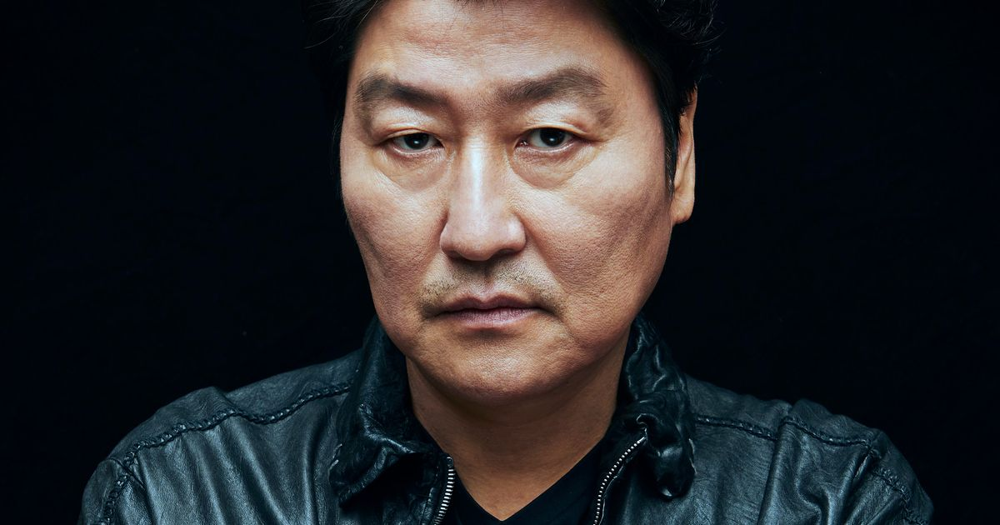

###Director of the exercise: **David Lynch**


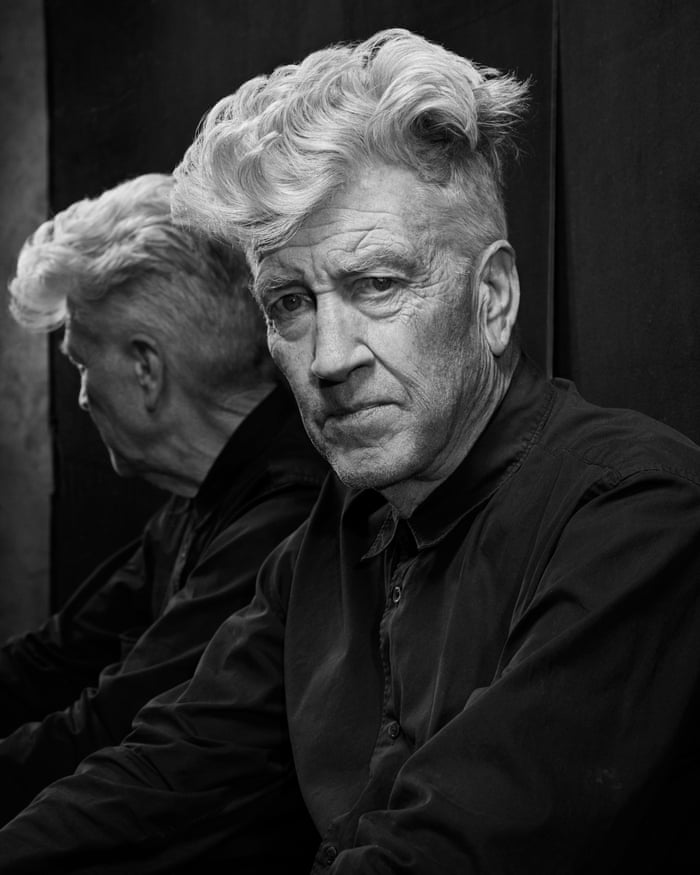

###Movie of the exercise: **The Usual Suspects**

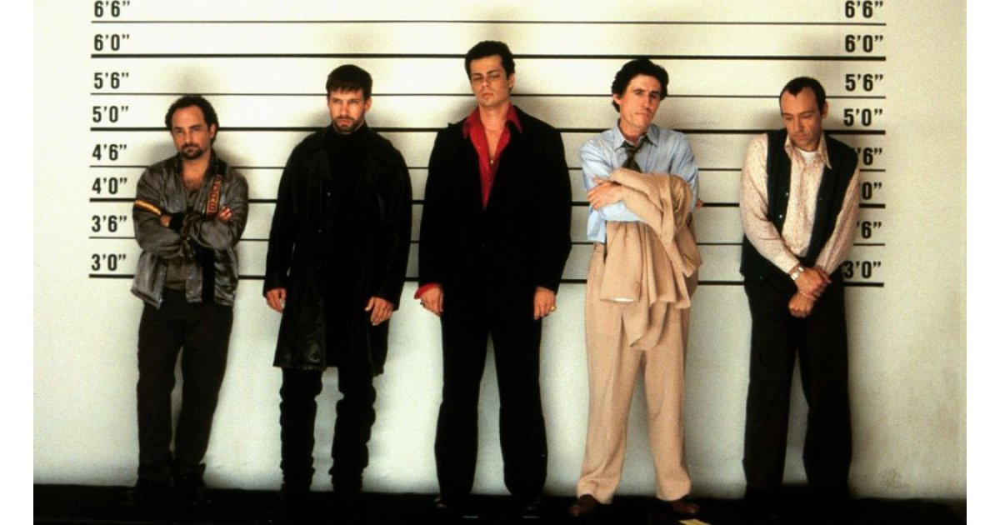

###Any suggestions by you, master?

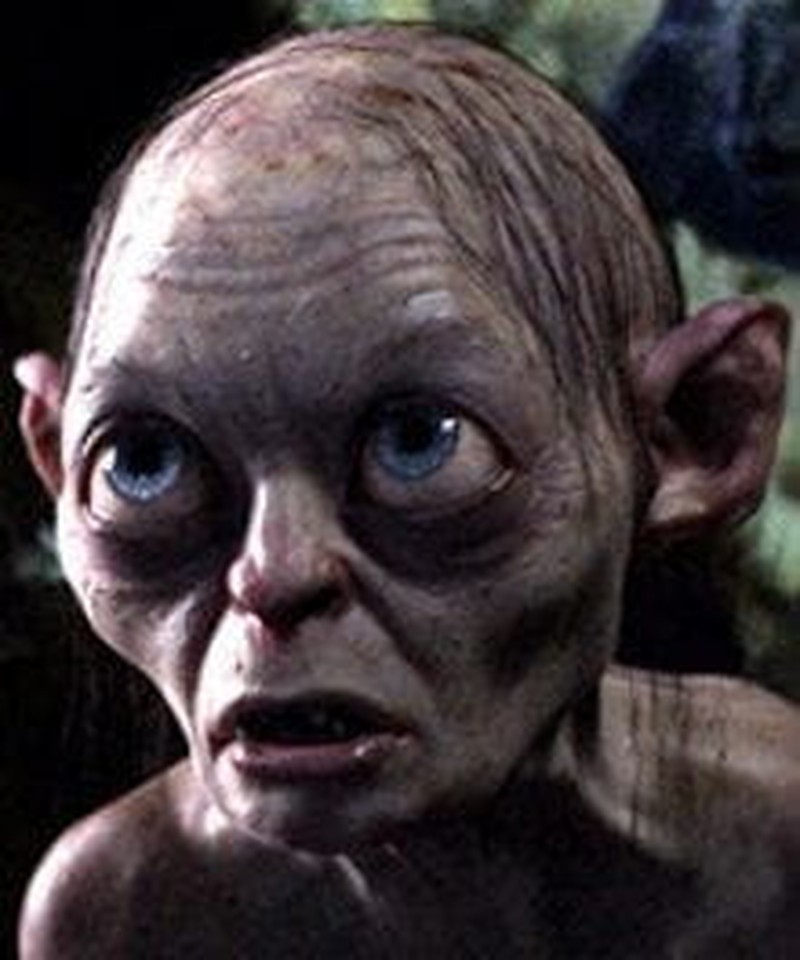